In [1]:
import pandas as pd 
import numpy as np
import lightgbm as lgb
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import seaborn as sns


In [2]:
bld = pd.read_csv('building_info.csv')
smp = pd.read_csv('sample_submission.csv')
test = pd.read_csv('test.csv')
train = pd.read_csv('train.csv')

In [3]:


# Rename columns
bld.rename(columns={
    "건물번호": "Building Number",
    "건물유형": "Building Type",
    "연면적(m2)": "Total Floor Area (m²)",
    "냉방면적(m2)": "Air-conditioned Area (m²)",
    "태양광용량(kW)": "Solar Power Capacity (kW)",
    "ESS저장용량(kWh)": "ESS Storage Capacity (kWh)",
    "PCS용량(kW)": "PCS Capacity (kW)"
}, inplace=True)
building_type_map = {
    '호텔': 'Hotel',
    '상용': 'Commercial',
    '병원': 'Hospital',
    '학교': 'School',
    '건물기타': 'Other Building',
    '아파트': 'Apartment',
    '연구소': 'Research Institute',
    '백화점': 'Department Store',
    'IDC(전화국)': 'IDC (Telecom Center)',
    '공공': 'Public Facility'
}

bld['Building Type'] = bld['Building Type'].replace(building_type_map)
test.rename(columns={
    
    "건물번호": "Building Number",
    "일시": "Datetime",
    "기온(°C)": "Temperature (°C)",
    "강수량(mm)": "Precipitation (mm)",
    "풍속(m/s)": "Wind Speed (m/s)",
    "습도(%)": "Humidity (%)"
}, inplace=True)

train.rename(columns={
    "건물번호": "Building Number",
    "일시": "Datetime",
    "기온(°C)": "Temperature (°C)",
    "강수량(mm)": "Precipitation (mm)",
    "풍속(m/s)": "Wind Speed (m/s)",
    "습도(%)": "Humidity (%)",
    "일조(hr)": "Sunshine Duration (hr)",
    "일사(MJ/m2)": "Solar Radiation (MJ/m²)",
    "전력소비량(kWh)": "Power Consumption (kWh)"
}, inplace=True)





In [4]:
train['Datetime'] = pd.to_datetime(train['Datetime'])
train['Hour'] = train['Datetime'].dt.hour
train['Day'] = train['Datetime'].dt.day


In [5]:
test['Datetime'] = pd.to_datetime(test['Datetime'])
test['Hour'] = test['Datetime'].dt.hour
test['Day'] = test['Datetime'].dt.day

In [6]:
train = train.merge(bld[['Building Number','Air-conditioned Area (m²)', 'Total Floor Area (m²)', 'Building Type', 'Solar Power Capacity (kW)', 'ESS Storage Capacity (kWh)', 'PCS Capacity (kW)']], on='Building Number', how='left')

In [7]:
train = train.replace('-', 0)
train.head()

,num_date_time,Building Number,Datetime,Temperature (°C),Precipitation (mm),Wind Speed (m/s),Humidity (%),Sunshine Duration (hr),Solar Radiation (MJ/m²),Power Consumption (kWh),Hour,Day,Air-conditioned Area (m²),Total Floor Area (m²),Building Type,Solar Power Capacity (kW),ESS Storage Capacity (kWh),PCS Capacity (kW)
0,1_20240601 00,1,2024-06-01 00:00:00,18.3,0.0,2.6,82.0,0.0,0.0,5794.80,0,1,77586.0,82912.71,Hotel,0,0,0
1,1_20240601 01,1,2024-06-01 01:00:00,18.3,0.0,2.7,82.0,0.0,0.0,5591.85,1,1,77586.0,82912.71,Hotel,0,0,0
2,1_20240601 02,1,2024-06-01 02:00:00,18.1,0.0,2.6,80.0,0.0,0.0,5338.17,2,1,77586.0,82912.71,Hotel,0,0,0
3,1_20240601 03,1,2024-06-01 03:00:00,18.0,0.0,2.6,81.0,0.0,0.0,4554.42,3,1,77586.0,82912.71,Hotel,0,0,0
4,1_20240601 04,1,2024-06-01 04:00:00,17.8,0.0,1.3,81.0,0.0,0.0,3602.25,4,1,77586.0,82912.71,Hotel,0,0,0


In [8]:
test = test.merge(bld[['Building Number','Air-conditioned Area (m²)', 'Total Floor Area (m²)', 'Building Type', 'Solar Power Capacity (kW)', 'ESS Storage Capacity (kWh)', 'PCS Capacity (kW)']], on='Building Number', how='left')
test = test.replace('-', 0)
test.head()

,num_date_time,Building Number,Datetime,Temperature (°C),Precipitation (mm),Wind Speed (m/s),Humidity (%),Hour,Day,Air-conditioned Area (m²),Total Floor Area (m²),Building Type,Solar Power Capacity (kW),ESS Storage Capacity (kWh),PCS Capacity (kW)
0,1_20240825 00,1,2024-08-25 00:00:00,26.5,0.0,0.7,80.0,0,25,77586.0,82912.71,Hotel,0,0,0
1,1_20240825 01,1,2024-08-25 01:00:00,26.1,0.0,0.0,80.0,1,25,77586.0,82912.71,Hotel,0,0,0
2,1_20240825 02,1,2024-08-25 02:00:00,25.9,0.0,0.3,83.0,2,25,77586.0,82912.71,Hotel,0,0,0
3,1_20240825 03,1,2024-08-25 03:00:00,25.7,0.0,1.1,83.0,3,25,77586.0,82912.71,Hotel,0,0,0
4,1_20240825 04,1,2024-08-25 04:00:00,25.5,0.0,1.0,86.0,4,25,77586.0,82912.71,Hotel,0,0,0


In [9]:
import pandas as pd
import numpy as np

def prepare_features(train_df, test_df):
    # Combine train + test for lag/rolling calculations
    train_df['is_train'] = 1
    test_df['is_train'] = 0
    full_df = pd.concat([train_df, test_df], ignore_index=True)

    # Ensure datetime is proper
    full_df['Datetime'] = pd.to_datetime(full_df['Datetime'])
    full_df['Hour'] = full_df['Datetime'].dt.hour
    
    # -------- Time-based features --------
    full_df['DayOfWeek'] = full_df['Datetime'].dt.weekday
    full_df['Day'] = full_df['Datetime'].dt.day
    full_df['Month'] = full_df['Datetime'].dt.month
    full_df['Week'] = full_df['Datetime'].dt.isocalendar().week.astype(int)
    full_df['is_weekend'] = (full_df['DayOfWeek'] >= 5).astype(int)

    # Cyclic encoding (Hour, DayOfWeek, Day, Month, Week)
    full_df['Hour_sin'] = np.sin(2 * np.pi * full_df['Hour']/24)
    full_df['Hour_cos'] = np.cos(2 * np.pi * full_df['Hour']/24)
    full_df['DayOfWeek_sin'] = np.sin(2 * np.pi * full_df['DayOfWeek']/7)
    full_df['DayOfWeek_cos'] = np.cos(2 * np.pi * full_df['DayOfWeek']/7)
    full_df['Day_sin'] = np.sin(2 * np.pi * full_df['Day']/31)
    full_df['Day_cos'] = np.cos(2 * np.pi * full_df['Day']/31)
    full_df['Month_sin'] = np.sin(2 * np.pi * full_df['Month']/12)
    full_df['Month_cos'] = np.cos(2 * np.pi * full_df['Month']/12)
    full_df['Week_sin'] = np.sin(2 * np.pi * full_df['Week']/52)
    full_df['Week_cos'] = np.cos(2 * np.pi * full_df['Week']/52)

    # -------- Time-of-day one-hot features --------
    def time_of_day(hour):
        if 0 <= hour < 6:
            return "Late_Night"
        elif 6 <= hour < 8:
            return "Early_Morning"
        elif 8 <= hour < 16:
            return "Daytime"
        elif 16 <= hour < 20:
            return "Evening"
        else:
            return "Night"

    full_df['TimeOfDay'] = full_df['Hour'].apply(time_of_day)
    full_df = pd.get_dummies(full_df, columns=['TimeOfDay'], prefix='is', dtype=int)

    # -------- Numeric conversions --------
    cols_to_convert = ['Solar Power Capacity (kW)', 'ESS Storage Capacity (kWh)', 'PCS Capacity (kW)',
                       'Precipitation (mm)', 'Temperature (°C)', 'Wind Speed (m/s)', 'Solar Radiation (MJ/m²)']
    for col in cols_to_convert:
        if col in full_df.columns:
            full_df[col] = pd.to_numeric(full_df[col].astype(str).str.strip(), errors='coerce').fillna(0)

    # -------- Derived weather categories --------
    full_df['is_rain_light'] = ((full_df['Precipitation (mm)'] > 0) & (full_df['Precipitation (mm)'] <= 2)).astype(int)
    full_df['is_rain_moderate'] = ((full_df['Precipitation (mm)'] > 2) & (full_df['Precipitation (mm)'] <= 10)).astype(int)
    full_df['is_rain_heavy'] = (full_df['Precipitation (mm)'] > 10).astype(int)
    full_df['is_cold'] = (full_df['Temperature (°C)'] < 10).astype(int)
    full_df['is_mild'] = ((full_df['Temperature (°C)'] >= 10) & (full_df['Temperature (°C)'] < 25)).astype(int)
    full_df['is_hot'] = (full_df['Temperature (°C)'] >= 25).astype(int)
    full_df['is_calm'] = (full_df['Wind Speed (m/s)'] < 1.5).astype(int)
    full_df['is_breezy'] = ((full_df['Wind Speed (m/s)'] >= 1.5) & (full_df['Wind Speed (m/s)'] < 5)).astype(int)
    full_df['is_windy'] = ((full_df['Wind Speed (m/s)'] >= 5) & (full_df['Wind Speed (m/s)'] < 10)).astype(int)
    full_df['is_stormy'] = (full_df['Wind Speed (m/s)'] >= 10).astype(int)
    full_df['is_low_rad'] = (full_df['Solar Radiation (MJ/m²)'] < 200).astype(int)
    full_df['is_medium_rad'] = ((full_df['Solar Radiation (MJ/m²)'] >= 200) & (full_df['Solar Radiation (MJ/m²)'] < 600)).astype(int)
    full_df['is_high_rad'] = (full_df['Solar Radiation (MJ/m²)'] >= 600).astype(int)

    # -------- Korean holiday encoding --------
    # -------- Korean holiday encoding --------
    korean_holidays = pd.to_datetime([
        "2024-06-06", # Memorial Day
        "2024-08-15"  # Liberation Day
    ])
    # Weekend = Saturday (5) or Sunday (6)
    is_weekend = (full_df['DayOfWeek'] >= 5).astype(int)

    # Merge weekend into holiday
    full_df["is_holiday"] = (
        full_df["Datetime"].dt.normalize().isin(korean_holidays) | (is_weekend == 1)
    ).astype(int)


    # -------- Interaction features --------
    full_df["Solar_Temp"] = full_df["Solar Power Capacity (kW)"] * full_df["Temperature (°C)"]
    full_df["Solar_Humidity"] = full_df["Solar Power Capacity (kW)"] * full_df["Humidity (%)"]
    full_df["Solar_Wind"] = full_df["Solar Power Capacity (kW)"] * full_df["Wind Speed (m/s)"]
    full_df["Temp_Humidity"] = full_df["Temperature (°C)"] * full_df["Humidity (%)"]

    # Time × Weather
    full_df["Temp_Hour_sin"] = full_df["Temperature (°C)"] * full_df["Hour_sin"]
    full_df["Temp_Day_sin"] = full_df["Temperature (°C)"] * full_df["DayOfWeek_sin"]
    full_df["Humidity_Hour_sin"] = full_df["Humidity (%)"] * full_df["Hour_sin"]

    # Holiday × Energy
    full_df["Holiday_Temp"] = full_df["is_holiday"] * full_df["Temperature (°C)"]
    full_df["Holiday_Solar"] = full_df["is_holiday"] * full_df["Solar Power Capacity (kW)"]
    full_df["Holiday_Hour"] = full_df["is_holiday"] * full_df["Hour_sin"]

    # Nonlinear features
    full_df["Temp2"] = full_df["Temperature (°C)"] ** 2
    full_df["Humidity2"] = full_df["Humidity (%)"] ** 2
    full_df["Solar2"] = full_df["Solar Power Capacity (kW)"] ** 2

    # -------- NEW MOVING AVERAGE FEATURE --------
    full_df["Power_MA_3"] = full_df.groupby("Building Number")["Power Consumption (kWh)"] \
    .transform(lambda x: (x.shift(1).fillna(method="bfill") + x + x.shift(-1).fillna(method="ffill")) / 3)


    # -------- Lag & Rolling features --------
    # windows = [24, 72, 168]
    # for w in windows:
    #     full_df[f'RollingMean_{w}h'] = (
    #         full_df.groupby('Building Number')['Power Consumption (kWh)']
    #         .shift(1)
    #         .rolling(w)
    #         .mean()
    #         .reset_index(level=0, drop=True)
    #     )
    #     full_df[f'RollingStd_{w}h'] = (
    #         full_df.groupby('Building Number')['Power Consumption (kWh)']
    #         .shift(1)
    #         .rolling(w)
    #         .std()
    #         .reset_index(level=0, drop=True)
    #     )
    #     full_df[f'RollingMedian_{w}h'] = (
    #         full_df.groupby('Building Number')['Power Consumption (kWh)']
    #         .shift(1)
    #         .rolling(w)
    #         .median()
    #         .reset_index(level=0, drop=True)
    #     )

    # # EWMA
    # full_df['EWMA_24h'] = (
    #     full_df.groupby('Building Number')['Power Consumption (kWh)']
    #     .shift(1)
    #     .ewm(span=24, adjust=False)
    #     .mean()
    # )

    # -------- Split back into train/test --------
    train_processed = full_df[full_df['is_train'] == 1].drop(columns=['is_train'])
    test_processed = full_df[full_df['is_train'] == 0].drop(columns=['is_train', 'Power Consumption (kWh)'], errors='ignore')

    return train_processed, test_processed
train, test = prepare_features(train, test)

C:\Users\Dell\AppData\Local\Temp\ipykernel_21492\2218913669.py:109: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  .transform(lambda x: (x.shift(1).fillna(method="bfill") + x + x.shift(-1).fillna(method="ffill")) / 3)


In [31]:
import pandas as pd

# List of outlier building numbers per type
outliers = {
    "Other Building": [7, 26, 61, 97],
    "Hotel": [10, 100, 77, 1, 9, 98],
    "Commercial": [6],
    "School": [8, 46, 87],
    "Apartment": [85, 25],
    "Research Institute": [49, 94, 23],
    "Department Store": [29, 63, 59, 27, 32, 19, 95, 54],
    "Public Facility": [68, 33]
}

# Combine all outlier building numbers into a single list
all_outliers = []
for blist in outliers.values():
    all_outliers.extend(blist)

# Remove outliers from the train dataset
train = train[~train['Building Number'].isin(all_outliers)].copy()

print(f"Original dataset rows: {len(train)}")


Original dataset rows: 144840


Building # 7


Top correlations with Power Consumption:
Power Consumption (kWh)       1.000000
Power_MA_3                    0.997777
Week_cos                      0.281121
Month_cos                     0.193294
Day_sin                       0.144124
is_calm                       0.130350
is_mild                       0.126695
Temp_Day_sin                  0.122013
Humidity_Hour_sin             0.111765
DayOfWeek_sin                 0.108595
Hour_sin                      0.096979
Temp_Hour_sin                 0.087503
Sunshine Duration (hr)        0.084297
is_Late_Night                 0.082240
Holiday_Hour                  0.055451
Solar Radiation (MJ/m²)       0.046335
Week_sin                      0.043266
is_Early_Morning              0.038961
Month_sin                     0.022608
Hour_cos                      0.001788
Week                         -0.002589
is_Daytime                   -0.004461
is_Evening                   -0.039850
is_windy                     -0.044753
Temp2                 

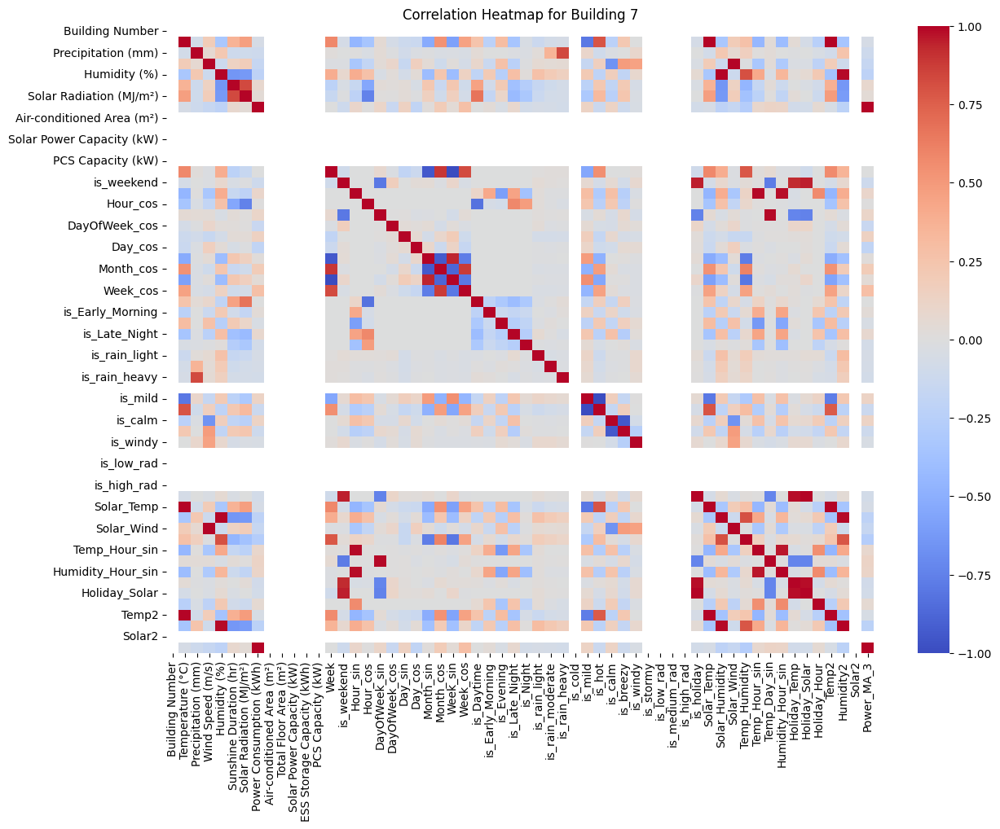

In [10]:
import matplotlib.pyplot as plt
import seaborn as sns
building_number = 7
# Filtered dataset for the selected building
bld_train = train[train['Building Number'] == building_number]

# Select only numeric columns for correlation
numeric_cols = bld_train.select_dtypes(include=['float64', 'int64'])

# Compute correlation matrix
corr_matrix = numeric_cols.corr()

# Display top correlations with the target variable
target_corr = corr_matrix['Power Consumption (kWh)'].sort_values(ascending=False)
print("\nTop correlations with Power Consumption:")
print(target_corr)

# === Heatmap Visualization ===
plt.figure(figsize=(14, 10))
sns.heatmap(corr_matrix, annot=False, cmap="coolwarm", center=0)
plt.title(f"Correlation Heatmap for Building {building_number}")
plt.show()


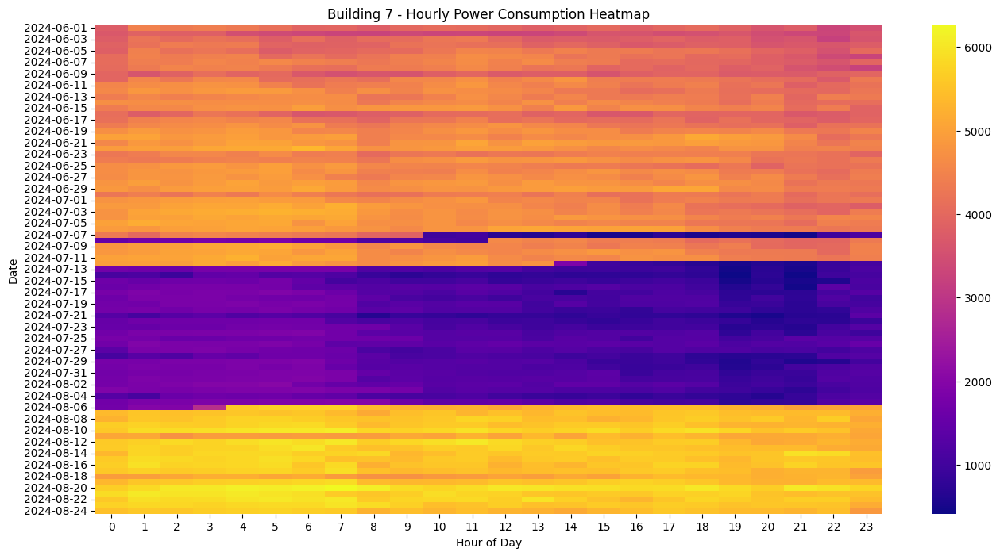

In [15]:
import seaborn as sns
import matplotlib.pyplot as plt

pivot_df = building_7.pivot_table(
    index=building_7["Datetime"].dt.date,
    columns="Hour",
    values="Power Consumption (kWh)",
    aggfunc="mean"
)

plt.figure(figsize=(16, 8))
sns.heatmap(pivot_df, cmap="plasma")
plt.title("Building 7 - Hourly Power Consumption Heatmap")
plt.xlabel("Hour of Day")
plt.ylabel("Date")
plt.show()


In [16]:
bld_train_7 = train[train['Building Number'] == 7]
bld_train_7['is_low_period'] = ((bld_train_7['Datetime'] >= '2024-07-13') & 
                            (bld_train_7['Datetime'] <= '2024-08-06')).astype(int)
bld_train_7['is_medium_period'] = (bld_train_7['Datetime'] < '2024-07-13').astype(int)
bld_train_7['is_high_period'] = (bld_train_7['Datetime'] > '2024-08-06').astype(int)

C:\Users\Dell\AppData\Local\Temp\ipykernel_21492\70078393.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  bld_train_7['is_low_period'] = ((bld_train_7['Datetime'] >= '2024-07-13') &
C:\Users\Dell\AppData\Local\Temp\ipykernel_21492\70078393.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  bld_train_7['is_medium_period'] = (bld_train_7['Datetime'] < '2024-07-13').astype(int)
C:\Users\Dell\AppData\Local\Temp\ipykernel_21492\70078393.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of

C:\Users\Dell\AppData\Local\Temp\ipykernel_21492\4105832046.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  bld_train_7['lag_1h'] = bld_train_7['Power Consumption (kWh)'].shift(1)
C:\Users\Dell\AppData\Local\Temp\ipykernel_21492\4105832046.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  bld_train_7['roll_24h'] = bld_train_7['Power Consumption (kWh)'].shift(1).rolling(24).mean()


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000244 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2364
[LightGBM] [Info] Number of data points in the train set: 1836, number of used features: 29
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 3516.789861
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

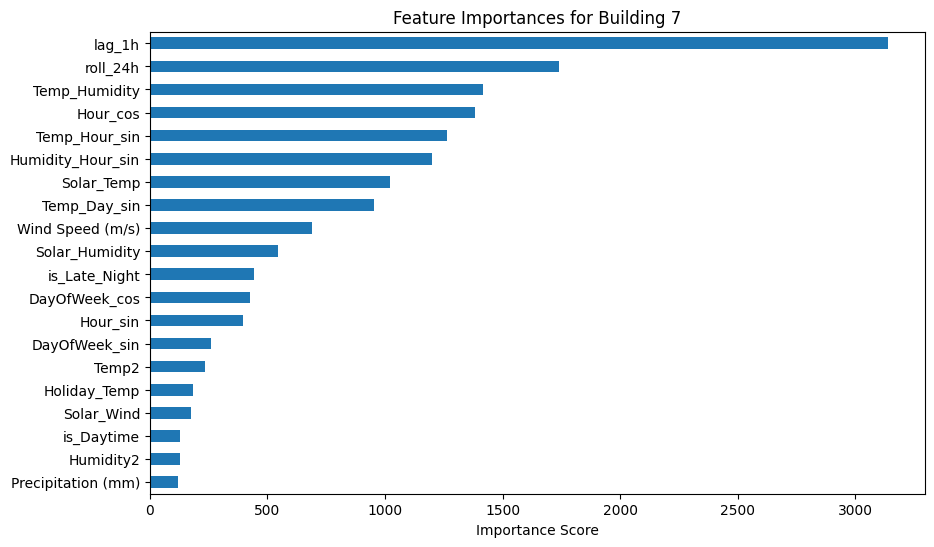

In [20]:
import numpy as np
import pandas as pd
import lightgbm as lgb
import matplotlib.pyplot as plt
from sklearn.metrics import mean_absolute_percentage_error

# --- SMAPE Function ---
def smape(y_true, y_pred):
    numerator = np.abs(y_pred - y_true)
    denominator = (np.abs(y_true) + np.abs(y_pred)) / 2
    return np.mean(numerator / denominator) * 100

# === Choose one building ===
building_number = 7  # <-- Change this to your building number

# Filter data for this building

# --- Add lag and rolling features ---
bld_train_7['lag_1h'] = bld_train_7['Power Consumption (kWh)'].shift(1)
bld_train_7['roll_24h'] = bld_train_7['Power Consumption (kWh)'].shift(1).rolling(24).mean()



# === Features & Target ===
features = [
    'Total Floor Area (m²)', 'Air-conditioned Area (m²)', 
    'Wind Speed (m/s)', 'is_Daytime', 'is_Early_Morning', 'is_Late_Night',
    'is_Night', 'is_Evening',
    'Precipitation (mm)', 'ESS Storage Capacity (kWh)', 'Solar Power Capacity (kW)',
    'DayOfWeek_sin', 'DayOfWeek_cos', 'is_holiday', 'Solar_Temp', 
    'Solar_Humidity', 'Solar_Wind', 'Temp_Humidity', 'Temp_Hour_sin', 
    'Temp_Day_sin', 'Humidity_Hour_sin', 'Holiday_Temp', 'Holiday_Solar', 
    'Holiday_Hour', 'Temp2', 'Humidity2', 'Hour_sin', 'Hour_cos', 
    'is_low_period', 'is_medium_period', 'is_high_period',
    'lag_1h', 'roll_24h'  # <-- Added lag & rolling features
]

# Drop rows with NaN due to lag/rolling
X = bld_train_7[features]
y = bld_train_7.loc[X.index, 'Power Consumption (kWh)']

# === Train-test split (time series) ===
split_index = int(len(X) * 0.9)
X_train, X_val = X.iloc[:split_index], X.iloc[split_index:]
y_train, y_val = y.iloc[:split_index], y.iloc[split_index:]

# === LightGBM Model ===
model = lgb.LGBMRegressor(
    boosting_type='gbdt',
    n_estimators=600,
    learning_rate=0.01,
    num_leaves=31,
    max_depth=-1,
    min_child_samples=50,
    subsample=0.8,
    colsample_bytree=0.8,
    reg_alpha=0.1,
    reg_lambda=0.1,
    random_state=42
)

# Train model
model.fit(X_train, y_train, eval_set=[(X_val, y_val)])

# === Predictions ===
y_pred = model.predict(X_val)

# === Metrics ===
building_smape = smape(y_val.values, y_pred)
building_mape = mean_absolute_percentage_error(y_val, y_pred) * 100

print(f"Building Number: {building_number}")
print(f"SMAPE: {building_smape:.2f}%")
print(f"MAPE: {building_mape:.2f}%")

# === Feature Importances ===
feat_importances = pd.Series(model.feature_importances_, index=features)
plt.figure(figsize=(10, 6))
feat_importances.nlargest(20).sort_values().plot(kind='barh')
plt.title(f'Feature Importances for Building {building_number}')
plt.xlabel('Importance Score')
plt.show()


In [18]:
# --- Filter test data for Building 7 ---
bld_test_7 = test[test['Building Number'] == building_number].copy()

# --- Add period flags to match training ---
bld_test_7['is_low_period'] = ((bld_test_7['Datetime'] >= '2024-07-13') & 
                               (bld_test_7['Datetime'] <= '2024-08-06')).astype(int)
bld_test_7['is_medium_period'] = (bld_test_7['Datetime'] < '2024-07-13').astype(int)
bld_test_7['is_high_period'] = (bld_test_7['Datetime'] > '2024-08-06').astype(int)

# --- Prepare features (must match training features) ---
features = [
    'Total Floor Area (m²)', 'Air-conditioned Area (m²)', 
    'Wind Speed (m/s)', 'is_Daytime', 'is_Early_Morning', 'is_Late_Night',
    'is_Night', 'is_Evening',
    'Precipitation (mm)', 'ESS Storage Capacity (kWh)', 'Solar Power Capacity (kW)',
    'DayOfWeek_sin', 'DayOfWeek_cos', 'is_holiday', 'Solar_Temp', 
    'Solar_Humidity', 'Solar_Wind', 'Temp_Humidity', 'Temp_Hour_sin', 
    'Temp_Day_sin', 'Humidity_Hour_sin', 'Holiday_Temp', 'Holiday_Solar', 
    'Holiday_Hour', 'Temp2', 'Humidity2', 'Hour_sin', 'Hour_cos', 
    'is_low_period', 'is_medium_period', 'is_high_period'
]

X_future = bld_test_7[features] # fill NaNs if needed

# --- Predict ---
bld_test_7['Predicted Power Consumption (kWh)'] = model.predict(X_future)

# --- Save predictions ---
bld_test_7.to_csv("building_7_predictions.csv", index=False)

# --- Optional: read and check ---
df_new_bld7 = pd.read_csv("building_7_predictions.csv")
df_new_bld7.head()


,num_date_time,Building Number,Datetime,Temperature (°C),Precipitation (mm),Wind Speed (m/s),Humidity (%),Sunshine Duration (hr),Solar Radiation (MJ/m²),Hour,...,Holiday_Solar,Holiday_Hour,Temp2,Humidity2,Solar2,Power_MA_3,is_low_period,is_medium_period,is_high_period,Predicted Power Consumption (kWh)
0,7_20240825 00,7,2024-08-25 00:00:00,26.5,0.0,0.7,80.0,NaN,0.0,0,...,389.76,0.000000,702.25,6400.0,151912.8576,NaN,0,0,1,4814.918878
1,7_20240825 01,7,2024-08-25 01:00:00,26.1,0.0,0.0,80.0,NaN,0.0,1,...,389.76,0.258819,681.21,6400.0,151912.8576,NaN,0,0,1,4811.019804
2,7_20240825 02,7,2024-08-25 02:00:00,25.9,0.0,0.3,83.0,NaN,0.0,2,...,389.76,0.500000,670.81,6889.0,151912.8576,NaN,0,0,1,4894.954162
3,7_20240825 03,7,2024-08-25 03:00:00,25.7,0.0,1.1,83.0,NaN,0.0,3,...,389.76,0.707107,660.49,6889.0,151912.8576,NaN,0,0,1,5063.495499
4,7_20240825 04,7,2024-08-25 04:00:00,25.5,0.0,1.0,86.0,NaN,0.0,4,...,389.76,0.866025,650.25,7396.0,151912.8576,NaN,0,0,1,5278.091763


In [21]:
# --- Filter test data for Building 7 ---
bld_test_7 = test[test['Building Number'] == building_number].copy()

# --- Add period flags ---
bld_test_7['is_low_period'] = ((bld_test_7['Datetime'] >= '2024-07-13') & 
                               (bld_test_7['Datetime'] <= '2024-08-06')).astype(int)
bld_test_7['is_medium_period'] = (bld_test_7['Datetime'] < '2024-07-13').astype(int)
bld_test_7['is_high_period'] = (bld_test_7['Datetime'] > '2024-08-06').astype(int)

# --- Initialize lag features for test ---
last_train_value = bld_train_7['Power Consumption (kWh)'].iloc[-1]
# 1-hour lag
bld_test_7['lag_1h'] = np.nan
bld_test_7.loc[bld_test_7.index[0], 'lag_1h'] = last_train_value
# 24-hour same-hour lag
# If test starts exactly one day after training, we can take last 24h from training
if len(bld_train_7) >= 24:
    bld_test_7['lag_24h_same_hour'] = np.nan
    for i in range(len(bld_test_7)):
        if i < 24:
            # Use the last 24h of training for the first 24 predictions
            bld_test_7.loc[bld_test_7.index[i], 'lag_24h_same_hour'] = bld_train_7['Power Consumption (kWh)'].iloc[-24 + i]
else:
    bld_test_7['lag_24h_same_hour'] = np.nan

# --- Autoregressive Prediction ---
preds = []

for i in range(len(bld_test_7)):
    # Prepare features for current row
    row_features = bld_test_7.loc[bld_test_7.index[i], [
        'Total Floor Area (m²)', 'Air-conditioned Area (m²)', 
        'Wind Speed (m/s)', 'is_Daytime', 'is_Early_Morning', 'is_Late_Night',
        'is_Night', 'is_Evening',
        'Precipitation (mm)', 'ESS Storage Capacity (kWh)', 'Solar Power Capacity (kW)',
        'DayOfWeek_sin', 'DayOfWeek_cos', 'is_holiday', 'Solar_Temp', 
        'Solar_Humidity', 'Solar_Wind', 'Temp_Humidity', 'Temp_Hour_sin', 
        'Temp_Day_sin', 'Humidity_Hour_sin', 'Holiday_Temp', 'Holiday_Solar', 
        'Holiday_Hour', 'Temp2', 'Humidity2', 'Hour_sin', 'Hour_cos', 
        'is_low_period', 'is_medium_period', 'is_high_period',
        'lag_1h', 'lag_24h_same_hour'
    ]].values.reshape(1, -1)
    
    # Predict
    pred = model.predict(row_features)[0]
    preds.append(pred)
    
    # Update lag_1h for next row
    if i < len(bld_test_7) - 1:
        bld_test_7.loc[bld_test_7.index[i+1], 'lag_1h'] = pred
        
    # Update lag_24h_same_hour for next day prediction
    if i + 24 < len(bld_test_7):
        bld_test_7.loc[bld_test_7.index[i + 24], 'lag_24h_same_hour'] = pred

# --- Save predictions ---
bld_test_7['Predicted Power Consumption (kWh)'] = preds
bld_test_7.to_csv("building_7_predictions.csv", index=False)

print("Predictions saved for Building 7 ✅")


c:\Users\Dell\Downloads\open\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
c:\Users\Dell\Downloads\open\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
c:\Users\Dell\Downloads\open\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
c:\Users\Dell\Downloads\open\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
c:\Users\Dell\Downloads\open\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warni

Predictions saved for Building 7 ✅


c:\Users\Dell\Downloads\open\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
c:\Users\Dell\Downloads\open\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
c:\Users\Dell\Downloads\open\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
c:\Users\Dell\Downloads\open\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
c:\Users\Dell\Downloads\open\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warni

In [24]:
# === Extra models: XGBoost, RandomForest, CatBoost ===
import xgboost as xgb
from sklearn.ensemble import RandomForestRegressor
from catboost import CatBoostRegressor

def smape(y_true, y_pred):
    numerator = np.abs(y_pred - y_true)
    denominator = (np.abs(y_true) + np.abs(y_pred)) / 2
    return np.mean(numerator / denominator) * 100

def eval_and_print(name, y_true, y_pred):
    mape = mean_absolute_percentage_error(y_true, y_pred) * 100
    s = smape(y_true, y_pred)
    print(f"\n{name}")
    print(f"SMAPE: {s:.2f}%")
    print(f"MAPE : {mape:.2f}%")
    return s, mape

# --- XGBoost ---
xgb_model = xgb.XGBRegressor(
    objective='reg:squarederror',
    n_estimators=500,
    learning_rate=0.08,
    max_depth=6,
    min_child_weight=30,
    subsample=0.9,
    colsample_bytree=0.9,
    reg_alpha=6.7,
    reg_lambda=6.0,
    tree_method='hist',
    random_state=42,
    n_jobs=-1
)
xgb_model.fit(X_train, y_train, eval_set=[(X_val, y_val)], verbose=False)
xgb_pred = xgb_model.predict(X_val)
eval_and_print("XGBoost", y_val, xgb_pred)

# --- Random Forest ---
rf_model = RandomForestRegressor(
    n_estimators=600,
    max_depth=None,
    min_samples_split=2,
    min_samples_leaf=1,
    max_features='sqrt',
    n_jobs=-1,
    random_state=42
)
rf_model.fit(X_train, y_train)
rf_pred = rf_model.predict(X_val)
eval_and_print("Random Forest", y_val, rf_pred)

# --- CatBoost ---
# (CatBoost handles missing values natively; keeps evals quiet with verbose=0)
cb_model = CatBoostRegressor(
    iterations=1000,
    learning_rate=0.05,
    depth=8,
    l2_leaf_reg=6.0,
    loss_function='RMSE',
    random_seed=42,
    verbose=0
)
cb_model.fit(X_train, y_train, eval_set=(X_val, y_val), use_best_model=True)
cb_pred = cb_model.predict(X_val)
eval_and_print("CatBoost", y_val, cb_pred)



XGBoost
SMAPE: 5.61%
MAPE : 5.47%

Random Forest
SMAPE: 7.38%
MAPE : 7.00%

CatBoost
SMAPE: 5.78%
MAPE : 5.58%


(np.float64(5.7823702216320605), 5.581868386479998)

# Building # 26



Top correlations with Power Consumption:
Power Consumption (kWh)       1.000000
Power_MA_3                    0.996638
Solar Radiation (MJ/m²)       0.727667
is_Daytime                    0.673220
Sunshine Duration (hr)        0.554934
Temp2                         0.525452
Solar_Temp                    0.513045
Temperature (°C)              0.513045
is_hot                        0.350255
Wind Speed (m/s)              0.248632
Solar_Wind                    0.248632
is_windy                      0.213224
is_Evening                    0.201913
Week                          0.183255
Temp_Humidity                 0.157062
Holiday_Temp                  0.154950
Month_cos                     0.134973
is_weekend                    0.115404
Holiday_Solar                 0.102215
is_holiday                    0.102215
Week_cos                      0.096657
Day_cos                       0.045292
is_rain_moderate              0.027201
Precipitation (mm)           -0.018629
is_stormy             

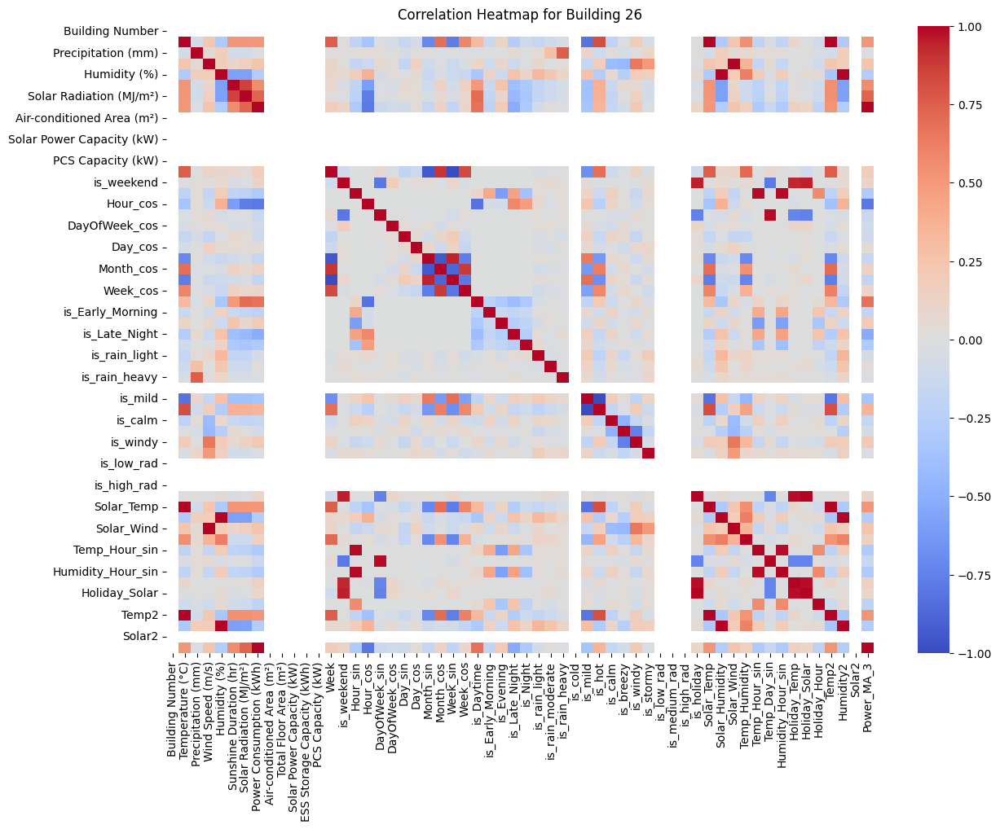

In [118]:
import matplotlib.pyplot as plt
import seaborn as sns
building_number = 26
# Filtered dataset for the selected building
bld_train = train[train['Building Number'] == building_number]

# Select only numeric columns for correlation
numeric_cols = bld_train.select_dtypes(include=['float64', 'int64'])

# Compute correlation matrix
corr_matrix = numeric_cols.corr()

# Display top correlations with the target variable
target_corr = corr_matrix['Power Consumption (kWh)'].sort_values(ascending=False)
print("\nTop correlations with Power Consumption:")
print(target_corr)

# === Heatmap Visualization ===
plt.figure(figsize=(14, 10))
sns.heatmap(corr_matrix, annot=False, cmap="coolwarm", center=0)
plt.title(f"Correlation Heatmap for Building {building_number}")
plt.show()


In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

# Filter data for Building 1
building_1 = train[train["Building Number"] == building_number].copy()

# Convert to datetime properly (VERY important)
building_1["Datetime"] = pd.to_datetime(building_1["Datetime"], errors="coerce")

# Sort by datetime
building_1 = building_1.sort_values("Datetime")

# Extract date (YYYY-MM-DD) from datetime
building_1["Date"] = building_1["Datetime"].dt.date

# Get unique sorted dates
unique_dates = sorted(building_1["Date"].unique())

# Generate separate plots for each day
for date in unique_dates:
    day_data = building_1[building_1["Date"] == date]
    plt.figure(figsize=(10, 4))
    plt.plot(day_data["Datetime"], day_data["Power Consumption (kWh)"], marker="o", linewidth=1)
    plt.title(f"Building 1 - Power Consumption on {date}")
    plt.xlabel("Hour")
    plt.ylabel("Power Consumption (kWh)")
    plt.xticks(rotation=45)
    plt.grid(True)
    plt.tight_layout()
    plt.show()

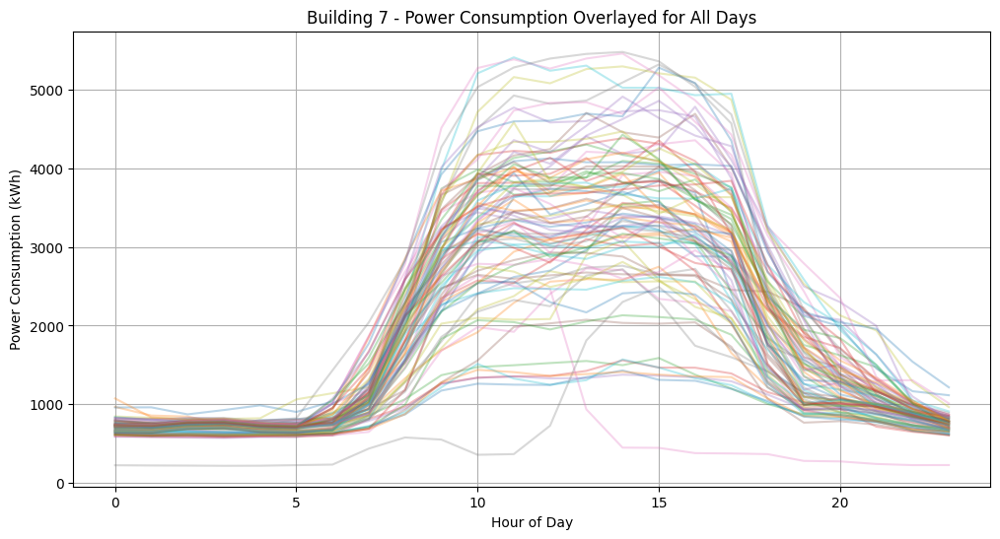

In [120]:
import matplotlib.pyplot as plt

building_26 = train[train["Building Number"] == building_number].copy()
building_26["Datetime"] = pd.to_datetime(building_26["Datetime"])
building_26["Hour"] = building_26["Datetime"].dt.hour
building_26["Date"] = building_26["Datetime"].dt.date

plt.figure(figsize=(12, 6))
for date in building_26["Date"].unique():
    day_data = building_26[building_26["Date"] == date]
    plt.plot(day_data["Hour"], day_data["Power Consumption (kWh)"], alpha=0.3)

plt.title("Building 7 - Power Consumption Overlayed for All Days")
plt.xlabel("Hour of Day")
plt.ylabel("Power Consumption (kWh)")
plt.grid(True)
plt.show()


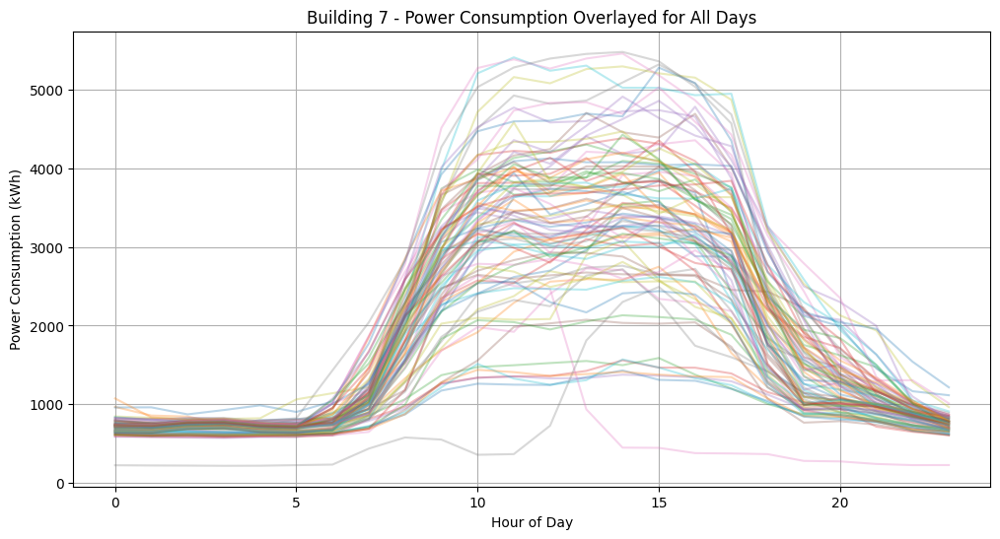

In [121]:
import matplotlib.pyplot as plt

building_26 = train[train["Building Number"] == 26].copy()
building_26["Datetime"] = pd.to_datetime(building_26["Datetime"])
building_26["Hour"] = building_26["Datetime"].dt.hour
building_26["Date"] = building_26["Datetime"].dt.date

plt.figure(figsize=(12, 6))
for date in building_26["Date"].unique():
    day_data = building_26[building_26["Date"] == date]
    plt.plot(day_data["Hour"], day_data["Power Consumption (kWh)"], alpha=0.3)

plt.title("Building 7 - Power Consumption Overlayed for All Days")
plt.xlabel("Hour of Day")
plt.ylabel("Power Consumption (kWh)")
plt.grid(True)
plt.show()


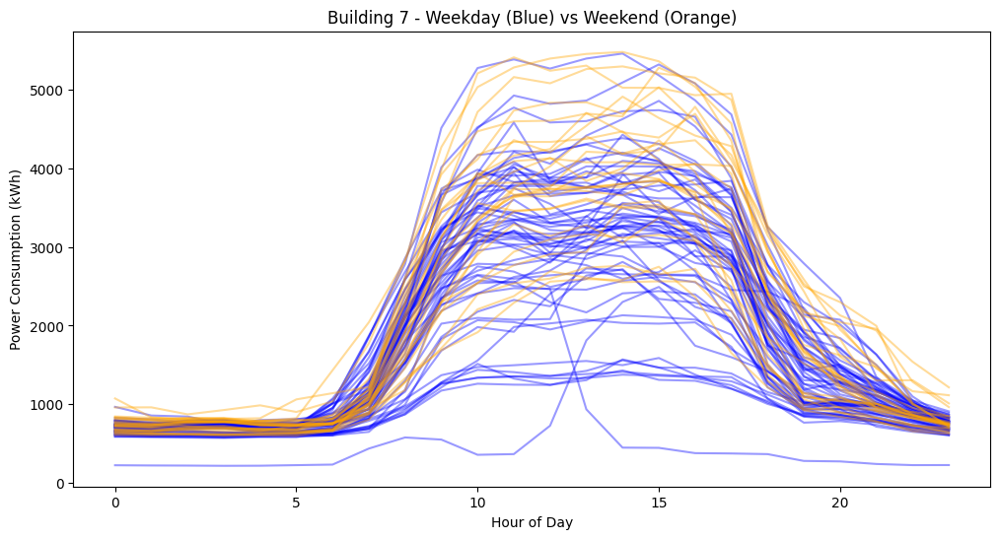

In [122]:
import matplotlib.pyplot as plt

building_26 = train[train["Building Number"] == 26].copy()
building_26["Datetime"] = pd.to_datetime(building_26["Datetime"])
building_26["DayOfWeek"] = building_26["Datetime"].dt.dayofweek
building_26["is_weekend"] = building_26["DayOfWeek"] >= 5

plt.figure(figsize=(12, 6))
for day in building_26[~building_26["is_weekend"]]["Datetime"].dt.date.unique():
    daily = building_26[building_26["Datetime"].dt.date == day]
    plt.plot(daily["Hour"], daily["Power Consumption (kWh)"], alpha=0.4, color="blue")
for day in building_26[building_26["is_weekend"]]["Datetime"].dt.date.unique():
    daily = building_26[building_26["Datetime"].dt.date == day]
    plt.plot(daily["Hour"], daily["Power Consumption (kWh)"], alpha=0.4, color="orange")

plt.title("Building 7 - Weekday (Blue) vs Weekend (Orange)")
plt.xlabel("Hour of Day")
plt.ylabel("Power Consumption (kWh)")
plt.show()


In [123]:
import numpy as np

building_26_daily = building_26.groupby(building_26["Datetime"].dt.date)["Power Consumption (kWh)"].mean()
threshold_high = building_26_daily.mean() + 2 * building_26_daily.std()
threshold_low = building_26_daily.mean() - 2 * building_26_daily.std()

outlier_days = building_26_daily[(building_26_daily > threshold_high) | (building_26_daily < threshold_low)]
print("Outlier Days:", outlier_days.index)

Outlier Days: Index([2024-06-17, 2024-06-18, 2024-08-16], dtype='object', name='Datetime')


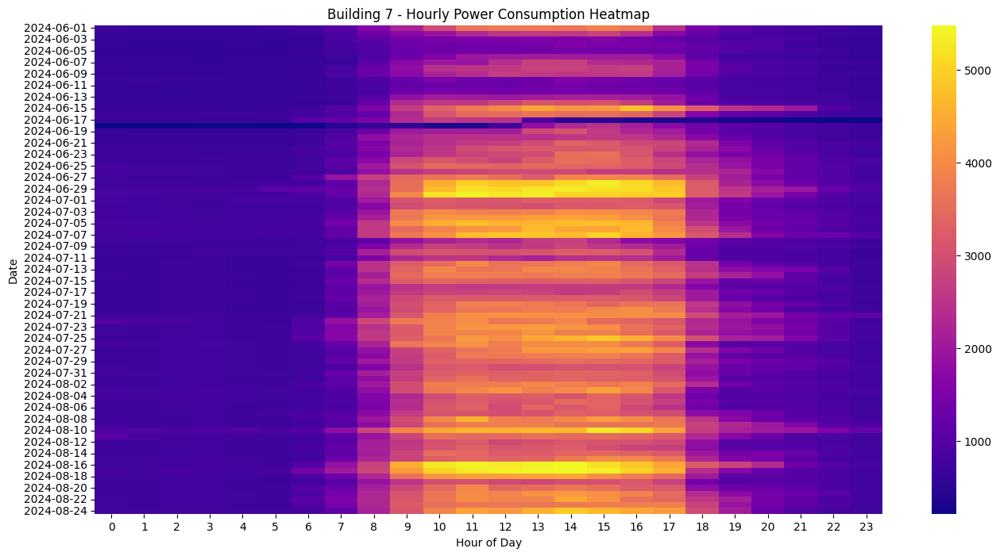

In [124]:
import seaborn as sns
import matplotlib.pyplot as plt

pivot_df = building_26.pivot_table(
    index=building_26["Datetime"].dt.date,
    columns="Hour",
    values="Power Consumption (kWh)",
    aggfunc="mean"
)

plt.figure(figsize=(16, 8))
sns.heatmap(pivot_df, cmap="plasma")
plt.title("Building 7 - Hourly Power Consumption Heatmap")
plt.xlabel("Hour of Day")
plt.ylabel("Date")
plt.show()

In [125]:
train.columns

Index(['num_date_time', 'Building Number', 'Datetime', 'Temperature (°C)',
       'Precipitation (mm)', 'Wind Speed (m/s)', 'Humidity (%)',
       'Sunshine Duration (hr)', 'Solar Radiation (MJ/m²)',
       'Power Consumption (kWh)', 'Hour', 'Day', 'Air-conditioned Area (m²)',
       'Total Floor Area (m²)', 'Building Type', 'Solar Power Capacity (kW)',
       'ESS Storage Capacity (kWh)', 'PCS Capacity (kW)', 'DayOfWeek', 'Month',
       'Week', 'is_weekend', 'Hour_sin', 'Hour_cos', 'DayOfWeek_sin',
       'DayOfWeek_cos', 'Day_sin', 'Day_cos', 'Month_sin', 'Month_cos',
       'Week_sin', 'Week_cos', 'is_Daytime', 'is_Early_Morning', 'is_Evening',
       'is_Late_Night', 'is_Night', 'is_rain_light', 'is_rain_moderate',
       'is_rain_heavy', 'is_cold', 'is_mild', 'is_hot', 'is_calm', 'is_breezy',
       'is_windy', 'is_stormy', 'is_low_rad', 'is_medium_rad', 'is_high_rad',
       'is_holiday', 'Solar_Temp', 'Solar_Humidity', 'Solar_Wind',
       'Temp_Humidity', 'Temp_Hour_sin', 'Tem

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000167 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1933
[LightGBM] [Info] Number of data points in the train set: 1836, number of used features: 19
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 1802.697985
Building Number: 26
SMAPE: 7.23%
MAPE: 7.38%


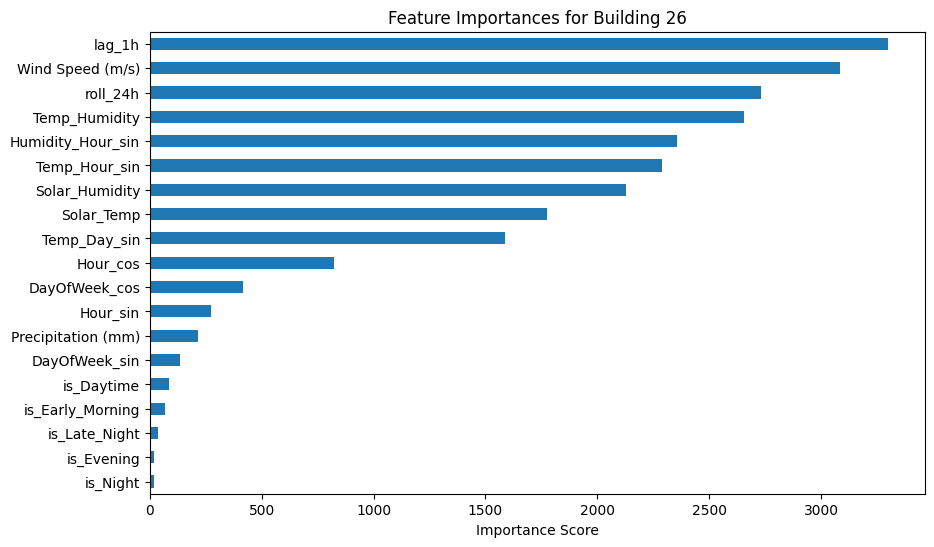

In [27]:
import numpy as np
import pandas as pd
import lightgbm as lgb
import matplotlib.pyplot as plt
from sklearn.metrics import mean_absolute_percentage_error
from sklearn.model_selection import train_test_split

# --- SMAPE Function ---
def smape(y_true, y_pred):
    numerator = np.abs(y_pred - y_true)
    denominator = (np.abs(y_true) + np.abs(y_pred)) / 2
    return np.mean(numerator / denominator) * 100

# === Choose one building ===
building_number = 26  # <-- Change this to your building number

# Filter data for this building
bld_train_26 = train[train['Building Number'] == building_number].copy()

bld_train_26['is_peak_hours'] = ((bld_train_26['Hour'] >= 5) & (bld_train_26['Hour'] < 17)).astype(int)
bld_train_26['lag_1h'] = bld_train_26['Power Consumption (kWh)'].shift(1)
bld_train_26['roll_3h'] = bld_train_26['Power Consumption (kWh)'].shift(1).rolling(3).mean()
bld_train_26['roll_6h'] = bld_train_26['Power Consumption (kWh)'].shift(1).rolling(6).mean()
bld_train_26['roll_24h'] = bld_train_26['Power Consumption (kWh)'].shift(1).rolling(24).mean()

exception_dates = pd.to_datetime(['2024-06-17', '2024-06-18', '2024-06-19'])
bld_train_26['exceptions'] = bld_train_26['Datetime'].isin(exception_dates).astype(int)

features = [
    'is_Daytime', 'is_Late_Night',
    'is_Early_Morning', 'is_Night', 'is_Evening',
    'Wind Speed (m/s)', 
    'Precipitation (mm)',
    'DayOfWeek_sin', 'DayOfWeek_cos','Solar_Temp', 
    'Solar_Humidity', 'Temp_Humidity', 'Temp_Hour_sin', 
    'Temp_Day_sin', 'Humidity_Hour_sin',
    'Hour_sin', 'Hour_cos', 'lag_1h', 'roll_24h'
  
  # <--- Added moving average feature
]

X = bld_train_26[features]
y = bld_train_26['Power Consumption (kWh)']  # Using the moving average target

# === Train-test split ===
split_index = int(len(X) * 0.9)
X_train, X_val = X.iloc[:split_index], X.iloc[split_index:]
y_train, y_val = y.iloc[:split_index], y.iloc[split_index:]

# === LightGBM Model ===
model = lgb.LGBMRegressor(
    boosting_type='gbdt',
    n_estimators=800,
    learning_rate=0.1,
    num_leaves=31,
    random_state=42
)

# Train model
model.fit(X_train, y_train, eval_set=[(X_val, y_val)])

# === Predictions ===
y_pred = model.predict(X_val)

# === Metrics ===
building_smape = smape(y_val.values, y_pred)
building_mape = mean_absolute_percentage_error(y_val, y_pred) * 100

print(f"Building Number: {building_number}")
print(f"SMAPE: {building_smape:.2f}%")
print(f"MAPE: {building_mape:.2f}%")

# === Feature Importances ===
feat_importances = pd.Series(model.feature_importances_, index=features)
plt.figure(figsize=(10, 6))
feat_importances.nlargest(20).sort_values().plot(kind='barh')
plt.title(f'Feature Importances for Building {building_number}')
plt.xlabel('Importance Score')
plt.show()


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000130 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1421
[LightGBM] [Info] Number of data points in the train set: 1734, number of used features: 17
[LightGBM] [Info] Start training from score 1794.385222

LightGBM Results for Building 26:
SMAPE: 9.96%
MAPE: 9.53%

XGBoost Results for Building 26:
SMAPE: 10.62%
MAPE: 10.20%

CatBoost Results for Building 26:
SMAPE: 10.96%
MAPE: 10.59%

RandomForest Results for Building 26:
SMAPE: 10.73%
MAPE: 10.46%


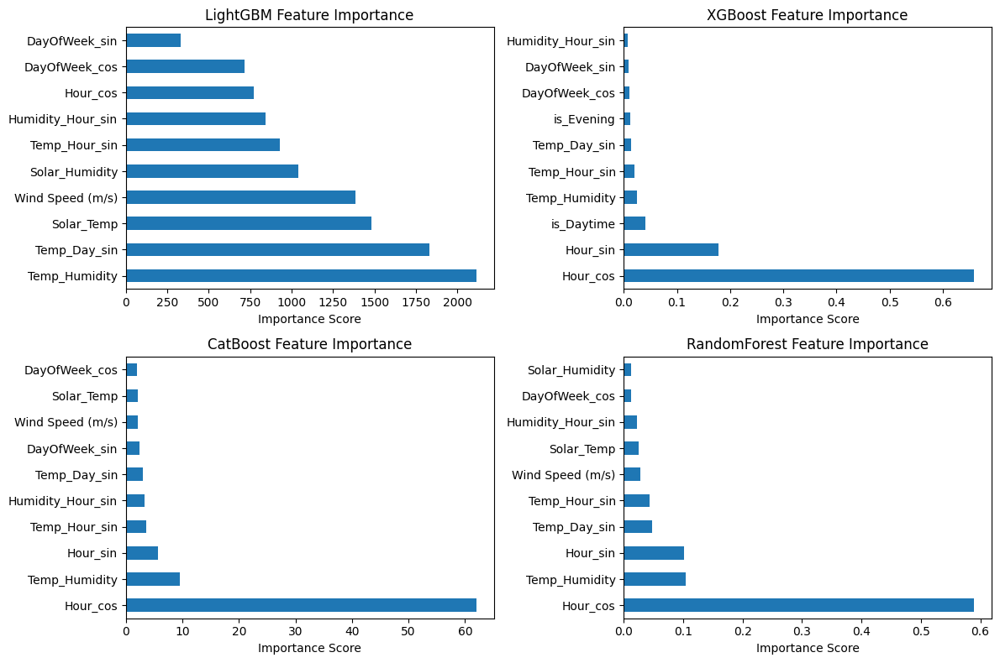

In [60]:
import numpy as np
import pandas as pd
import lightgbm as lgb
import xgboost as xgb
from catboost import CatBoostRegressor
from sklearn.ensemble import RandomForestRegressor
import matplotlib.pyplot as plt
from sklearn.metrics import mean_absolute_percentage_error

# --- SMAPE Function ---
def smape(y_true, y_pred):
    numerator = np.abs(y_pred - y_true)
    denominator = (np.abs(y_true) + np.abs(y_pred)) / 2
    return np.mean(numerator / denominator) * 100

# === Choose one building ===
building_number = 26  # <-- Change this to your building number

# Filter data for this building
bld_train_26 = train[train['Building Number'] == building_number].copy()

# Add time-based flags
bld_train_26['after_6'] = (bld_train_26['Hour'] >= 8).astype(int)
bld_train_26['after_18'] = (bld_train_26['Hour'] >= 17).astype(int)

# === Add 24-hour Moving Average ===
bld_train_26 = bld_train_26.sort_values(by=['Datetime'])  # Ensure chronological order
bld_train_26['MA_24h'] = (
    bld_train_26['Power Consumption (kWh)']
    .rolling(window=24)
    .mean()
)
# === Features & Target ===
features = [
    'is_Daytime', 'is_Late_Night',
    'is_Early_Morning', 'is_Night', 'is_Evening',
    'Wind Speed (m/s)', 
    'Precipitation (mm)',
    'DayOfWeek_sin', 'DayOfWeek_cos','Solar_Temp', 
    'Solar_Humidity', 'Temp_Humidity', 'Temp_Hour_sin', 
    'Temp_Day_sin', 'Humidity_Hour_sin',
    'Hour_sin', 'Hour_cos', 
  # <--- Added moving average feature
]

X = bld_train_26[features]
y = bld_train_26['Power_MA_3']  # Using the moving average target

# === Train-test split (temporal) ===
split_index = int(len(X) * 0.85)
X_train, X_val = X.iloc[:split_index], X.iloc[split_index:]
y_train, y_val = y.iloc[:split_index], y.iloc[split_index:]

# === Model Definitions and Training ===
models = {
    'LightGBM': lgb.LGBMRegressor(
        boosting_type='gbdt',
        n_estimators=400,
        learning_rate=0.01,
        num_leaves=31,
        random_state=42
    ),
    'XGBoost': xgb.XGBRegressor(
        n_estimators=400,
        learning_rate=0.01,
        max_depth=6,  # Default depth, adjustable
        random_state=42
    ),
    'CatBoost': CatBoostRegressor(
        iterations=400,
        learning_rate=0.01,
        depth=6,  # Similar to XGBoost max_depth
        random_state=42,
        verbose=0  # Suppress output
    ),
    'RandomForest': RandomForestRegressor(
        n_estimators=400,
        max_depth=None,  # Allow full growth
        random_state=42
    )
}

# Store results
results = {}

for name, model in models.items():
    # Train model
    if name == 'CatBoost':  # CatBoost uses different fit syntax
        model.fit(X_train, y_train, eval_set=[(X_val, y_val)])
    else:
        model.fit(X_train, y_train)

    # Predictions
    y_pred = model.predict(X_val)

    # Metrics
    building_smape = smape(y_val.values, y_pred)
    building_mape = mean_absolute_percentage_error(y_val, y_pred) * 100
    results[name] = {'SMAPE': building_smape, 'MAPE': building_mape}

    print(f"\n{name} Results for Building {building_number}:")
    print(f"SMAPE: {building_smape:.2f}%")
    print(f"MAPE: {building_mape:.2f}%")

# === Feature Importances Visualization ===
plt.figure(figsize=(12, 8))
for i, (name, model) in enumerate(models.items(), 1):
    feat_imp = pd.Series(model.feature_importances_, index=features).sort_values(ascending=False)
    plt.subplot(2, 2, i)
    feat_imp.nlargest(10).plot(kind='barh')
    plt.title(f'{name} Feature Importance')
    plt.xlabel('Importance Score')
plt.tight_layout()
plt.show()

In [25]:
bld_train_26.head()

,num_date_time,Building Number,Datetime,Temperature (°C),Precipitation (mm),Wind Speed (m/s),Humidity (%),Sunshine Duration (hr),Solar Radiation (MJ/m²),Power Consumption (kWh),...,RollingMean_72h,RollingStd_72h,RollingMedian_72h,RollingMean_168h,RollingStd_168h,RollingMedian_168h,EWMA_24h,after_6,after_18,MA_24h
51000,26_20240601 00,26,2024-06-01 00:00:00,20.5,0.0,4.3,69.0,0.0,0.0,672.94,...,NaN,NaN,NaN,NaN,NaN,NaN,1836.547762,0,0,1351.410000
51001,26_20240601 01,26,2024-06-01 01:00:00,20.0,0.0,3.4,74.0,0.0,0.0,659.55,...,NaN,NaN,NaN,NaN,NaN,NaN,1736.063499,0,0,1535.257692
51002,26_20240601 02,26,2024-06-01 02:00:00,20.1,0.0,0.8,68.0,0.0,0.0,659.14,...,NaN,NaN,NaN,NaN,NaN,NaN,1649.942419,0,0,1690.659286
51003,26_20240601 03,26,2024-06-01 03:00:00,20.0,0.0,2.5,67.0,0.0,0.0,647.01,...,NaN,NaN,NaN,NaN,NaN,NaN,1570.678226,0,0,1821.871333
51004,26_20240601 04,26,2024-06-01 04:00:00,19.9,0.0,2.6,64.0,0.0,0.0,656.68,...,NaN,NaN,NaN,NaN,NaN,NaN,1496.784768,0,0,1947.890000


In [127]:
bld_test_26 = test[test['Building Number'] == 26].copy()
bld_test_26['after_6'] = (bld_test_26['Hour'] >= 8).astype(int)
bld_test_26['after_18'] = (bld_test_26['Hour'] >= 16).astype(int)
# Features for prediction — must match testing features
X_future = bld_test_26[[
    'is_Daytime', 'is_Late_Night',
    'is_Early_Morning', 'is_Night', 'is_Evening',
    'Wind Speed (m/s)', 
    'Precipitation (mm)',
    'DayOfWeek_sin', 'DayOfWeek_cos','Solar_Temp', 
    'Solar_Humidity', 'Temp_Humidity', 'Temp_Hour_sin', 
    'Temp_Day_sin', 'Humidity_Hour_sin',
    'Hour_sin', 'Hour_cos', 
  # <--- Added moving average feature
]]
# Predict
bld_test_26['Predicted Power Consumption (kWh)'] = model.predict(X_future)

# Save predictions
bld_test_26.to_csv("building_26_predictions.csv", index=False)

In [187]:
# === Initialize lag_1h for test ===
# Start with the last known consumption from training
last_train_value = bld_train_26['Power Consumption (kWh)'].iloc[-1]
bld_test_26['lag_1h'] = np.nan
bld_test_26.loc[bld_test_26.index[0], 'lag_1h'] = last_train_value

# === Autoregressive Prediction ===
preds = []

for i in range(len(bld_test_26)):
    # Features for this row
    row_features = bld_test_26.loc[bld_test_26.index[i], [
        'is_Daytime', 'is_Late_Night',
        'is_Early_Morning', 'is_Night', 'is_Evening',
        'Wind Speed (m/s)', 
        'Precipitation (mm)',
        'DayOfWeek_sin', 'DayOfWeek_cos','Solar_Temp', 
        'Solar_Humidity', 'Temp_Humidity', 'Temp_Hour_sin', 
        'Temp_Day_sin', 'Humidity_Hour_sin',
        'Hour_sin', 'Hour_cos', 
        'lag_1h'  # include autoregressive term
    ]].values.reshape(1, -1)
    
    # Predict
    pred = model.predict(row_features)[0]
    preds.append(pred)
    
    # Update lag_1h for the *next* row
    if i < len(bld_test_26) - 1:
        bld_test_26.loc[bld_test_26.index[i+1], 'lag_1h'] = pred

# Save predictions
bld_test_26['Predicted Power Consumption (kWh)'] = preds
bld_test_26.to_csv("building_26_predictions.csv", index=False)

print("Predictions saved for Building 26 ✅")


c:\Users\Dell\Downloads\open\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
c:\Users\Dell\Downloads\open\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
c:\Users\Dell\Downloads\open\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
c:\Users\Dell\Downloads\open\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
c:\Users\Dell\Downloads\open\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warni

Predictions saved for Building 26 ✅


c:\Users\Dell\Downloads\open\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
c:\Users\Dell\Downloads\open\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
c:\Users\Dell\Downloads\open\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
c:\Users\Dell\Downloads\open\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
c:\Users\Dell\Downloads\open\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warni

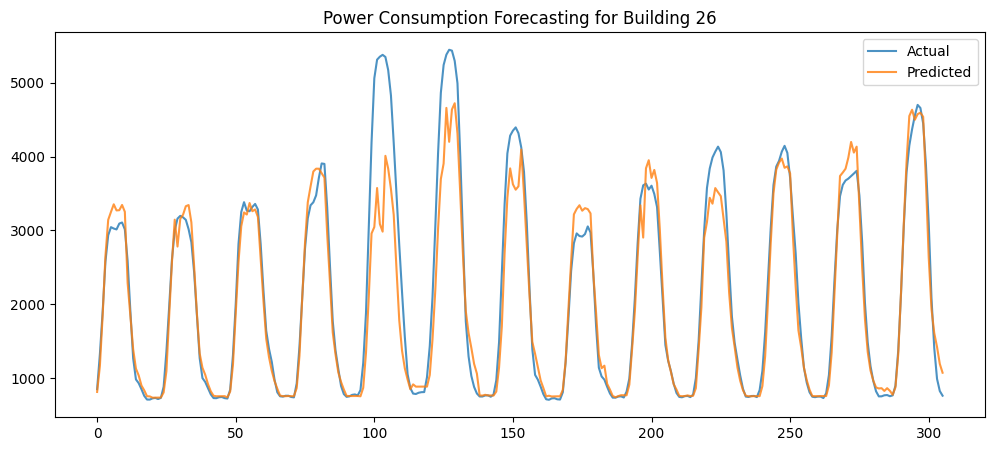

In [63]:
plt.figure(figsize=(12,5))
plt.plot(y_val.values, label="Actual", alpha=0.8)
plt.plot(y_pred, label="Predicted", alpha=0.8)
plt.legend()
plt.title(f"Power Consumption Forecasting for Building {building_number}")
plt.show()

In [30]:
# === Extra models: XGBoost, RandomForest, CatBoost ===
import xgboost as xgb
from sklearn.ensemble import RandomForestRegressor
from catboost import CatBoostRegressor

def smape(y_true, y_pred):
    numerator = np.abs(y_pred - y_true)
    denominator = (np.abs(y_true) + np.abs(y_pred)) / 2
    return np.mean(numerator / denominator) * 100

def eval_and_print(name, y_true, y_pred):
    mape = mean_absolute_percentage_error(y_true, y_pred) * 100
    s = smape(y_true, y_pred)
    print(f"\n{name}")
    print(f"SMAPE: {s:.2f}%")
    print(f"MAPE : {mape:.2f}%")
    return s, mape

# --- XGBoost ---
xgb_model = xgb.XGBRegressor(
    objective='reg:squarederror',
    n_estimators=300,
    learning_rate=0.1,
    max_depth=6,
    min_child_weight=30,
    subsample=0.9,
    colsample_bytree=0.6,
    reg_alpha=6.7,
    reg_lambda=6.0,
    tree_method='hist',
    random_state=42,
    n_jobs=-1
)
xgb_model.fit(X_train, y_train, eval_set=[(X_val, y_val)])
xgb_pred = xgb_model.predict(X_val)
eval_and_print("XGBoost", y_val, xgb_pred)

# --- Random Forest ---
rf_model = RandomForestRegressor(
    n_estimators=300,
    max_depth=None,
    min_samples_split=2,
    min_samples_leaf=1,
    max_features='sqrt',
    n_jobs=-1,
    random_state=42
)
rf_model.fit(X_train, y_train)
rf_pred = rf_model.predict(X_val)
eval_and_print("Random Forest", y_val, rf_pred)

# --- CatBoost ---
# (CatBoost handles missing values natively; keeps evals quiet with verbose=0)
cb_model = CatBoostRegressor(
    iterations=300,
    learning_rate=0.1,
    depth=8,
    l2_leaf_reg=6.0,
    loss_function='RMSE',
    random_seed=42,
    verbose=0
)
cb_model.fit(X_train, y_train, eval_set=(X_val, y_val), use_best_model=True)
cb_pred = cb_model.predict(X_val)
eval_and_print("CatBoost", y_val, cb_pred)


[0]	validation_0-rmse:1464.58490
[1]	validation_0-rmse:1421.46540
[2]	validation_0-rmse:1319.59977
[3]	validation_0-rmse:1232.36559
[4]	validation_0-rmse:1165.33359
[5]	validation_0-rmse:1091.92854
[6]	validation_0-rmse:1027.13127
[7]	validation_0-rmse:969.25788
[8]	validation_0-rmse:915.26292
[9]	validation_0-rmse:869.80278
[10]	validation_0-rmse:825.98763
[11]	validation_0-rmse:789.78126
[12]	validation_0-rmse:756.32136
[13]	validation_0-rmse:726.71685
[14]	validation_0-rmse:701.75174
[15]	validation_0-rmse:675.87928
[16]	validation_0-rmse:655.35614
[17]	validation_0-rmse:636.98686
[18]	validation_0-rmse:622.36348
[19]	validation_0-rmse:607.21277
[20]	validation_0-rmse:592.63730


[21]	validation_0-rmse:582.20924
[22]	validation_0-rmse:573.30111
[23]	validation_0-rmse:561.42499
[24]	validation_0-rmse:552.13425
[25]	validation_0-rmse:543.31718
[26]	validation_0-rmse:533.68718
[27]	validation_0-rmse:525.96094
[28]	validation_0-rmse:523.10902
[29]	validation_0-rmse:519.40168
[30]	validation_0-rmse:513.85162
[31]	validation_0-rmse:508.17535
[32]	validation_0-rmse:505.41859
[33]	validation_0-rmse:502.94759
[34]	validation_0-rmse:500.12627
[35]	validation_0-rmse:494.64929
[36]	validation_0-rmse:491.21753
[37]	validation_0-rmse:486.90096
[38]	validation_0-rmse:481.36499
[39]	validation_0-rmse:476.28166
[40]	validation_0-rmse:474.03243
[41]	validation_0-rmse:473.20250
[42]	validation_0-rmse:469.46277
[43]	validation_0-rmse:465.26261
[44]	validation_0-rmse:463.41795
[45]	validation_0-rmse:462.34591
[46]	validation_0-rmse:461.16636
[47]	validation_0-rmse:458.79918
[48]	validation_0-rmse:455.87275
[49]	validation_0-rmse:455.56000
[50]	validation_0-rmse:454.61025
[51]	valid

(np.float64(12.759894299170755), 13.03497039269712)

# Building # 87


Top correlations with Power Consumption:
Power Consumption (kWh)       1.000000
Power_MA_3                    0.995726
Hour_sin                      0.423051
Temp_Hour_sin                 0.407746
Humidity_Hour_sin             0.405676
is_Late_Night                 0.384993
DayOfWeek_sin                 0.316368
Hour_cos                      0.307691
Temp_Day_sin                  0.289995
Humidity2                     0.277375
is_calm                       0.256994
Humidity (%)                  0.240992
Solar_Humidity                0.240992
is_mild                       0.191615
Week_cos                      0.150409
Week                          0.103136
Month_cos                     0.094418
is_Early_Morning              0.088088
DayOfWeek_cos                 0.070318
Temp_Humidity                 0.055908
Holiday_Hour                  0.054140
is_Night                      0.030732
is_windy                      0.021429
Day_sin                      -0.017603
is_rain_heavy         

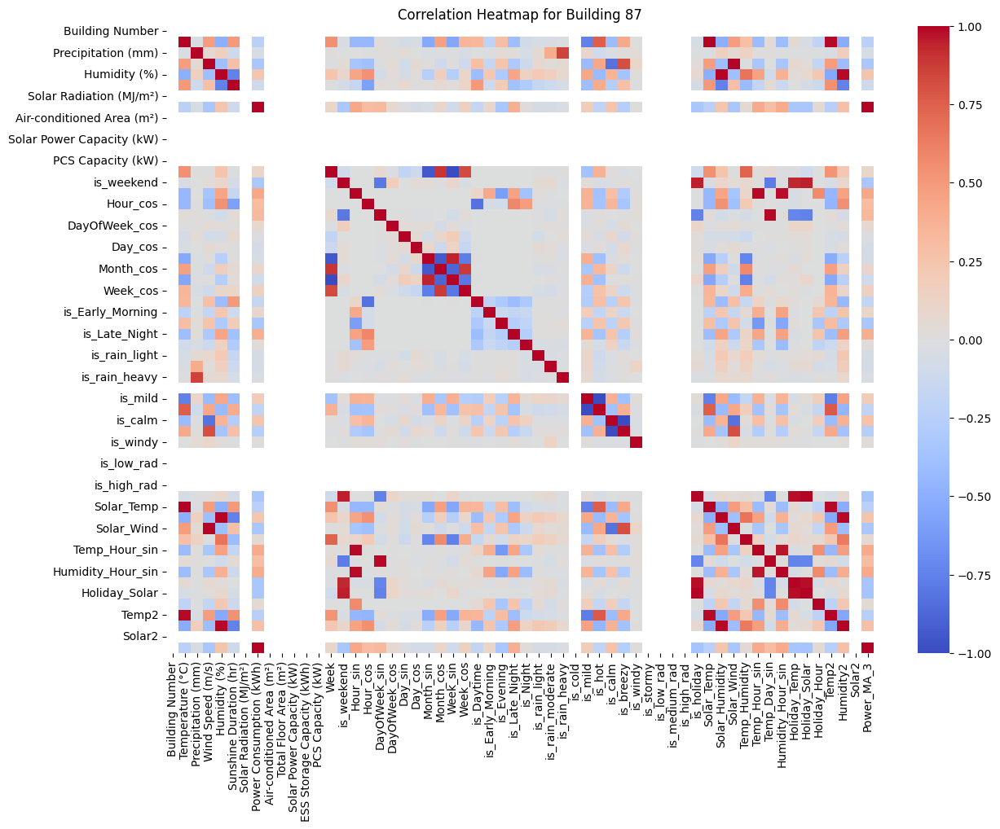

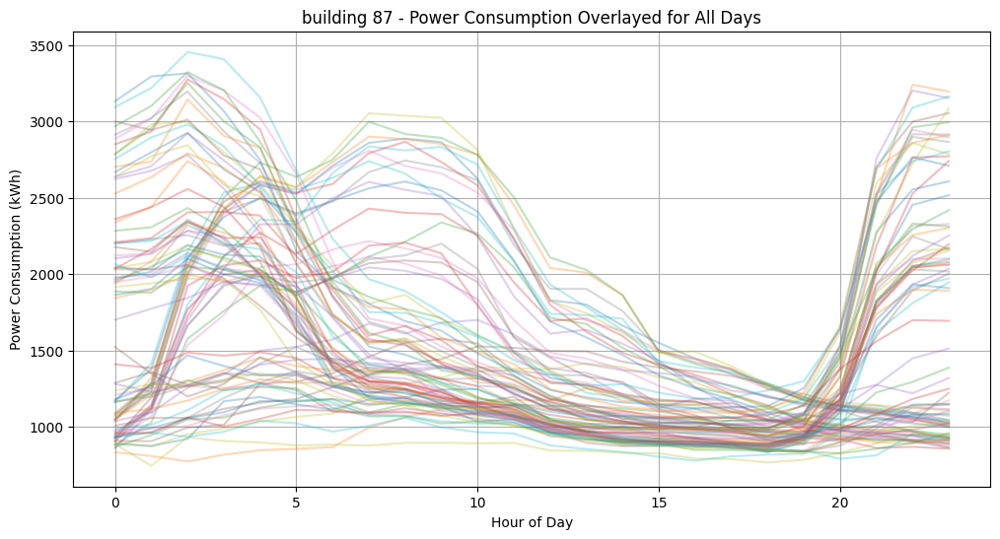

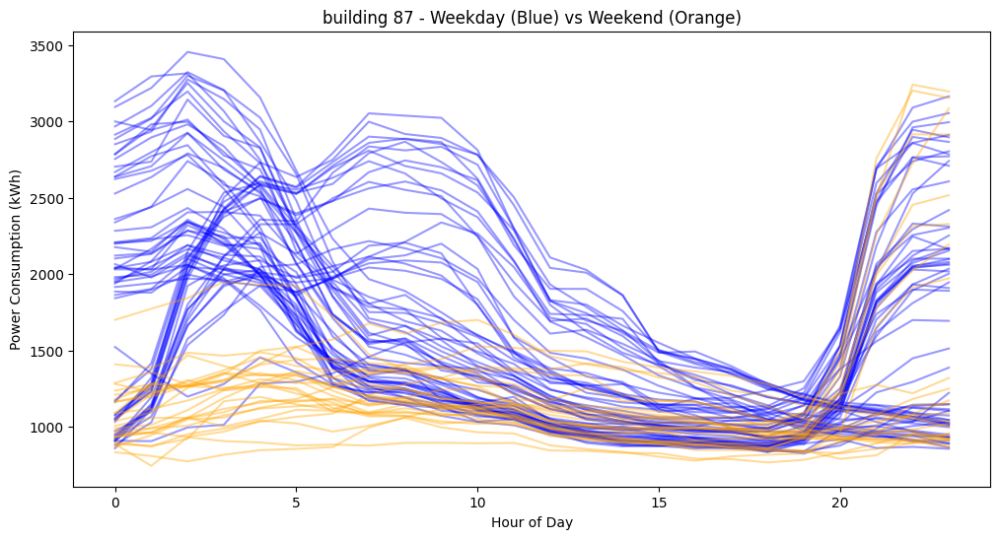

In [69]:
import matplotlib.pyplot as plt
import seaborn as sns
building_number = 87
# Filtered dataset for the selected building
bld_train_87 = train[train['Building Number'] == building_number]

# Select only numeric columns for correlation
numeric_cols = bld_train_87.select_dtypes(include=['float64', 'int64'])

# Compute correlation matrix
corr_matrix = numeric_cols.corr()

# Display top correlations with the target variable
target_corr = corr_matrix['Power Consumption (kWh)'].sort_values(ascending=False)
print("\nTop correlations with Power Consumption:")
print(target_corr)

# === Heatmap Visualization ===
plt.figure(figsize=(14, 10))
sns.heatmap(corr_matrix, annot=False, cmap="coolwarm", center=0)
plt.title(f"Correlation Heatmap for Building {building_number}")
plt.show()
import matplotlib.pyplot as plt

builing_87 = train[train["Building Number"] == building_number].copy()
builing_87["Datetime"] = pd.to_datetime(builing_87["Datetime"])
builing_87["Hour"] = builing_87["Datetime"].dt.hour
builing_87["Date"] = builing_87["Datetime"].dt.date

plt.figure(figsize=(12, 6))
for date in builing_87["Date"].unique():
    day_data = builing_87[builing_87["Date"] == date]
    plt.plot(day_data["Hour"], day_data["Power Consumption (kWh)"], alpha=0.3)

plt.title("building 87 - Power Consumption Overlayed for All Days")
plt.xlabel("Hour of Day")
plt.ylabel("Power Consumption (kWh)")
plt.grid(True)
plt.show()
import matplotlib.pyplot as plt

builing_87 = train[train["Building Number"] == building_number].copy()
builing_87["Datetime"] = pd.to_datetime(builing_87["Datetime"])
builing_87["DayOfWeek"] = builing_87["Datetime"].dt.dayofweek
builing_87["is_weekend"] = builing_87["DayOfWeek"] >= 5
plt.figure(figsize=(12, 6))
for day in builing_87[~builing_87["is_weekend"]]["Datetime"].dt.date.unique():
    daily = builing_87[builing_87["Datetime"].dt.date == day]
    plt.plot(daily["Hour"], daily["Power Consumption (kWh)"], alpha=0.4, color="blue")
for day in builing_87[builing_87["is_weekend"]]["Datetime"].dt.date.unique():
    daily = builing_87[builing_87["Datetime"].dt.date == day]
    plt.plot(daily["Hour"], daily["Power Consumption (kWh)"], alpha=0.4, color="orange")

plt.title("building 87 - Weekday (Blue) vs Weekend (Orange)")
plt.xlabel("Hour of Day")
plt.ylabel("Power Consumption (kWh)")
plt.show()



In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

# Filter data for Building 1
building_1 = train[train["Building Number"] == building_number].copy()

# Convert to datetime properly (VERY important)
building_1["Datetime"] = pd.to_datetime(building_1["Datetime"], errors="coerce")

# Sort by datetime
building_1 = building_1.sort_values("Datetime")

# Extract date (YYYY-MM-DD) from datetime
building_1["Date"] = building_1["Datetime"].dt.date

# Get unique sorted dates
unique_dates = sorted(building_1["Date"].unique())

# Generate separate plots for each day
for date in unique_dates:
    day_data = building_1[building_1["Date"] == date]
    plt.figure(figsize=(10, 4))
    plt.plot(day_data["Datetime"], day_data["Power Consumption (kWh)"], marker="o", linewidth=1)
    plt.title(f"Building 1 - Power Consumption on {date}")
    plt.xlabel("Hour")
    plt.ylabel("Power Consumption (kWh)")
    plt.xticks(rotation=45)
    plt.grid(True)
    plt.tight_layout()
    plt.show()

C:\Users\Dell\AppData\Local\Temp\ipykernel_14368\1838005341.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  bld_train_87['consumption_shift'] = bld_train_87.apply(consumption_shift_continuous, axis=1)
C:\Users\Dell\AppData\Local\Temp\ipykernel_14368\1838005341.py:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  bld_train_87['Period'] = (bld_train_87['Datetime'] >= '2024-06-30').astype(int)


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000150 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1742
[LightGBM] [Info] Number of data points in the train set: 1632, number of used features: 19
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 1443.346936
Building Number: 87
SMAPE: 11.36%
MAPE: 11.12%


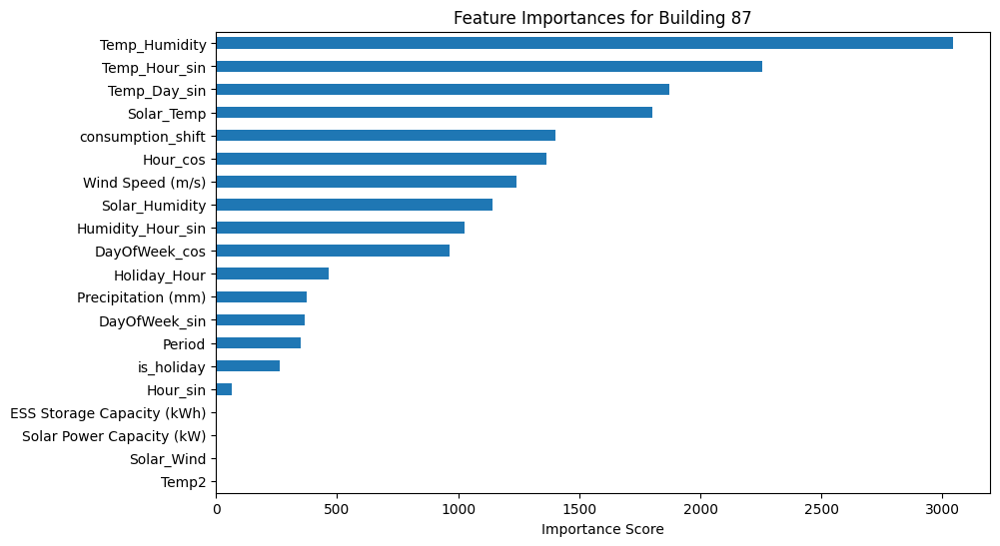

In [113]:
import numpy as np
import pandas as pd
import lightgbm as lgb
import matplotlib.pyplot as plt
from sklearn.metrics import mean_absolute_percentage_error
from sklearn.model_selection import train_test_split

# --- SMAPE Function ---
def smape(y_true, y_pred):
    numerator = np.abs(y_pred - y_true)
    denominator = (np.abs(y_true) + np.abs(y_pred)) / 2
    return np.mean(numerator / denominator) * 100

# === Add new time-based features ===

# === Choose one building ===
building_number = 87  # <-- Change this to your building number

def consumption_shift_continuous(row):
    if row['Month'] == 6:
        # Before 1 AM → 0, Between 1–15 → rising, After 15 → falling
        if row['Hour'] < 1:
            return 0
        elif row['Hour'] < 15:
            return (row['Hour'] - 1) / (15 - 1)  # normalized 0 → 1
        else:
            return - (row['Hour'] - 15) / (24 - 15)  # normalized 0 → -1
    elif row['Month'] == 7:
        # Before 6 AM → 0, Between 6–19 → falling, After 19 → rising
        if row['Hour'] < 6:
            return 0
        elif row['Hour'] < 19:
            return - (row['Hour'] - 6) / (19 - 6)  # normalized 0 → -1
        else:
            return (row['Hour'] - 19) / (24 - 19)  # normalized 0 → 1
    else:
        return 0

bld_train_87['consumption_shift'] = bld_train_87.apply(consumption_shift_continuous, axis=1)

bld_train_87['Period'] = (bld_train_87['Datetime'] >= '2024-06-30').astype(int)


# === Features & Target ===
X = bld_train_87[[
    'Wind Speed (m/s)', 
    'Precipitation (mm)', 'ESS Storage Capacity (kWh)', 'Solar Power Capacity (kW)',
    'DayOfWeek_sin', 'DayOfWeek_cos', 'is_holiday', 'Solar_Temp', 
    'Solar_Humidity', 'Solar_Wind', 'Temp_Humidity', 'Temp_Hour_sin', 
    'Temp_Day_sin', 'Humidity_Hour_sin', 
    'Holiday_Hour', 'Temp2', 'Humidity2', 'Hour_sin', 'Hour_cos', 
     'Period', 'consumption_shift'
]]

y = bld_train_87['Power_MA_3'] 

split_index = int(len(X) * 0.8)
X_train, X_val = X.iloc[:split_index], X.iloc[split_index:]
y_train, y_val = y.iloc[:split_index], y.iloc[split_index:]
# === LightGBM Model ===
model = lgb.LGBMRegressor(
    boosting_type='gbdt',
    n_estimators=600,
    learning_rate=0.01,
    num_leaves=31,
    random_state=42
)
# Train model
model.fit(X_train, y_train, eval_set=[(X_val, y_val)])

# === Predictions ===
y_pred = model.predict(X_val)

# === Metrics ===
building_smape = smape(y_val.values, y_pred)
building_mape = mean_absolute_percentage_error(y_val, y_pred) * 100

print(f"Building Number: {building_number}")
print(f"SMAPE: {building_smape:.2f}%")
print(f"MAPE: {building_mape:.2f}%")

# === Feature Importances ===
feat_importances = pd.Series(model.feature_importances_, index=X.columns)
plt.figure(figsize=(10, 6))
feat_importances.nlargest(20).sort_values().plot(kind='barh')
plt.title(f'Feature Importances for Building {building_number}')
plt.xlabel('Importance Score')
plt.show()


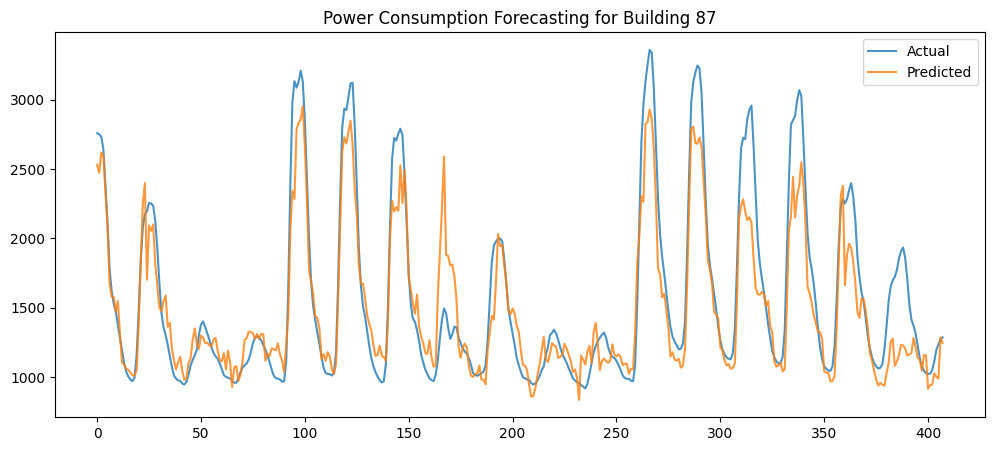

In [112]:
plt.figure(figsize=(12,5))
plt.plot(y_val.values, label="Actual", alpha=0.8)
plt.plot(y_pred, label="Predicted", alpha=0.8)
plt.legend()
plt.title(f"Power Consumption Forecasting for Building {building_number}")
plt.show()

In [117]:
bld_test_87 = test[test['Building Number'] == 26].copy()
def consumption_shift_continuous(row):
    if row['Month'] == 6:
        # Before 1 AM → 0, Between 1–15 → rising, After 15 → falling
        if row['Hour'] < 1:
            return 0
        elif row['Hour'] < 15:
            return (row['Hour'] - 1) / (15 - 1)  # normalized 0 → 1
        else:
            return - (row['Hour'] - 15) / (24 - 15)  # normalized 0 → -1
    elif row['Month'] == 7:
        # Before 6 AM → 0, Between 6–19 → falling, After 19 → rising
        if row['Hour'] < 6:
            return 0
        elif row['Hour'] < 19:
            return - (row['Hour'] - 6) / (19 - 6)  # normalized 0 → -1
        else:
            return (row['Hour'] - 19) / (24 - 19)  # normalized 0 → 1
    else:
        return 0

bld_test_87['Period'] = (bld_train_87['Datetime'] >= '2024-06-30').astype(int)

bld_test_87['consumption_shift'] = bld_test_87.apply(consumption_shift_continuous, axis=1)
# Features for prediction — must match testing features
X_future = bld_test_87[[
    'Wind Speed (m/s)', 
    'Precipitation (mm)', 'ESS Storage Capacity (kWh)', 'Solar Power Capacity (kW)',
    'DayOfWeek_sin', 'DayOfWeek_cos', 'is_holiday', 'Solar_Temp', 
    'Solar_Humidity', 'Solar_Wind', 'Temp_Humidity', 'Temp_Hour_sin', 
    'Temp_Day_sin', 'Humidity_Hour_sin', 
    'Holiday_Hour', 'Temp2', 'Humidity2', 'Hour_sin', 'Hour_cos', 
     'Period', 'consumption_shift'
]]
# Predict
bld_test_87['Predicted Power Consumption (kWh)'] = model.predict(X_future)

# Save predictions
bld_test_87.to_csv("building_87_predictions.csv", index=False)

# Building # 10


Top correlations with Power Consumption:
Power Consumption (kWh)       1.000000
Power_MA_3                    0.998120
Temp2                         0.703444
Temperature (°C)              0.700952
Week                          0.667325
Month_cos                     0.609256
is_hot                        0.591168
Week_cos                      0.451344
Temp_Humidity                 0.442753
is_Daytime                    0.311622
Wind Speed (m/s)              0.245103
is_breezy                     0.218070
Sunshine Duration (hr)        0.204128
Holiday_Temp                  0.198755
is_Evening                    0.194648
is_holiday                    0.100334
is_weekend                    0.099327
Day_sin                       0.064938
is_rain_heavy                -0.027004
DayOfWeek_cos                -0.027342
is_rain_light                -0.029232
Precipitation (mm)           -0.030758
is_Night                     -0.037750
is_rain_moderate             -0.041940
is_cold               

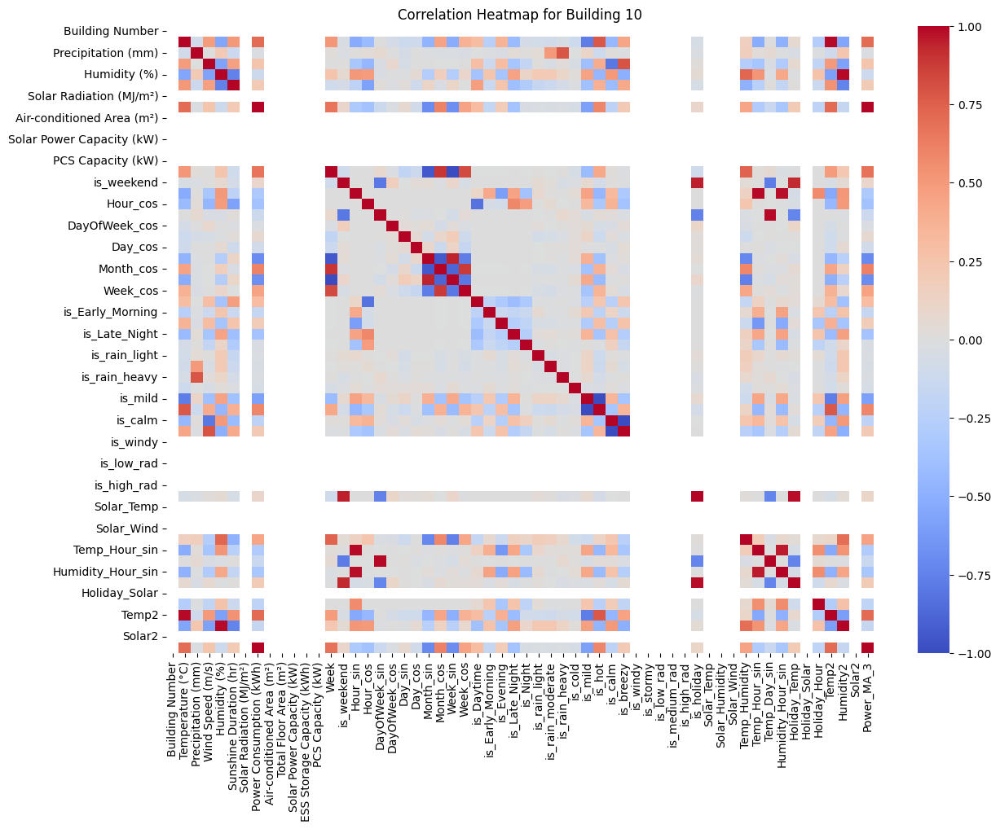

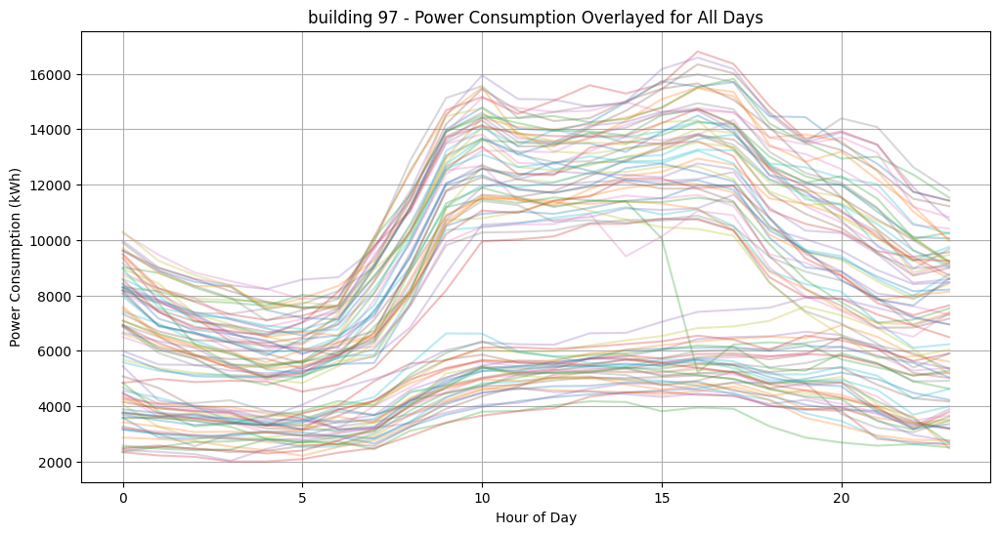

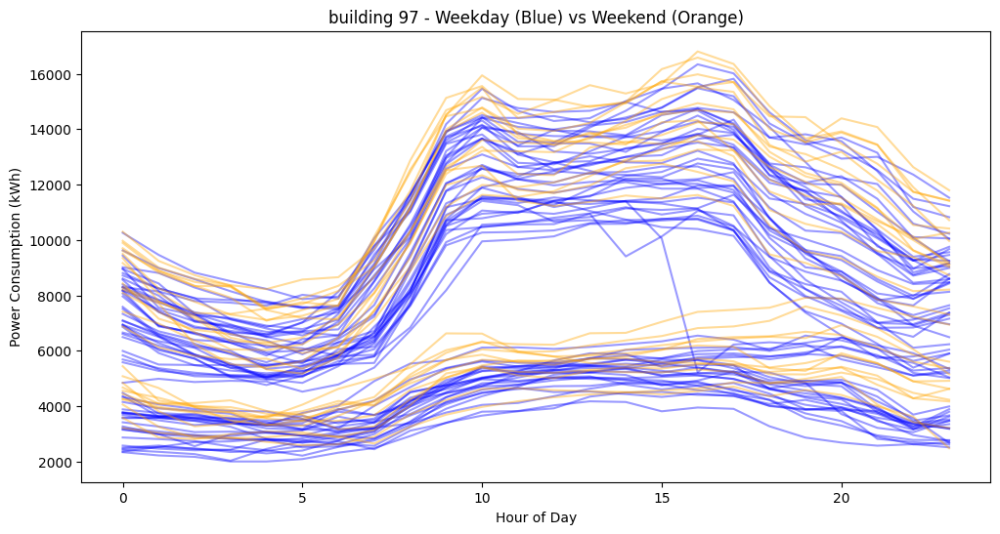

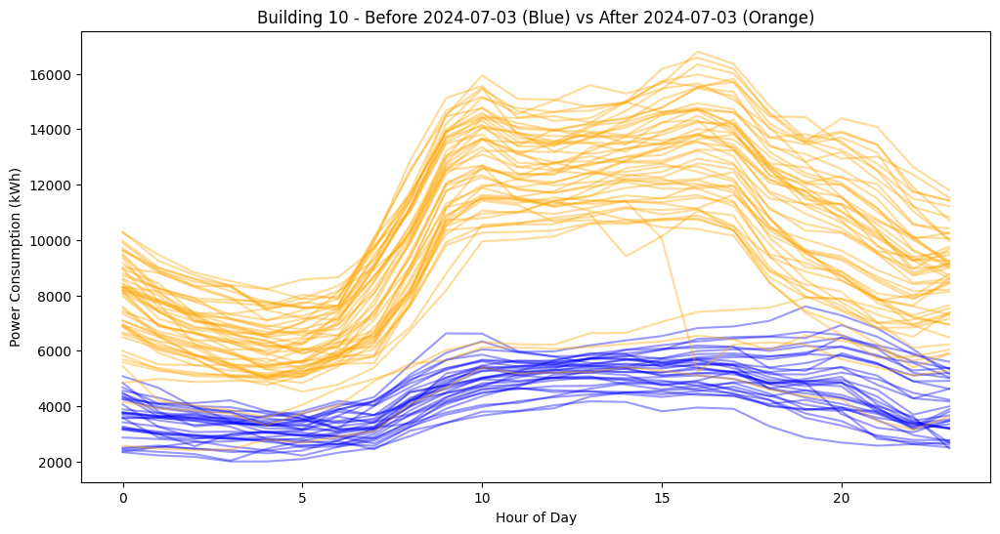

In [149]:
import matplotlib.pyplot as plt
import seaborn as sns
building_number = 10
# Filtered dataset for the selected building
bld_train_10 = train[train['Building Number'] == building_number]

# Select only numeric columns for correlation
numeric_cols = bld_train_10.select_dtypes(include=['float64', 'int64'])

# Compute correlation matrix
corr_matrix = numeric_cols.corr()

# Display top correlations with the target variable
target_corr = corr_matrix['Power Consumption (kWh)'].sort_values(ascending=False)
print("\nTop correlations with Power Consumption:")
print(target_corr)

# === Heatmap Visualization ===
plt.figure(figsize=(14, 10))
sns.heatmap(corr_matrix, annot=False, cmap="coolwarm", center=0)
plt.title(f"Correlation Heatmap for Building {building_number}")
plt.show()
import matplotlib.pyplot as plt

building_10 = train[train["Building Number"] == building_number].copy()
building_10["Datetime"] = pd.to_datetime(building_10["Datetime"])
building_10["Hour"] = building_10["Datetime"].dt.hour
building_10["Date"] = building_10["Datetime"].dt.date

plt.figure(figsize=(12, 6))
for date in building_10["Date"].unique():
    day_data = building_10[building_10["Date"] == date]
    plt.plot(day_data["Hour"], day_data["Power Consumption (kWh)"], alpha=0.3)

plt.title("building 97 - Power Consumption Overlayed for All Days")
plt.xlabel("Hour of Day")
plt.ylabel("Power Consumption (kWh)")
plt.grid(True)
plt.show()
import matplotlib.pyplot as plt

building_10 = train[train["Building Number"] == building_number].copy()
building_10["Datetime"] = pd.to_datetime(building_10["Datetime"])
building_10["DayOfWeek"] = building_10["Datetime"].dt.dayofweek
building_10["is_weekend"] = building_10["DayOfWeek"] >= 5
plt.figure(figsize=(12, 6))
for day in building_10[~building_10["is_weekend"]]["Datetime"].dt.date.unique():
    daily = building_10[building_10["Datetime"].dt.date == day]
    plt.plot(daily["Hour"], daily["Power Consumption (kWh)"], alpha=0.4, color="blue")
for day in building_10[building_10["is_weekend"]]["Datetime"].dt.date.unique():
    daily = building_10[building_10["Datetime"].dt.date == day]
    plt.plot(daily["Hour"], daily["Power Consumption (kWh)"], alpha=0.4, color="orange")

plt.title("building 97 - Weekday (Blue) vs Weekend (Orange)")
plt.xlabel("Hour of Day")
plt.ylabel("Power Consumption (kWh)")
plt.show()
import matplotlib.pyplot as plt
import pandas as pd

# Filter building data
building_10 = train[train["Building Number"] == building_number].copy()
building_10["Datetime"] = pd.to_datetime(building_10["Datetime"])

# Create a flag for before and after 2024-07-03
split_date = pd.Timestamp("2024-07-03")
building_10["is_before"] = building_10["Datetime"] < split_date

plt.figure(figsize=(12, 6))

# Plot days before 2024-07-03 (Blue)
for day in building_10[building_10["is_before"]]["Datetime"].dt.date.unique():
    daily = building_10[building_10["Datetime"].dt.date == day]
    plt.plot(daily["Hour"], daily["Power Consumption (kWh)"], alpha=0.4, color="blue")

# Plot days on/after 2024-07-03 (Orange)
for day in building_10[~building_10["is_before"]]["Datetime"].dt.date.unique():
    daily = building_10[building_10["Datetime"].dt.date == day]
    plt.plot(daily["Hour"], daily["Power Consumption (kWh)"], alpha=0.4, color="orange")

plt.title(f"Building {building_number} - Before 2024-07-03 (Blue) vs After 2024-07-03 (Orange)")
plt.xlabel("Hour of Day")
plt.ylabel("Power Consumption (kWh)")
plt.show()




In [129]:
train.head()

,num_date_time,Building Number,Datetime,Temperature (°C),Precipitation (mm),Wind Speed (m/s),Humidity (%),Sunshine Duration (hr),Solar Radiation (MJ/m²),Power Consumption (kWh),...,Temp_Hour_sin,Temp_Day_sin,Humidity_Hour_sin,Holiday_Temp,Holiday_Solar,Holiday_Hour,Temp2,Humidity2,Solar2,Power_MA_3
0,1_20240601 00,1,2024-06-01 00:00:00,18.3,0.0,2.6,82.0,0.0,0.0,5794.80,...,0.000000,-17.841181,0.000000,18.3,0.0,0.000000,334.89,6724.0,0.0,5727.15
1,1_20240601 01,1,2024-06-01 01:00:00,18.3,0.0,2.7,82.0,0.0,0.0,5591.85,...,4.736389,-17.841181,21.223162,18.3,0.0,0.258819,334.89,6724.0,0.0,5574.94
2,1_20240601 02,1,2024-06-01 02:00:00,18.1,0.0,2.6,80.0,0.0,0.0,5338.17,...,9.050000,-17.646195,40.000000,18.1,0.0,0.500000,327.61,6400.0,0.0,5161.48
3,1_20240601 03,1,2024-06-01 03:00:00,18.0,0.0,2.6,81.0,0.0,0.0,4554.42,...,12.727922,-17.548702,57.275649,18.0,0.0,0.707107,324.00,6561.0,0.0,4498.28
4,1_20240601 04,1,2024-06-01 04:00:00,17.8,0.0,1.3,81.0,0.0,0.0,3602.25,...,15.415252,-17.353717,70.148058,17.8,0.0,0.866025,316.84,6561.0,0.0,3841.42


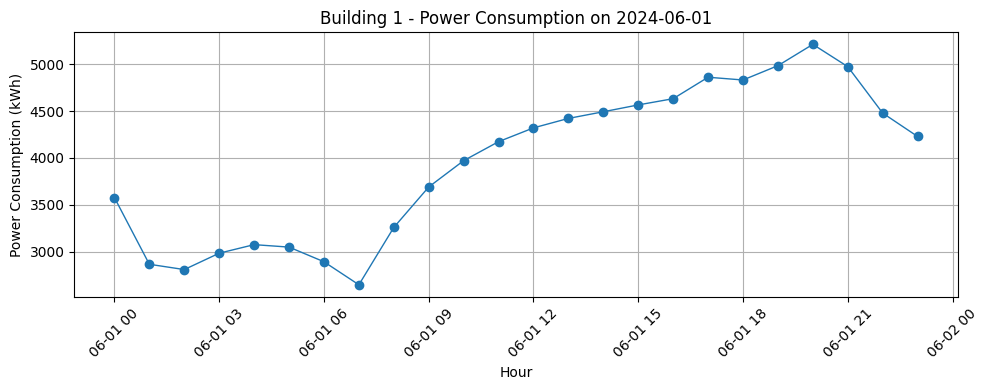

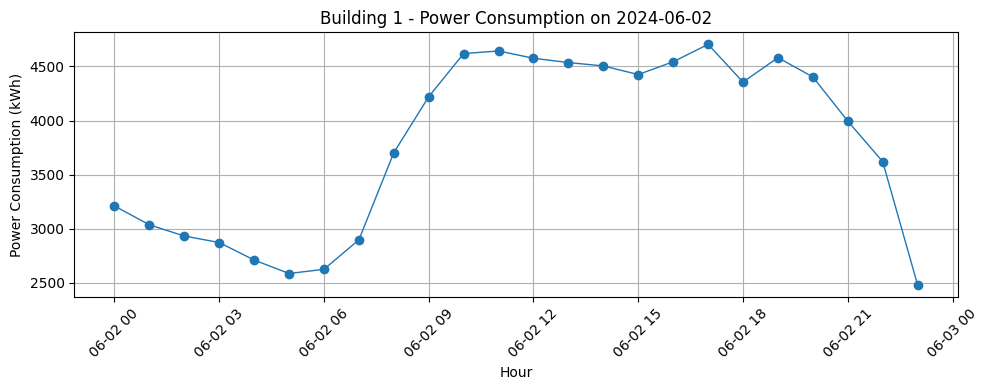

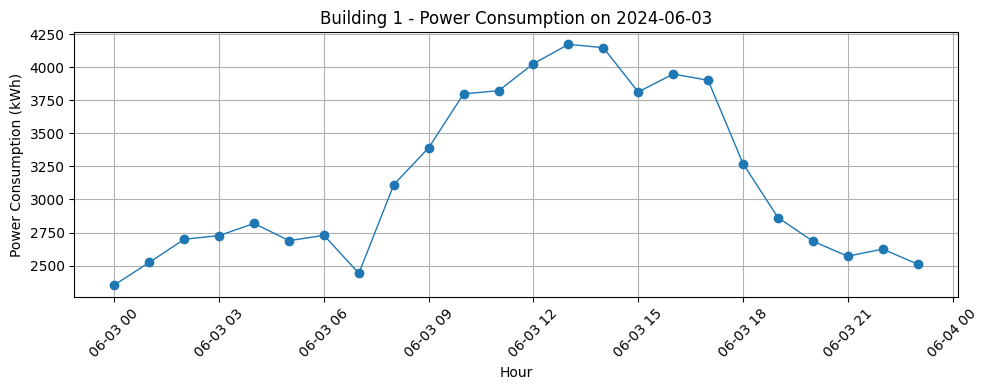

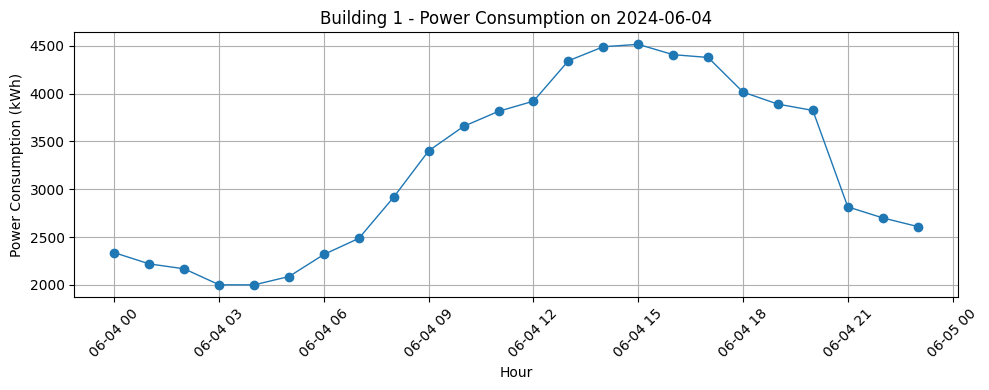

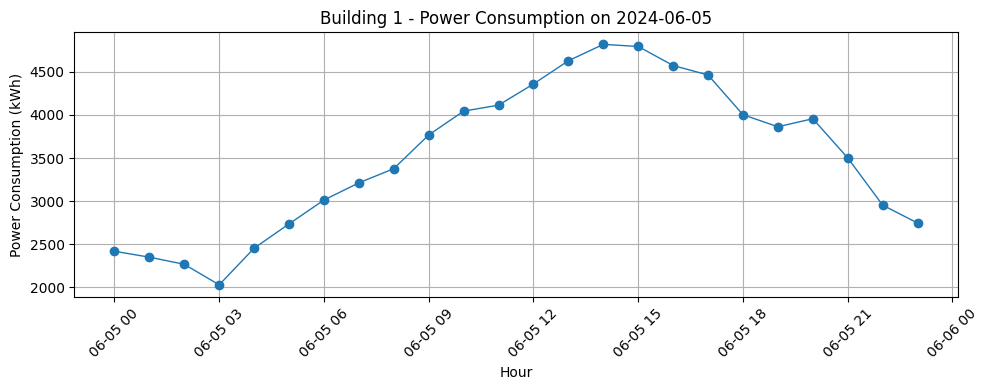

...

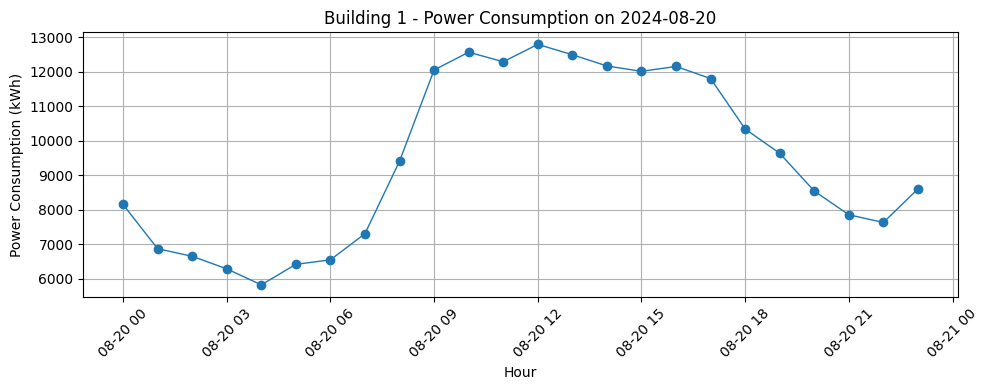

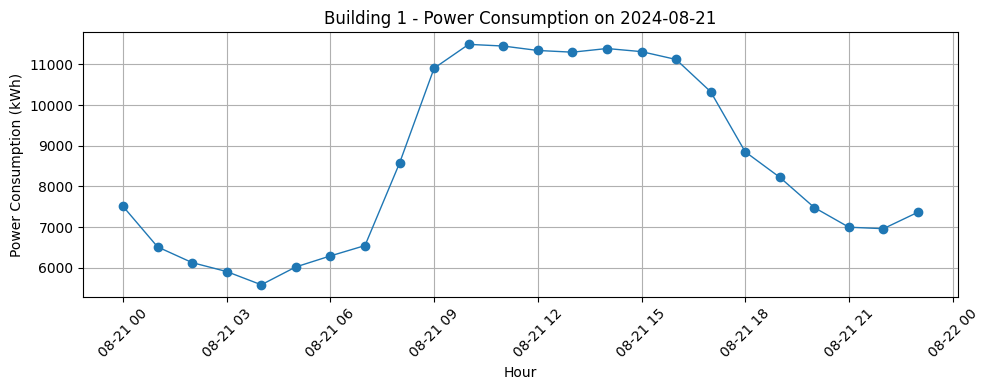

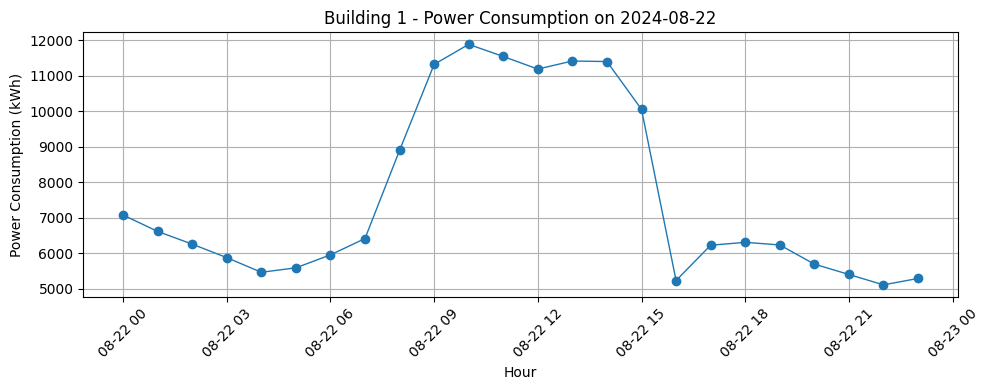

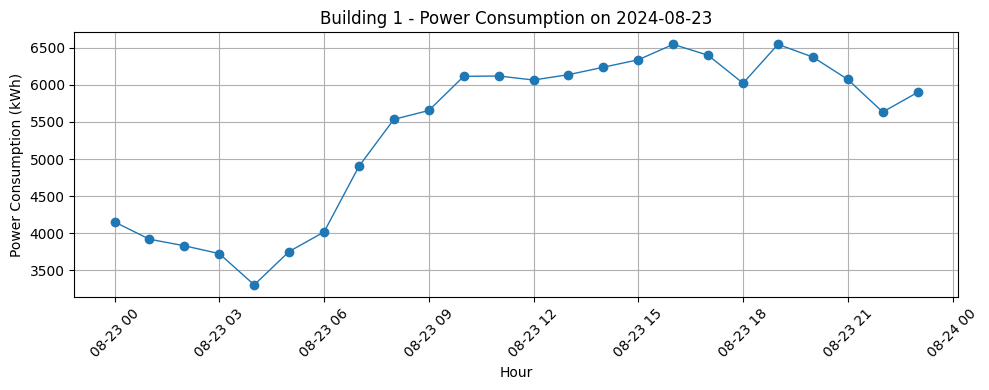

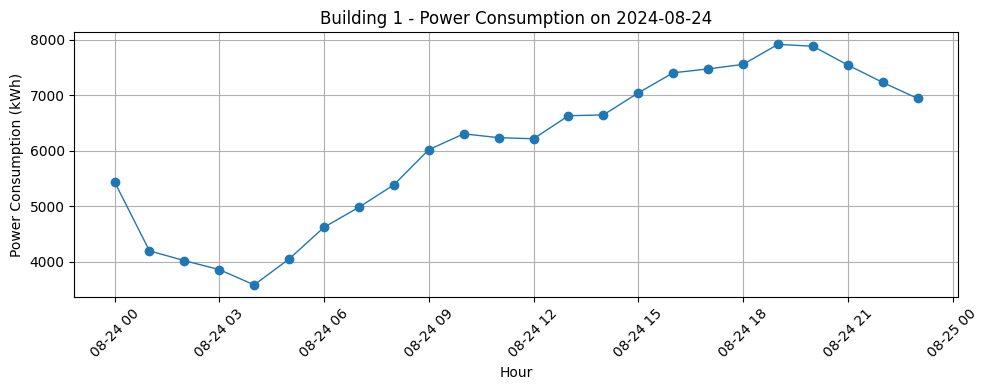

In [130]:
import matplotlib.pyplot as plt
import pandas as pd

# Filter data for Building 1
building_1 = train[train["Building Number"] == building_number].copy()

# Convert to datetime properly (VERY important)
building_1["Datetime"] = pd.to_datetime(building_1["Datetime"], errors="coerce")

# Sort by datetime
building_1 = building_1.sort_values("Datetime")

# Extract date (YYYY-MM-DD) from datetime
building_1["Date"] = building_1["Datetime"].dt.date

# Get unique sorted dates
unique_dates = sorted(building_1["Date"].unique())

# Generate separate plots for each day
for date in unique_dates:
    day_data = building_1[building_1["Date"] == date]
    plt.figure(figsize=(10, 4))
    plt.plot(day_data["Datetime"], day_data["Power Consumption (kWh)"], marker="o", linewidth=1)
    plt.title(f"Building 1 - Power Consumption on {date}")
    plt.xlabel("Hour")
    plt.ylabel("Power Consumption (kWh)")
    plt.xticks(rotation=45)
    plt.grid(True)
    plt.tight_layout()
    plt.show()

C:\Users\Dell\AppData\Local\Temp\ipykernel_14368\2189012521.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  building_1_august["Date"] = building_1_august["Datetime"].dt.date


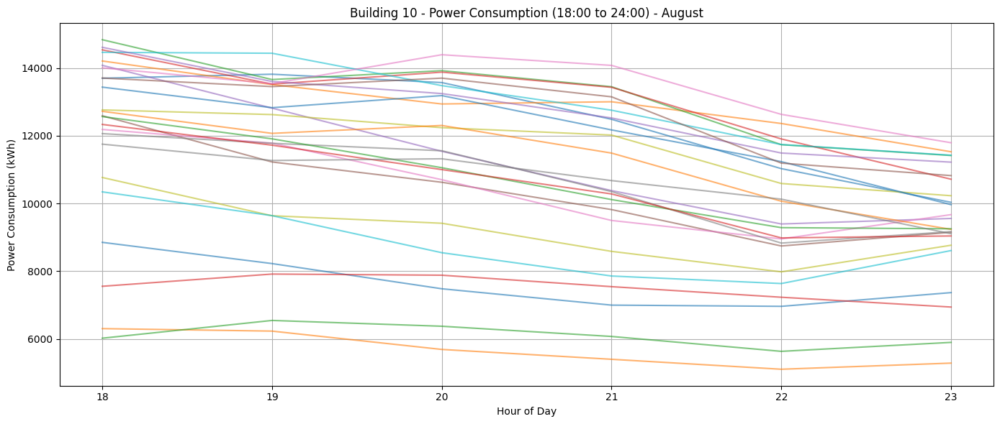

In [161]:
import matplotlib.pyplot as plt
import pandas as pd

# Filter data for the specific building
building_1 = train[train["Building Number"] == building_number].copy()

# Convert Datetime column properly
building_1["Datetime"] = pd.to_datetime(building_1["Datetime"], errors="coerce")

# Extract month and hour
building_1["Month"] = building_1["Datetime"].dt.month
building_1["Hour"] = building_1["Datetime"].dt.hour

# Filter for August only & hours between 18:00 and 24:00
building_1_august = building_1[
    (building_1["Month"] == 8) & (building_1["Hour"] >= 18) & (building_1["Hour"] <= 23)
]

# Extract date
building_1_august["Date"] = building_1_august["Datetime"].dt.date

# Plot for all August days on a single figure
plt.figure(figsize=(14, 6))

for date in sorted(building_1_august["Date"].unique()):
    day_data = building_1_august[building_1_august["Date"] == date]
    plt.plot(day_data["Hour"], day_data["Power Consumption (kWh)"], alpha=0.6)

plt.title(f"Building {building_number} - Power Consumption (18:00 to 24:00) - August")
plt.xlabel("Hour of Day")
plt.ylabel("Power Consumption (kWh)")
plt.xticks([18, 19, 20, 21, 22, 23])
plt.grid(True)
plt.tight_layout()
plt.show()


In [131]:
train.columns

Index(['num_date_time', 'Building Number', 'Datetime', 'Temperature (°C)',
       'Precipitation (mm)', 'Wind Speed (m/s)', 'Humidity (%)',
       'Sunshine Duration (hr)', 'Solar Radiation (MJ/m²)',
       'Power Consumption (kWh)', 'Hour', 'Day', 'Air-conditioned Area (m²)',
       'Total Floor Area (m²)', 'Building Type', 'Solar Power Capacity (kW)',
       'ESS Storage Capacity (kWh)', 'PCS Capacity (kW)', 'DayOfWeek', 'Month',
       'Week', 'is_weekend', 'Hour_sin', 'Hour_cos', 'DayOfWeek_sin',
       'DayOfWeek_cos', 'Day_sin', 'Day_cos', 'Month_sin', 'Month_cos',
       'Week_sin', 'Week_cos', 'is_Daytime', 'is_Early_Morning', 'is_Evening',
       'is_Late_Night', 'is_Night', 'is_rain_light', 'is_rain_moderate',
       'is_rain_heavy', 'is_cold', 'is_mild', 'is_hot', 'is_calm', 'is_breezy',
       'is_windy', 'is_stormy', 'is_low_rad', 'is_medium_rad', 'is_high_rad',
       'is_holiday', 'Solar_Temp', 'Solar_Humidity', 'Solar_Wind',
       'Temp_Humidity', 'Temp_Hour_sin', 'Tem

C:\Users\Dell\AppData\Local\Temp\ipykernel_14368\1717397045.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  bld_train_10['after_6'] = (train['Hour'] >= 9).astype(int)
C:\Users\Dell\AppData\Local\Temp\ipykernel_14368\1717397045.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  bld_train_10['after_18'] = (train['Hour'] >= 21).astype(int)
C:\Users\Dell\AppData\Local\Temp\ipykernel_14368\1717397045.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000193 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1542
[LightGBM] [Info] Number of data points in the train set: 1632, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 7124.060241
Building Number: 10
SMAPE: 16.66%
MAPE: 19.34%


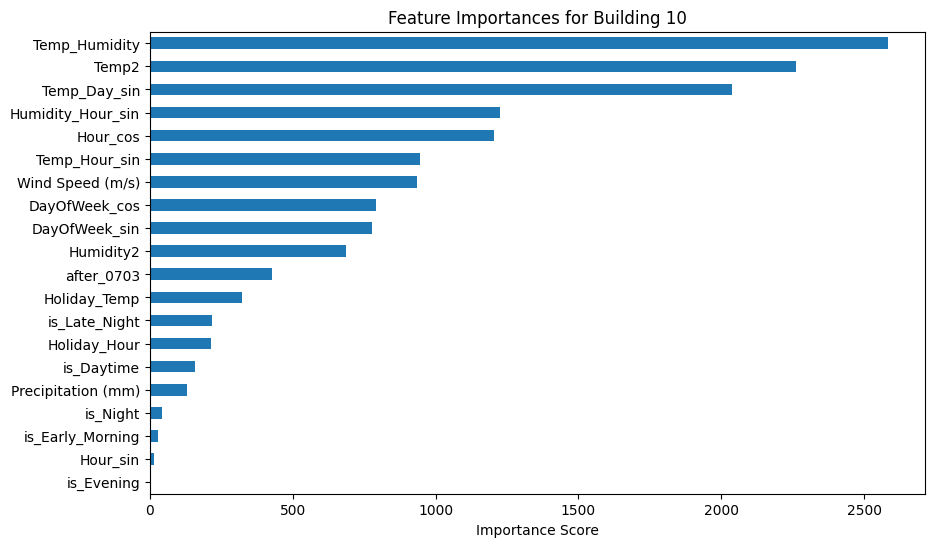

In [151]:
import numpy as np
import pandas as pd
import lightgbm as lgb
import matplotlib.pyplot as plt
from sklearn.metrics import mean_absolute_percentage_error
from sklearn.model_selection import train_test_split

# --- SMAPE Function ---
def smape(y_true, y_pred):
    numerator = np.abs(y_pred - y_true)
    denominator = (np.abs(y_true) + np.abs(y_pred)) / 2
    return np.mean(numerator / denominator) * 100

# === Add new time-based features ===

# === Choose one building ===
building_number = 10  # <-- Change this to your building number

bld_train_10 = train[train['Building Number'] == building_number]
bld_train_10['after_6'] = (train['Hour'] >= 9).astype(int)
bld_train_10['after_18'] = (train['Hour'] >= 21).astype(int)
bld_train_10['after_0703'] = (bld_train_10['Datetime'] >= pd.Timestamp("2024-07-03")).astype(int)
bld_train_10['MA_24h'] = bld_train_10['Power Consumption (kWh)'].rolling(24).mean()


# === Features & Target ===
X = bld_train_10[[
     'is_Daytime', 'is_Early_Morning', 'is_Evening', 'is_Late_Night', 'is_Night',
  
'Wind Speed (m/s)', 
    'Precipitation (mm)', 'ESS Storage Capacity (kWh)', 'Solar Power Capacity (kW)',
    'DayOfWeek_sin', 'DayOfWeek_cos',  'Solar_Temp', 
    'Solar_Humidity', 'Solar_Wind', 'Temp_Humidity', 'Temp_Hour_sin', 
    'Temp_Day_sin', 'Humidity_Hour_sin', 'Holiday_Temp',
    'Holiday_Hour', 'Temp2', 'Humidity2', 'Hour_sin', 'Hour_cos', 'after_0703'
]]

y = bld_train_10['Power_MA_3']

# === Train-test split ===
split_index = int(len(X) * 0.8)
X_train, X_val = X.iloc[:split_index], X.iloc[split_index:]
y_train, y_val = y.iloc[:split_index], y.iloc[split_index:]
# === LightGBM Model ===
model = lgb.LGBMRegressor(
    boosting_type='gbdt',
    n_estimators=500,
    learning_rate=0.01,
    num_leaves=31,
  
    random_state=42
)
# Train model
model.fit(X_train, y_train, eval_set=[(X_val, y_val)])

# === Predictions ===
y_pred = model.predict(X_val)

# === Metrics ===
building_smape = smape(y_val.values, y_pred)
building_mape = mean_absolute_percentage_error(y_val, y_pred) * 100

print(f"Building Number: {building_number}")
print(f"SMAPE: {building_smape:.2f}%")
print(f"MAPE: {building_mape:.2f}%")

# === Feature Importances ===
feat_importances = pd.Series(model.feature_importances_, index=X.columns)
plt.figure(figsize=(10, 6))
feat_importances.nlargest(20).sort_values().plot(kind='barh')
plt.title(f'Feature Importances for Building {building_number}')
plt.xlabel('Importance Score')
plt.show()


In [158]:
train.columns

Index(['num_date_time', 'Building Number', 'Datetime', 'Temperature (°C)',
       'Precipitation (mm)', 'Wind Speed (m/s)', 'Humidity (%)',
       'Sunshine Duration (hr)', 'Solar Radiation (MJ/m²)',
       'Power Consumption (kWh)', 'Hour', 'Day', 'Air-conditioned Area (m²)',
       'Total Floor Area (m²)', 'Building Type', 'Solar Power Capacity (kW)',
       'ESS Storage Capacity (kWh)', 'PCS Capacity (kW)', 'DayOfWeek', 'Month',
       'Week', 'is_weekend', 'Hour_sin', 'Hour_cos', 'DayOfWeek_sin',
       'DayOfWeek_cos', 'Day_sin', 'Day_cos', 'Month_sin', 'Month_cos',
       'Week_sin', 'Week_cos', 'is_Daytime', 'is_Early_Morning', 'is_Evening',
       'is_Late_Night', 'is_Night', 'is_rain_light', 'is_rain_moderate',
       'is_rain_heavy', 'is_cold', 'is_mild', 'is_hot', 'is_calm', 'is_breezy',
       'is_windy', 'is_stormy', 'is_low_rad', 'is_medium_rad', 'is_high_rad',
       'is_holiday', 'Solar_Temp', 'Solar_Humidity', 'Solar_Wind',
       'Temp_Humidity', 'Temp_Hour_sin', 'Tem

In [167]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestRegressor
from xgboost import XGBRegressor
from sklearn.metrics import mean_absolute_percentage_error
import lightgbm as lgb

# === SMAPE Function ===
def smape(y_true, y_pred):
    numerator = np.abs(y_pred - y_true)
    denominator = (np.abs(y_true) + np.abs(y_pred)) / 2
    return np.mean(numerator / denominator) * 100

# === Choose Building ===
building_number = 10  # <-- Change this to test another building

bld_train_10 = train[train['Building Number'] == building_number].copy()
bld_train_10['after_6'] = (bld_train_10['Hour'] >= 9).astype(int)
bld_train_10['after_18'] = (bld_train_10['Hour'] >= 21).astype(int)
bld_train_10['after_0703'] = (bld_train_10['Datetime'] >= pd.Timestamp("2024-07-03")).astype(int)
bld_train_10['MA_24h'] = bld_train_10['Power Consumption (kWh)'].rolling(24).mean()

# === Features & Target ===
X = bld_train_10[[
    'is_Daytime', 'is_Early_Morning', 'is_Evening', 'is_Late_Night', 'is_Night',
    'Wind Speed (m/s)', 'Precipitation (mm)', 'ESS Storage Capacity (kWh)', 
    'Solar Power Capacity (kW)', 'DayOfWeek_sin', 'DayOfWeek_cos', 'Solar_Temp', 
    'Solar_Humidity', 'Solar_Wind', 'Temp_Humidity', 'Temp_Hour_sin', 'Temp_Day_sin', 
    'Humidity_Hour_sin', 'Holiday_Temp', 'Holiday_Hour', 'Temp2', 'Humidity2', 
    'Hour_sin', 'Hour_cos', 'after_0703'
]]

y = bld_train_10['Power Consumption (kWh)']

# === Train-Test Split ===
split_index = int(len(X) * 0.8)
X_train, X_val = X.iloc[:split_index], X.iloc[split_index:]
y_train, y_val = y.iloc[:split_index], y.iloc[split_index:]

# =====================================================
# 1. LIGHTGBM MODEL
# =====================================================
lgb_model = lgb.LGBMRegressor(
    boosting_type='gbdt',
    n_estimators=1500,
    learning_rate=0.01,
    num_leaves=31,
    random_state=42
)
lgb_model.fit(X_train, y_train, eval_set=[(X_val, y_val)])

# Predictions
y_pred_lgb = lgb_model.predict(X_val)

# Metrics
lgb_smape = smape(y_val.values, y_pred_lgb)
lgb_mape = mean_absolute_percentage_error(y_val, y_pred_lgb) * 100
print(f"[LightGBM] SMAPE: {lgb_smape:.2f}% | MAPE: {lgb_mape:.2f}%")

# =====================================================
# 2. RANDOM FOREST MODEL
# =====================================================
rf_model = RandomForestRegressor(
    n_estimators=500,
    max_depth=15,
    min_samples_split=5,
    min_samples_leaf=3,
    random_state=42,
    n_jobs=-1
)
rf_model.fit(X_train, y_train)
y_pred_rf = rf_model.predict(X_val)

# Metrics
rf_smape = smape(y_val.values, y_pred_rf)
rf_mape = mean_absolute_percentage_error(y_val, y_pred_rf) * 100
print(f"[RandomForest] SMAPE: {rf_smape:.2f}% | MAPE: {rf_mape:.2f}%")

# =====================================================
# 3. XGBOOST MODEL
# =====================================================
xgb_model = XGBRegressor(
    n_estimators=150,
    learning_rate=0.05,
    max_depth=6,
    subsample=0.8,
    colsample_bytree=0.8,
    random_state=42,
    tree_method='hist',
    n_jobs=-1
)
xgb_model.fit(X_train, y_train, eval_set=[(X_val, y_val)], verbose=False)
y_pred_xgb = xgb_model.predict(X_val)

# Metrics
xgb_smape = smape(y_val.values, y_pred_xgb)
xgb_mape = mean_absolute_percentage_error(y_val, y_pred_xgb) * 100
print(f"[XGBoost] SMAPE: {xgb_smape:.2f}% | MAPE: {xgb_mape:.2f}%")

# =====================================================
# 4. FEATURE IMPORTANCES COMPARISON
# =====================================================
plt.figure(figsize=(15, 6))

# LightGBM
plt.subplot(1, 3, 1)
pd.Series(lgb_model.feature_importances_, index=X.columns).nlargest(10).sort_values().plot(kind='barh')
plt.title("LightGBM Feature Importance")

# Random Forest
plt.subplot(1, 3, 2)
pd.Series(rf_model.feature_importances_, index=X.columns).nlargest(10).sort_values().plot(kind='barh')
plt.title("Random Forest Feature Importance")

# XGBoost
plt.subplot(1, 3, 3)
pd.Series(xgb_model.feature_importances_, index=X.columns).nlargest(10).sort_values().plot(kind='barh')
plt.title("XGBoost Feature Importance")

plt.tight_layout()
plt.show()

# =====================================================
# 5. MODEL COMPARISON SUMMARY
# =====================================================
results = pd.DataFrame({
    "Model": ["LightGBM", "RandomForest", "XGBoost"],
    "SMAPE": [lgb_smape, rf_smape, xgb_smape],
    "MAPE": [lgb_mape, rf_mape, xgb_mape]
})
print("\n=== Model Comparison ===")
print(results)


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007777 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1542
[LightGBM] [Info] Number of data points in the train set: 1632, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 7124.207006


KeyboardInterrupt: 

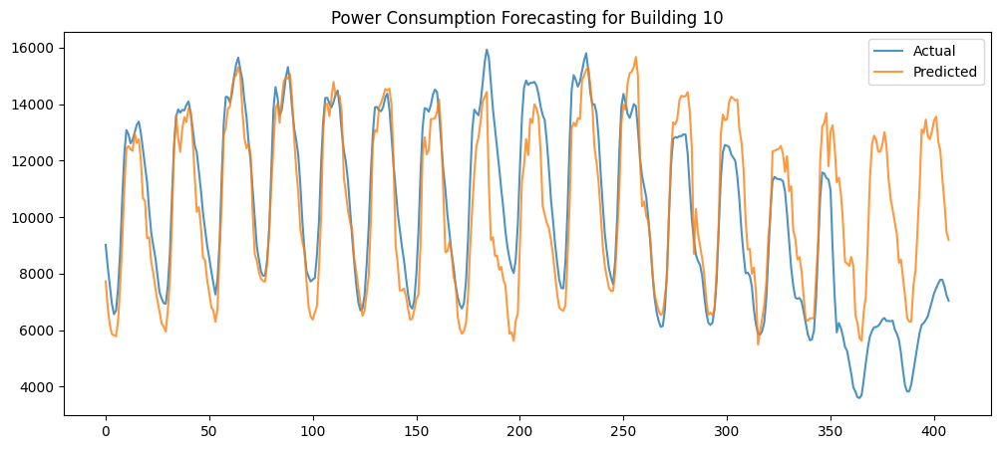

In [166]:
plt.figure(figsize=(12,5))
plt.plot(y_val.values, label="Actual", alpha=0.8)
plt.plot(y_pred, label="Predicted", alpha=0.8)
plt.legend()
plt.title(f"Power Consumption Forecasting for Building {building_number}")
plt.show()

In [124]:
bld_train_10.head()

,num_date_time,Building Number,Datetime,Temperature (°C),Precipitation (mm),Wind Speed (m/s),Humidity (%),Sunshine Duration (hr),Solar Radiation (MJ/m²),Power Consumption (kWh),...,RollingMean_72h,RollingStd_72h,RollingMedian_72h,RollingMean_168h,RollingStd_168h,RollingMedian_168h,EWMA_24h,after_6,after_18,after_0703
18360,10_20240601 00,10,2024-06-01 00:00:00,17.3,0.0,1.1,75.0,0.0,0.0,3577.81,...,NaN,NaN,NaN,NaN,NaN,NaN,3572.085136,0,0,0
18361,10_20240601 01,10,2024-06-01 01:00:00,16.9,0.0,1.0,80.0,0.0,0.0,2866.91,...,NaN,NaN,NaN,NaN,NaN,NaN,3572.579511,0,0,0
18362,10_20240601 02,10,2024-06-01 02:00:00,16.8,0.0,0.9,80.0,0.0,0.0,2810.58,...,NaN,NaN,NaN,NaN,NaN,NaN,3516.125950,0,0,0
18363,10_20240601 03,10,2024-06-01 03:00:00,16.7,0.0,0.9,80.0,0.0,0.0,2984.99,...,NaN,NaN,NaN,NaN,NaN,NaN,3459.682274,0,0,0
18364,10_20240601 04,10,2024-06-01 04:00:00,16.6,0.0,0.6,80.0,0.0,0.0,3076.26,...,NaN,NaN,NaN,NaN,NaN,NaN,3421.706892,0,0,0


In [151]:
import numpy as np
import pandas as pd
import lightgbm as lgb

# --- Assume your model is already trained ---
# model = lgb.LGBMRegressor(...)  # already fitted on training data

building_number = 10

# --- Prepare test set ---
bld_test_10 = test[test['Building Number'] == building_number].copy()
bld_test_10['Datetime'] = pd.to_datetime(bld_test_10['Datetime'])
bld_test_10 = bld_test_10.sort_values('Datetime').reset_index(drop=True)

# --- Add same time-based features as training ---
bld_test_10['after_6'] = (bld_test_10['Hour'] >= 9).astype(int)
bld_test_10['after_18'] = (bld_test_10['Hour'] >= 21).astype(int)
bld_test_10['after_0703'] = (bld_test_10['Datetime'] >= pd.Timestamp("2024-07-03")).astype(int)

# --- Initialize columns ---
bld_test_10['MA_24h'] = np.nan
bld_test_10['Predicted Power Consumption (kWh)'] = np.nan

# --- Seed first 24 MA_24h values from training ---
bld_test_10.loc[:23, 'MA_24h'] = bld_train_10['MA_24h'].tail(24).values

# --- Define features for prediction (must match training features) ---
feature_columns = [
     'is_Daytime', 'is_Early_Morning', 'is_Evening', 'is_Late_Night', 'is_Night',
    'Total Floor Area (m²)', 'Air-conditioned Area (m²)', 
    'is_weekend', 'Wind Speed (m/s)', 
    'Precipitation (mm)', 'ESS Storage Capacity (kWh)', 'Solar Power Capacity (kW)',
    'DayOfWeek_sin', 'DayOfWeek_cos', 'is_holiday', 'Solar_Temp', 
    'Solar_Humidity', 'Solar_Wind', 'Temp_Humidity', 'Temp_Hour_sin', 
    'Temp_Day_sin', 'Humidity_Hour_sin', 'Holiday_Temp', 'Holiday_Solar', 
    'Holiday_Hour', 'Temp2', 'Humidity2', 'Hour_sin', 'Hour_cos', 
     'after_0703', 'MA_24h'
]

# --- Sequential prediction loop ---
for i in range(len(bld_test_10)):
    # Prepare feature row
    X_row = bld_test_10.iloc[i][feature_columns].values.reshape(1, -1)
    
    # Predict power consumption
    pred = model.predict(X_row)[0]
    bld_test_10.at[i, 'Predicted Power Consumption (kWh)'] = pred
    
    # Update MA_24h for next row
    if i + 1 < len(bld_test_10):
        prev_preds_24h = list(bld_test_10['Predicted Power Consumption (kWh)'].iloc[max(0,i-23):i+1])
        bld_test_10.at[i+1, 'MA_24h'] = np.mean(prev_preds_24h)

# --- Save predictions ---
bld_test_10.to_csv("building_10_predictions.csv", index=False)

# --- Optional: check predictions ---
bld_test_10[['Datetime', 'Predicted Power Consumption (kWh)', 'MA_24h']].head(20)


c:\Users\Dell\Downloads\open\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
c:\Users\Dell\Downloads\open\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
c:\Users\Dell\Downloads\open\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
c:\Users\Dell\Downloads\open\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
c:\Users\Dell\Downloads\open\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warni

,Datetime,Predicted Power Consumption (kWh),MA_24h
0,2024-08-25 00:00:00,5019.714121,5441.102917
1,2024-08-25 01:00:00,4560.071934,5019.714121
2,2024-08-25 02:00:00,4321.747119,4789.893028
3,2024-08-25 03:00:00,3928.630682,4633.844391
4,2024-08-25 04:00:00,3712.323040,4457.540964
5,2024-08-25 05:00:00,3655.025303,4308.497379
6,2024-08-25 06:00:00,3370.080983,4199.585367
7,2024-08-25 07:00:00,4246.360143,4081.084740
8,2024-08-25 08:00:00,4617.546263,4101.744166
9,2024-08-25 09:00:00,5705.857230,4159.055510


# Building # 100


Top correlations with Power Consumption:
Power Consumption (kWh)    1.000000
EWMA_24h                   0.571679
RollingMean_24h            0.550826
RollingMedian_24h          0.544661
RollingMedian_72h          0.532575
                             ...   
Solar_Temp                      NaN
Solar_Humidity                  NaN
Solar_Wind                      NaN
Holiday_Solar                   NaN
Solar2                          NaN
Name: Power Consumption (kWh), Length: 68, dtype: float64


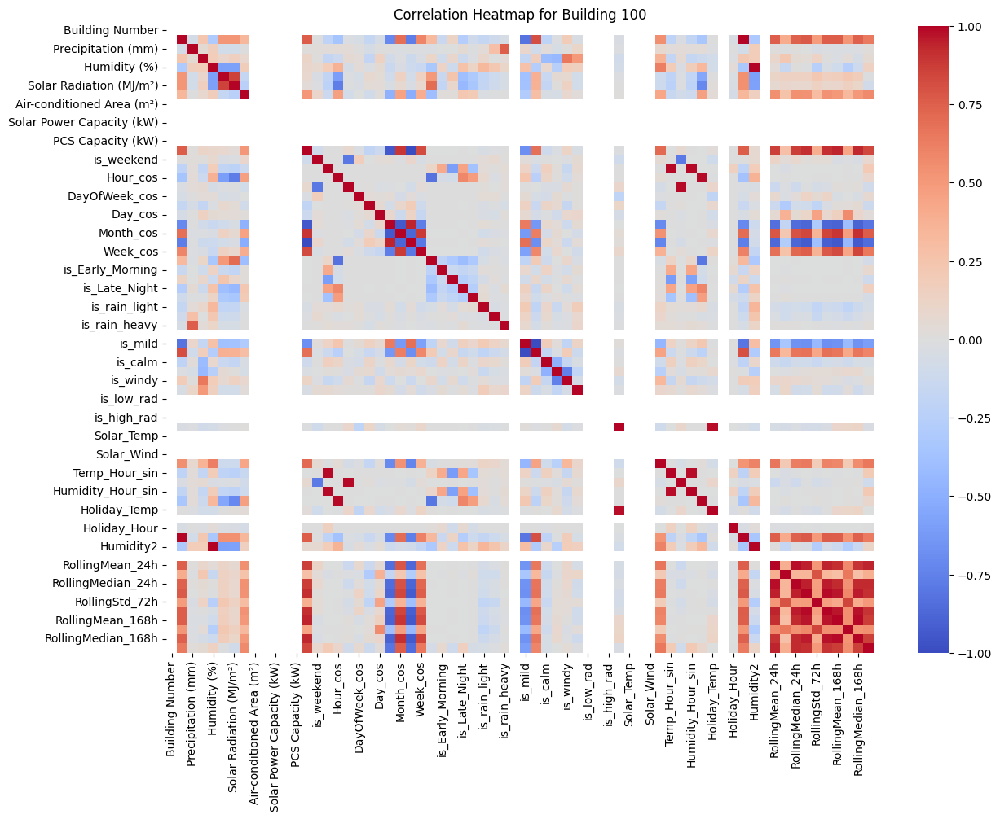

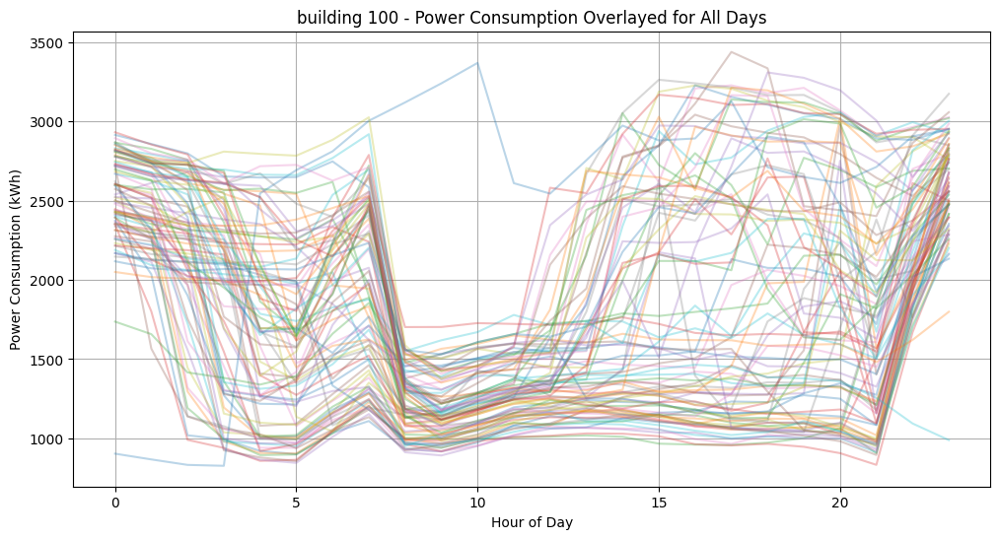

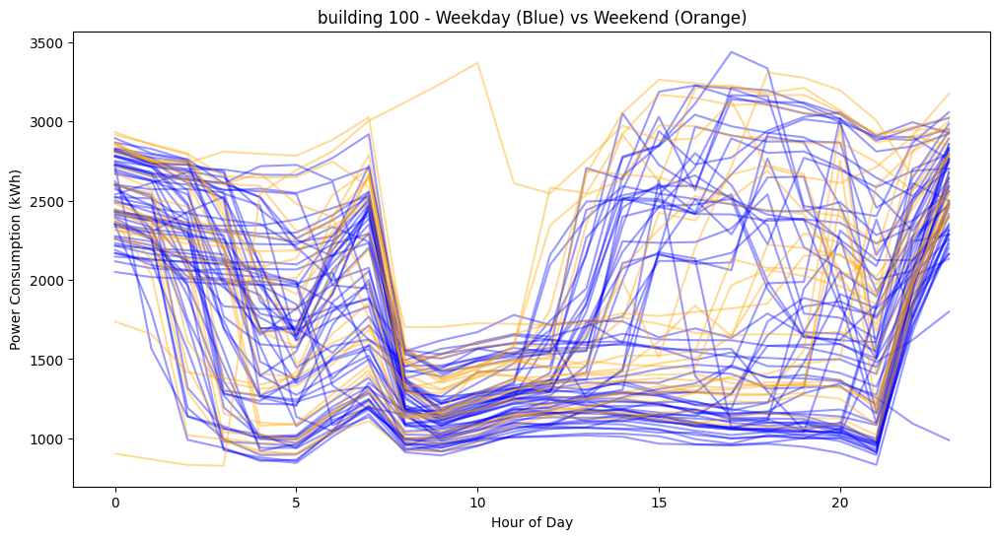

In [62]:
import matplotlib.pyplot as plt
import seaborn as sns
building_number = 100
# Filtered dataset for the selected building
bld_train_100 = train[train['Building Number'] == building_number]

# Select only numeric columns for correlation
numeric_cols = bld_train_100.select_dtypes(include=['float64', 'int64'])

# Compute correlation matrix
corr_matrix = numeric_cols.corr()

# Display top correlations with the target variable
target_corr = corr_matrix['Power Consumption (kWh)'].sort_values(ascending=False)
print("\nTop correlations with Power Consumption:")
print(target_corr)

# === Heatmap Visualization ===
plt.figure(figsize=(14, 10))
sns.heatmap(corr_matrix, annot=False, cmap="coolwarm", center=0)
plt.title(f"Correlation Heatmap for Building {building_number}")
plt.show()
import matplotlib.pyplot as plt

building_100 = train[train["Building Number"] == building_number].copy()
building_100["Datetime"] = pd.to_datetime(building_100["Datetime"])
building_100["Hour"] = building_100["Datetime"].dt.hour
building_100["Date"] = building_100["Datetime"].dt.date

plt.figure(figsize=(12, 6))
for date in building_100["Date"].unique():
    day_data = building_100[building_100["Date"] == date]
    plt.plot(day_data["Hour"], day_data["Power Consumption (kWh)"], alpha=0.3)

plt.title("building 100 - Power Consumption Overlayed for All Days")
plt.xlabel("Hour of Day")
plt.ylabel("Power Consumption (kWh)")
plt.grid(True)
plt.show()
import matplotlib.pyplot as plt

building_100 = train[train["Building Number"] == building_number].copy()
building_100["Datetime"] = pd.to_datetime(building_100["Datetime"])
building_100["DayOfWeek"] = building_100["Datetime"].dt.dayofweek
building_100["is_weekend"] = building_100["DayOfWeek"] >= 5
plt.figure(figsize=(12, 6))
for day in building_100[~building_100["is_weekend"]]["Datetime"].dt.date.unique():
    daily = building_100[building_100["Datetime"].dt.date == day]
    plt.plot(daily["Hour"], daily["Power Consumption (kWh)"], alpha=0.4, color="blue")
for day in building_100[building_100["is_weekend"]]["Datetime"].dt.date.unique():
    daily = building_100[building_100["Datetime"].dt.date == day]
    plt.plot(daily["Hour"], daily["Power Consumption (kWh)"], alpha=0.4, color="orange")

plt.title("building 100 - Weekday (Blue) vs Weekend (Orange)")
plt.xlabel("Hour of Day")
plt.ylabel("Power Consumption (kWh)")
plt.show()



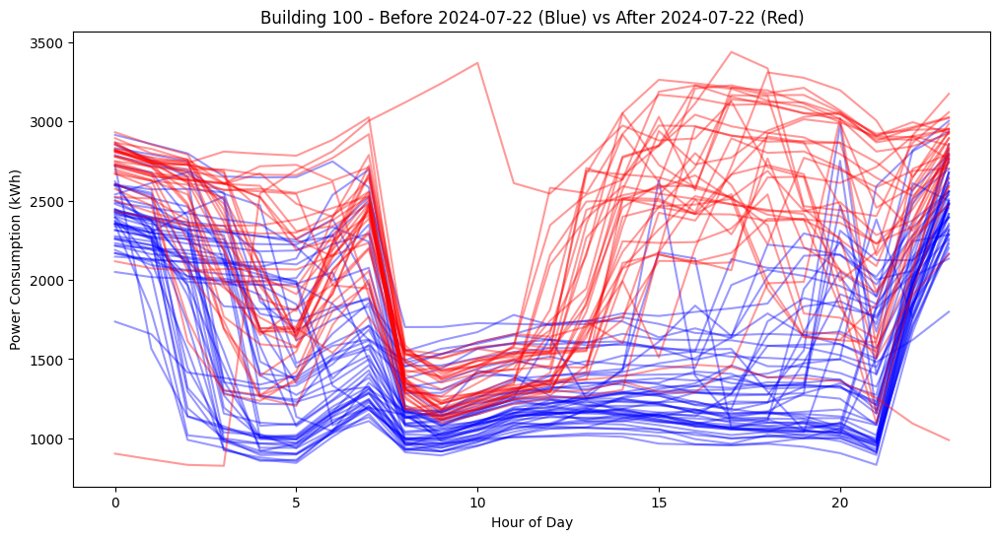

In [95]:
import matplotlib.pyplot as plt

# Filter for building 100
building_100 = train[train["Building Number"] == building_number].copy()
building_100["Datetime"] = pd.to_datetime(building_100["Datetime"])

# Define cutoff date
cutoff_date = pd.Timestamp("2024-07-22")

# Plot
plt.figure(figsize=(12, 6))

# Before cutoff
for day in building_100[building_100["Datetime"] < cutoff_date]["Datetime"].dt.date.unique():
    daily = building_100[building_100["Datetime"].dt.date == day]
    plt.plot(daily["Hour"], daily["Power Consumption (kWh)"], alpha=0.4, color="blue")

# After cutoff
for day in building_100[building_100["Datetime"] >= cutoff_date]["Datetime"].dt.date.unique():
    daily = building_100[building_100["Datetime"].dt.date == day]
    plt.plot(daily["Hour"], daily["Power Consumption (kWh)"], alpha=0.4, color="red")

plt.title(f"Building {building_number} - Before 2024-07-22 (Blue) vs After 2024-07-22 (Red)")
plt.xlabel("Hour of Day")
plt.ylabel("Power Consumption (kWh)")
plt.show()


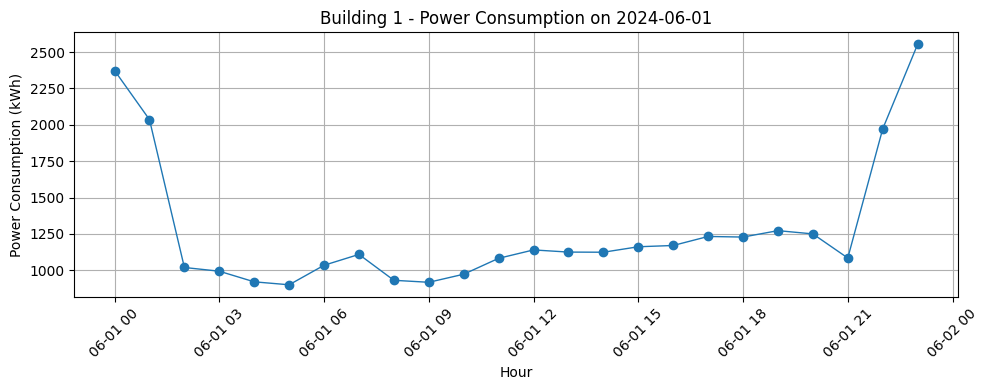

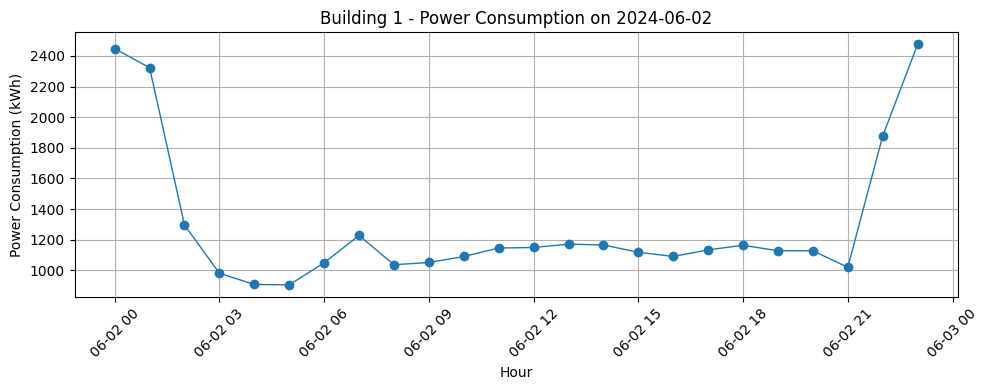

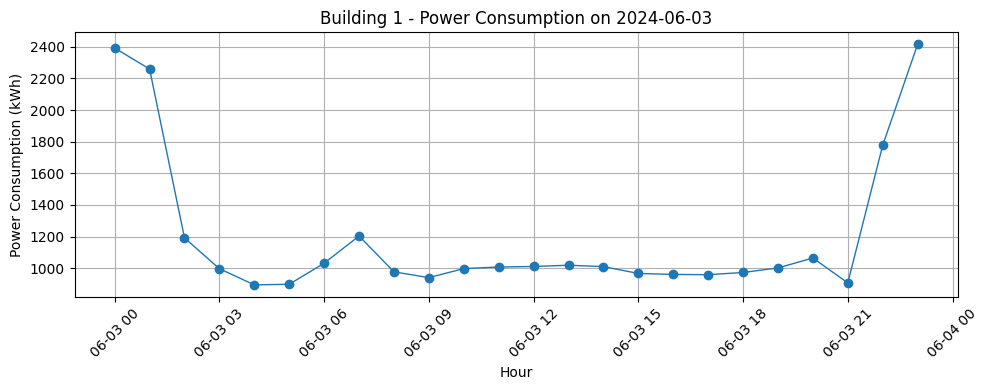

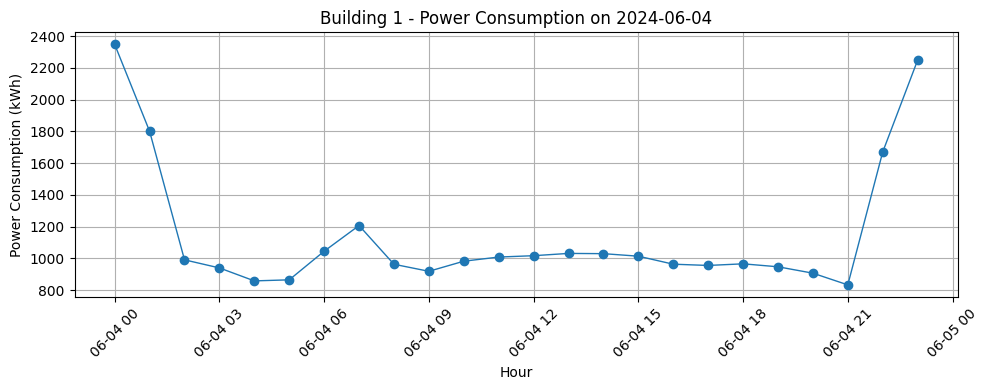

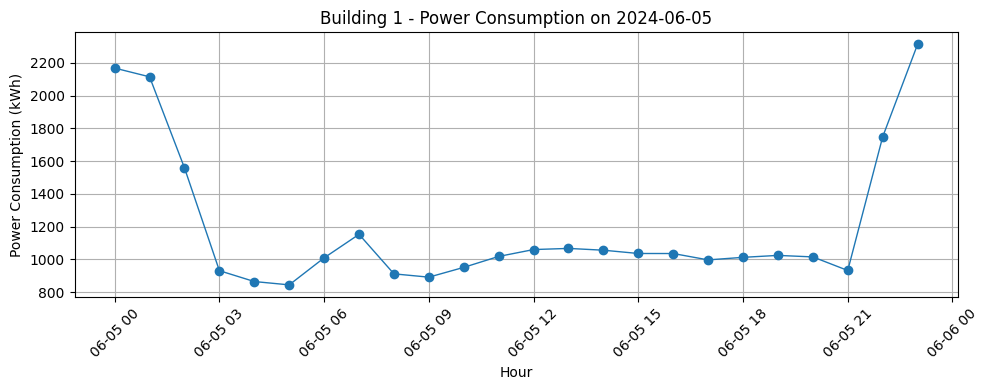

...

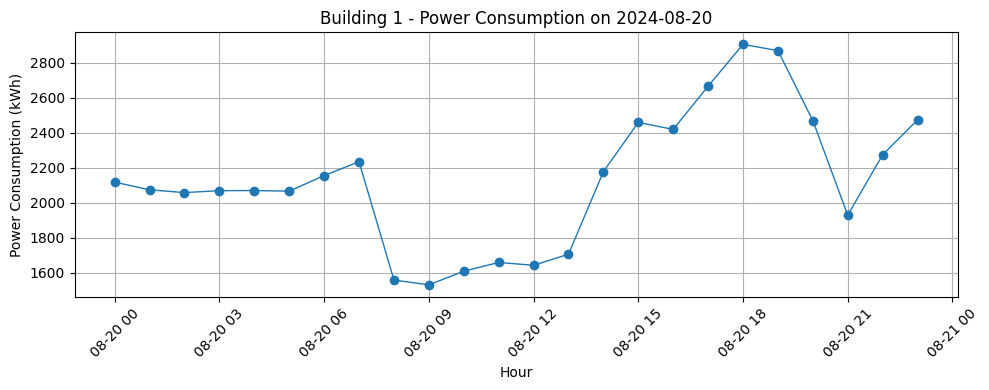

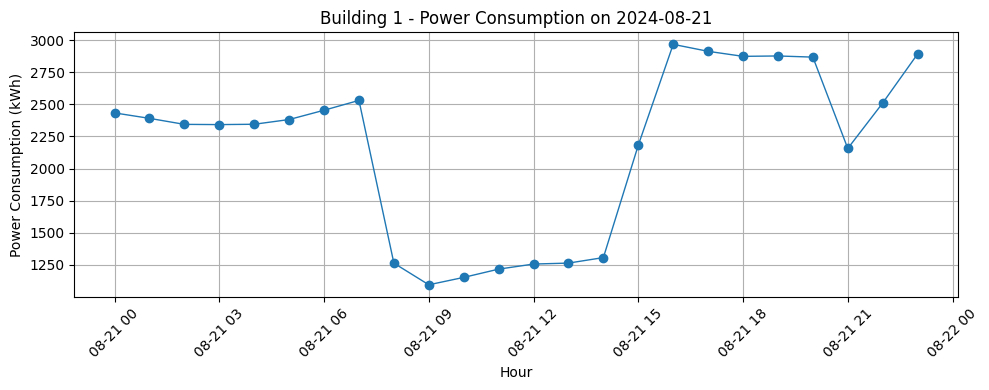

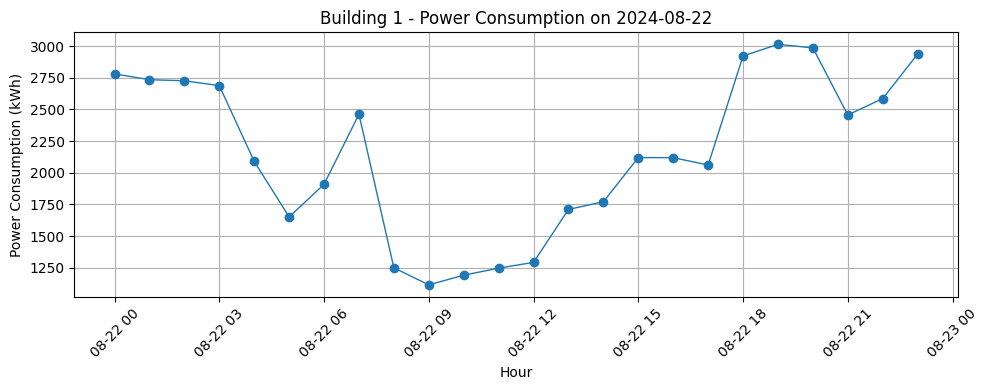

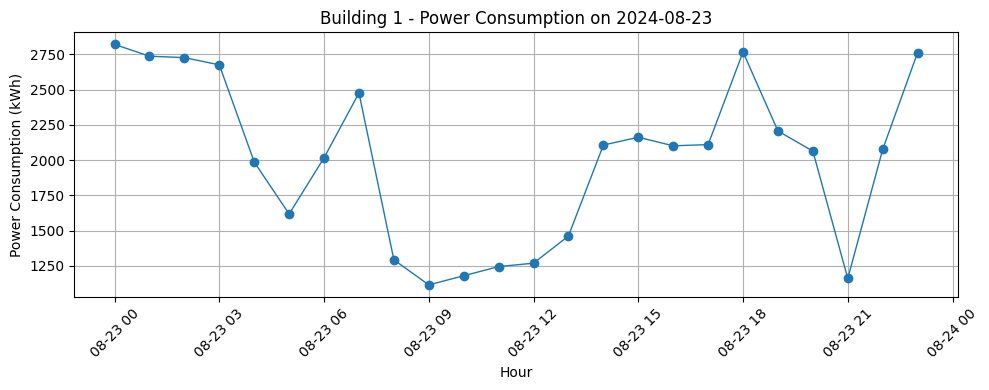

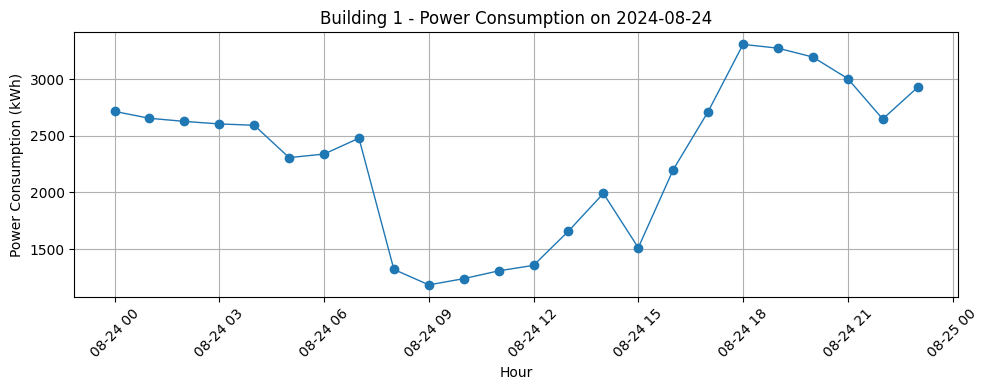

In [63]:
import matplotlib.pyplot as plt
import pandas as pd

# Filter data for Building 1
building_1 = train[train["Building Number"] == building_number].copy()

# Convert to datetime properly (VERY important)
building_1["Datetime"] = pd.to_datetime(building_1["Datetime"], errors="coerce")

# Sort by datetime
building_1 = building_1.sort_values("Datetime")

# Extract date (YYYY-MM-DD) from datetime
building_1["Date"] = building_1["Datetime"].dt.date

# Get unique sorted dates
unique_dates = sorted(building_1["Date"].unique())

# Generate separate plots for each day
for date in unique_dates:
    day_data = building_1[building_1["Date"] == date]
    plt.figure(figsize=(10, 4))
    plt.plot(day_data["Datetime"], day_data["Power Consumption (kWh)"], marker="o", linewidth=1)
    plt.title(f"Building 1 - Power Consumption on {date}")
    plt.xlabel("Hour")
    plt.ylabel("Power Consumption (kWh)")
    plt.xticks(rotation=45)
    plt.grid(True)
    plt.tight_layout()
    plt.show()

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000204 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1854
[LightGBM] [Info] Number of data points in the train set: 1836, number of used features: 27
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 3516.730902
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with po

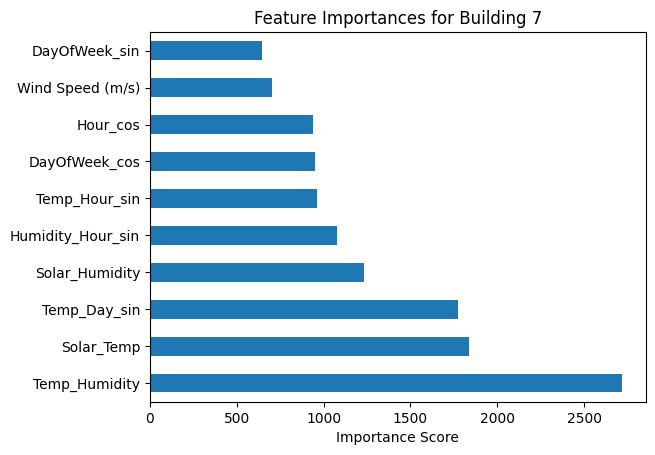

In [ ]:
import numpy as np
import pandas as pd
import lightgbm as lgb
from sklearn.metrics import mean_absolute_percentage_error
from sklearn.model_selection import train_test_split
from sklearn.model_selection import TimeSeriesSplit

# --- SMAPE Function ---
def smape(y_true, y_pred):
    numerator = np.abs(y_pred - y_true)
    denominator = (np.abs(y_true) + np.abs(y_pred)) / 2
    return np.mean(numerator / denominator) * 100

# === Choose one building ===
 # <-- Change this to your building number

# Filter data for this building

# === Features & Target ===
X = bld_train_7[[
    'Total Floor Area (m²)', 'Air-conditioned Area (m²)', 
    'Wind Speed (m/s)', 'is_Daytime', 'is_Early_Morning', 'is_Late_Night',
    'is_Night', 'is_Evening',
    'Precipitation (mm)', 'ESS Storage Capacity (kWh)', 'Solar Power Capacity (kW)',
    'DayOfWeek_sin', 'DayOfWeek_cos', 'is_holiday', 'Solar_Temp', 
    'Solar_Humidity', 'Solar_Wind', 'Temp_Humidity', 'Temp_Hour_sin', 
    'Temp_Day_sin', 'Humidity_Hour_sin', 'Holiday_Temp', 'Holiday_Solar', 
    'Holiday_Hour', 'Temp2', 'Humidity2', 'Hour_sin', 'Hour_cos', 
    'is_low_period', 'is_medium_period', 'is_high_period'
]]  # Drop rows with NaNs to avoid issues

y = bld_train_7.loc[X.index, 'Power_MA_3'] 

# === Time-series split (replace train_test_split) ===
# === Train-test split ===
split_index = int(len(X) * 0.9)
X_train, X_val = X.iloc[:split_index], X.iloc[split_index:]
y_train, y_val = y.iloc[:split_index], y.iloc[split_index:]
# === LightGBM Model ===
model = lgb.LGBMRegressor(
    boosting_type='gbdt',
    n_estimators=600,
    learning_rate=0.01,
    num_leaves=31,  # Reduced from 64 to match your latest context
    max_depth=-1,
    min_child_samples=50,
    subsample=0.8,
    colsample_bytree=0.8,
    reg_alpha=0.1,
    reg_lambda=0.1,
    random_state=42
)

# Train model with early stopping
model.fit(X_train, y_train, eval_set=[(X_val, y_val)],)

# === Predictions ===
y_pred = model.predict(X_val)

# === Metrics ===
building_smape = smape(y_val.values, y_pred)
building_mape = mean_absolute_percentage_error(y_val, y_pred) * 100

print(f"Building Number: {building_number}")
print(f"SMAPE: {building_smape:.2f}%")
print(f"MAPE: {building_mape:.2f}%")

# === Feature Importances ===
feat_importances = pd.Series(model.feature_importances_, index=X.columns)
feat_importances.nlargest(10).plot(kind='barh')
plt.title(f'Feature Importances for Building {building_number}')
plt.xlabel('Importance Score')
plt.show()


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000204 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1854
[LightGBM] [Info] Number of data points in the train set: 1836, number of used features: 27
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 3516.730902
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with po

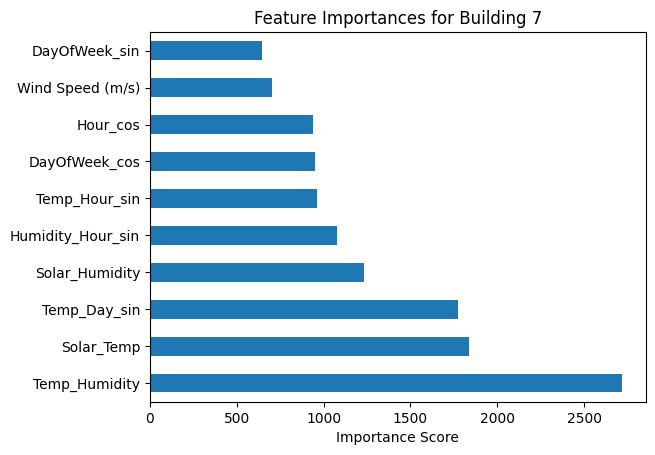

In [ ]:
import numpy as np
import pandas as pd
import lightgbm as lgb
from sklearn.metrics import mean_absolute_percentage_error
from sklearn.model_selection import train_test_split
from sklearn.model_selection import TimeSeriesSplit

# --- SMAPE Function ---
def smape(y_true, y_pred):
    numerator = np.abs(y_pred - y_true)
    denominator = (np.abs(y_true) + np.abs(y_pred)) / 2
    return np.mean(numerator / denominator) * 100

# === Choose one building ===
 # <-- Change this to your building number

# Filter data for this building

# === Features & Target ===
X = bld_train_7[[
    'Total Floor Area (m²)', 'Air-conditioned Area (m²)', 
    'Wind Speed (m/s)', 'is_Daytime', 'is_Early_Morning', 'is_Late_Night',
    'is_Night', 'is_Evening',
    'Precipitation (mm)', 'ESS Storage Capacity (kWh)', 'Solar Power Capacity (kW)',
    'DayOfWeek_sin', 'DayOfWeek_cos', 'is_holiday', 'Solar_Temp', 
    'Solar_Humidity', 'Solar_Wind', 'Temp_Humidity', 'Temp_Hour_sin', 
    'Temp_Day_sin', 'Humidity_Hour_sin', 'Holiday_Temp', 'Holiday_Solar', 
    'Holiday_Hour', 'Temp2', 'Humidity2', 'Hour_sin', 'Hour_cos', 
    'is_low_period', 'is_medium_period', 'is_high_period'
]]  # Drop rows with NaNs to avoid issues

y = bld_train_7.loc[X.index, 'Power_MA_3'] 

# === Time-series split (replace train_test_split) ===
# === Train-test split ===
split_index = int(len(X) * 0.9)
X_train, X_val = X.iloc[:split_index], X.iloc[split_index:]
y_train, y_val = y.iloc[:split_index], y.iloc[split_index:]
# === LightGBM Model ===
model = lgb.LGBMRegressor(
    boosting_type='gbdt',
    n_estimators=600,
    learning_rate=0.01,
    num_leaves=31,  # Reduced from 64 to match your latest context
    max_depth=-1,
    min_child_samples=50,
    subsample=0.8,
    colsample_bytree=0.8,
    reg_alpha=0.1,
    reg_lambda=0.1,
    random_state=42
)

# Train model with early stopping
model.fit(X_train, y_train, eval_set=[(X_val, y_val)],)

# === Predictions ===
y_pred = model.predict(X_val)

# === Metrics ===
building_smape = smape(y_val.values, y_pred)
building_mape = mean_absolute_percentage_error(y_val, y_pred) * 100

print(f"Building Number: {building_number}")
print(f"SMAPE: {building_smape:.2f}%")
print(f"MAPE: {building_mape:.2f}%")

# === Feature Importances ===
feat_importances = pd.Series(model.feature_importances_, index=X.columns)
feat_importances.nlargest(10).plot(kind='barh')
plt.title(f'Feature Importances for Building {building_number}')
plt.xlabel('Importance Score')
plt.show()


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000204 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1854
[LightGBM] [Info] Number of data points in the train set: 1836, number of used features: 27
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 3516.730902
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with po

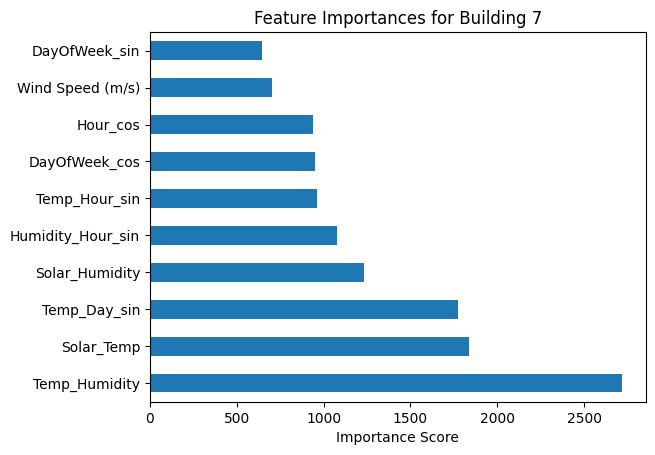

In [ ]:
import numpy as np
import pandas as pd
import lightgbm as lgb
from sklearn.metrics import mean_absolute_percentage_error
from sklearn.model_selection import train_test_split
from sklearn.model_selection import TimeSeriesSplit

# --- SMAPE Function ---
def smape(y_true, y_pred):
    numerator = np.abs(y_pred - y_true)
    denominator = (np.abs(y_true) + np.abs(y_pred)) / 2
    return np.mean(numerator / denominator) * 100

# === Choose one building ===
 # <-- Change this to your building number

# Filter data for this building

# === Features & Target ===
X = bld_train_7[[
    'Total Floor Area (m²)', 'Air-conditioned Area (m²)', 
    'Wind Speed (m/s)', 'is_Daytime', 'is_Early_Morning', 'is_Late_Night',
    'is_Night', 'is_Evening',
    'Precipitation (mm)', 'ESS Storage Capacity (kWh)', 'Solar Power Capacity (kW)',
    'DayOfWeek_sin', 'DayOfWeek_cos', 'is_holiday', 'Solar_Temp', 
    'Solar_Humidity', 'Solar_Wind', 'Temp_Humidity', 'Temp_Hour_sin', 
    'Temp_Day_sin', 'Humidity_Hour_sin', 'Holiday_Temp', 'Holiday_Solar', 
    'Holiday_Hour', 'Temp2', 'Humidity2', 'Hour_sin', 'Hour_cos', 
    'is_low_period', 'is_medium_period', 'is_high_period'
]]  # Drop rows with NaNs to avoid issues

y = bld_train_7.loc[X.index, 'Power_MA_3'] 

# === Time-series split (replace train_test_split) ===
# === Train-test split ===
split_index = int(len(X) * 0.9)
X_train, X_val = X.iloc[:split_index], X.iloc[split_index:]
y_train, y_val = y.iloc[:split_index], y.iloc[split_index:]
# === LightGBM Model ===
model = lgb.LGBMRegressor(
    boosting_type='gbdt',
    n_estimators=600,
    learning_rate=0.01,
    num_leaves=31,  # Reduced from 64 to match your latest context
    max_depth=-1,
    min_child_samples=50,
    subsample=0.8,
    colsample_bytree=0.8,
    reg_alpha=0.1,
    reg_lambda=0.1,
    random_state=42
)

# Train model with early stopping
model.fit(X_train, y_train, eval_set=[(X_val, y_val)],)

# === Predictions ===
y_pred = model.predict(X_val)

# === Metrics ===
building_smape = smape(y_val.values, y_pred)
building_mape = mean_absolute_percentage_error(y_val, y_pred) * 100

print(f"Building Number: {building_number}")
print(f"SMAPE: {building_smape:.2f}%")
print(f"MAPE: {building_mape:.2f}%")

# === Feature Importances ===
feat_importances = pd.Series(model.feature_importances_, index=X.columns)
feat_importances.nlargest(10).plot(kind='barh')
plt.title(f'Feature Importances for Building {building_number}')
plt.xlabel('Importance Score')
plt.show()


In [126]:
train.columns

Index(['num_date_time', 'Building Number', 'Datetime', 'Temperature (°C)',
       'Precipitation (mm)', 'Wind Speed (m/s)', 'Humidity (%)',
       'Sunshine Duration (hr)', 'Solar Radiation (MJ/m²)',
       'Power Consumption (kWh)', 'Hour', 'Day', 'Air-conditioned Area (m²)',
       'Total Floor Area (m²)', 'Building Type', 'Solar Power Capacity (kW)',
       'ESS Storage Capacity (kWh)', 'PCS Capacity (kW)', 'DayOfWeek', 'Month',
       'Week', 'is_weekend', 'Hour_sin', 'Hour_cos', 'DayOfWeek_sin',
       'DayOfWeek_cos', 'Day_sin', 'Day_cos', 'Month_sin', 'Month_cos',
       'Week_sin', 'Week_cos', 'is_Daytime', 'is_Early_Morning', 'is_Evening',
       'is_Late_Night', 'is_Night', 'is_rain_light', 'is_rain_moderate',
       'is_rain_heavy', 'is_cold', 'is_mild', 'is_hot', 'is_calm', 'is_breezy',
       'is_windy', 'is_stormy', 'is_low_rad', 'is_medium_rad', 'is_high_rad',
       'is_holiday', 'Solar_Temp', 'Solar_Humidity', 'Solar_Wind',
       'Temp_Humidity', 'Temp_Hour_sin', 'Tem

C:\Users\Dell\AppData\Local\Temp\ipykernel_19016\1755057937.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  bld_train_100['after_6'] = (bld_train_100['Hour'] >= 8).astype(int)
C:\Users\Dell\AppData\Local\Temp\ipykernel_19016\1755057937.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  bld_train_100['after_18'] = (bld_train_100['Hour'] >= 18).astype(int)
C:\Users\Dell\AppData\Local\Temp\ipykernel_19016\1755057937.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000184 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1683
[LightGBM] [Info] Number of data points in the train set: 1734, number of used features: 18
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 1748.811903
Building Number: 100
SMAPE: 7.15%
MAPE: 7.24%


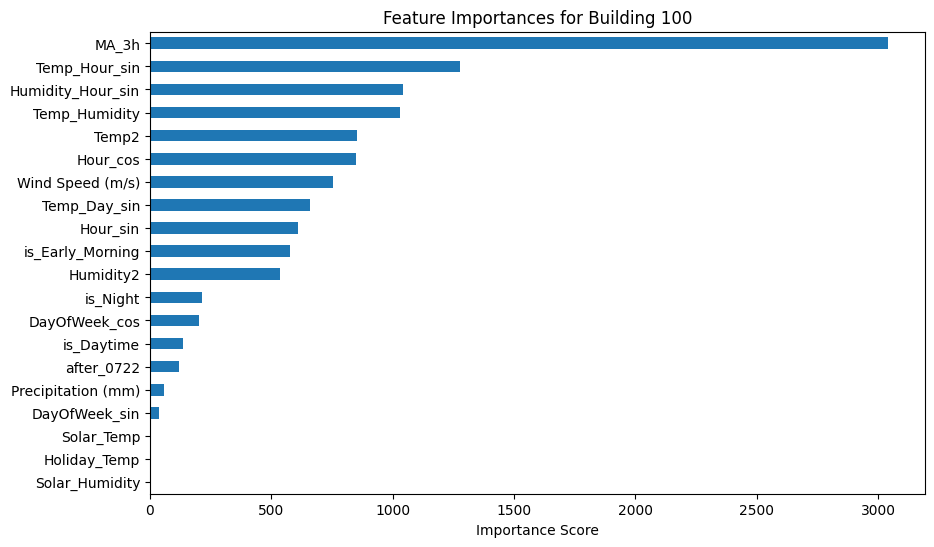

In [145]:
import numpy as np
import pandas as pd
import lightgbm as lgb
import matplotlib.pyplot as plt
from sklearn.metrics import mean_absolute_percentage_error
from sklearn.model_selection import train_test_split

# --- SMAPE Function ---
def smape(y_true, y_pred):
    numerator = np.abs(y_pred - y_true)
    denominator = (np.abs(y_true) + np.abs(y_pred)) / 2
    return np.mean(numerator / denominator) * 100

# === Add new time-based features ===

# === Choose one building ===
building_number = 100  # <-- Change this to your building number

bld_train_100 = train[train['Building Number'] == building_number]
bld_train_100['after_6'] = (bld_train_100['Hour'] >= 8).astype(int)
bld_train_100['after_18'] = (bld_train_100['Hour'] >= 18).astype(int)
# bld_train_100['pre_july'] = (bld_train_100['Datetime'].dt.month < 7).astype(int)
# bld_train_100['after_july'] = (bld_train_100['Datetime'].dt.month >= 7).astype(int)
bld_train_100['MA_24h'] = bld_train_100['Power Consumption (kWh)'].rolling(24).mean()
bld_train_100['MA_3h'] = bld_train_100['Power Consumption (kWh)'].rolling(3).mean()
bld_train_100['after_0722'] = (bld_train_100['Datetime'] >= pd.Timestamp("2024-07-22")).astype(int)


# === Features & Target ===
X = bld_train_100[[
     'is_Daytime', 'is_Early_Morning',  'is_Night',
    'Wind Speed (m/s)', 
    'Precipitation (mm)', 
    'DayOfWeek_sin', 'DayOfWeek_cos', 'Solar_Temp', 
    'Solar_Humidity', 'Temp_Humidity', 'Temp_Hour_sin', 
    'Temp_Day_sin', 'Humidity_Hour_sin', 'Holiday_Temp', 'Holiday_Solar', 
    'Holiday_Hour', 'Temp2', 'Humidity2', 'Hour_sin', 'Hour_cos', 
  'after_0722', 'MA_3h',
]]

y = bld_train_100['Power Consumption (kWh)']

# === Train-test split ===
split_index = int(len(X) * 0.85)
X_train, X_val = X.iloc[:split_index], X.iloc[split_index:]
y_train, y_val = y.iloc[:split_index], y.iloc[split_index:]
# === LightGBM Model ===
model = lgb.LGBMRegressor(
    boosting_type='gbdt',
    n_estimators=400,
    learning_rate=0.01,
    num_leaves=31,
    random_state=42
)
# Train model
model.fit(X_train, y_train, eval_set=[(X_val, y_val)])

# === Predictions ===
y_pred = model.predict(X_val)

# === Metrics ===
building_smape = smape(y_val.values, y_pred)
building_mape = mean_absolute_percentage_error(y_val, y_pred) * 100

print(f"Building Number: {building_number}")
print(f"SMAPE: {building_smape:.2f}%")
print(f"MAPE: {building_mape:.2f}%")

# === Feature Importances ===
feat_importances = pd.Series(model.feature_importances_, index=X.columns)
plt.figure(figsize=(10, 6))
feat_importances.nlargest(20).sort_values().plot(kind='barh')
plt.title(f'Feature Importances for Building {building_number}')
plt.xlabel('Importance Score')
plt.show()


In [125]:
bld_train_100.tail()

,num_date_time,Building Number,Datetime,Temperature (°C),Precipitation (mm),Wind Speed (m/s),Humidity (%),Sunshine Duration (hr),Solar Radiation (MJ/m²),Power Consumption (kWh),...,RollingStd_72h,RollingMedian_72h,RollingMean_168h,RollingStd_168h,RollingMedian_168h,EWMA_24h,after_6,after_18,MA_24h,after_0722
203995,100_20240824 19,100,2024-08-24 19:00:00,29.1,0.0,4.4,76.0,0.4,0.18,3276.00,...,617.191181,2138.04,2149.600714,581.092268,2177.46,2084.085106,1,1,2144.115,1
203996,100_20240824 20,100,2024-08-24 20:00:00,28.6,0.0,3.7,74.0,0.0,0.00,3197.52,...,625.735496,2138.04,2153.221429,586.212438,2177.46,2179.438298,1,1,2191.340,1
203997,100_20240824 21,100,2024-08-24 21:00:00,28.3,0.0,2.9,74.0,0.0,0.00,3006.60,...,632.348965,2138.04,2160.380000,591.585696,2179.74,2260.884834,1,1,2268.235,1
203998,100_20240824 22,100,2024-08-24 22:00:00,28.0,0.0,1.7,76.0,0.0,0.00,2649.72,...,640.534424,2141.22,2165.313571,595.176692,2191.50,2320.542047,1,1,2292.125,1
203999,100_20240824 23,100,2024-08-24 23:00:00,28.0,0.0,2.1,75.0,0.0,0.00,2929.32,...,641.843194,2141.22,2163.756429,593.553245,2191.50,2346.876283,1,1,2299.045,1


In [149]:
import numpy as np
import pandas as pd
import lightgbm as lgb

# --- Assume your model is already trained ---
# model = lgb.LGBMRegressor(...)  # already fitted on training data

# --- Prepare test set for Building 100 ---
building_number = 100
bld_test_100 = test[test['Building Number'] == building_number].copy()
bld_test_100['Datetime'] = pd.to_datetime(bld_test_100['Datetime'])
bld_test_100 = bld_test_100.sort_values('Datetime').reset_index(drop=True)

# --- Add same time-based features as training ---
bld_test_100['after_6'] = (bld_test_100['Hour'] >= 8).astype(int)
bld_test_100['after_18'] = (bld_test_100['Hour'] >= 18).astype(int)
bld_test_100['after_0722'] = (bld_test_100['Datetime'] >= pd.Timestamp("2024-07-22")).astype(int)

# --- Initialize columns ---
bld_test_100['MA_3h'] = np.nan
bld_test_100['Predicted Power Consumption (kWh)'] = np.nan

# --- Seed first 3 MA_3h values from training ---
bld_test_100.loc[:2, 'MA_3h'] = bld_train_100['MA_3h'].tail(3).values

# --- Define features used for prediction (must match training features) ---
feature_columns = [
     'is_Daytime', 'is_Early_Morning',  'is_Night',
    'Wind Speed (m/s)', 
    'Precipitation (mm)', 
    'DayOfWeek_sin', 'DayOfWeek_cos', 'Solar_Temp', 
    'Solar_Humidity', 'Temp_Humidity', 'Temp_Hour_sin', 
    'Temp_Day_sin', 'Humidity_Hour_sin', 'Holiday_Temp', 'Holiday_Solar', 
    'Holiday_Hour', 'Temp2', 'Humidity2', 'Hour_sin', 'Hour_cos', 
  'after_0722', 'MA_3h',
]

# --- If MA_24h is used in training, initialize it similarly ---
bld_test_100['MA_24h'] = np.nan
bld_test_100.loc[:23, 'MA_24h'] = bld_train_100['MA_24h'].tail(24).values

# --- Sequential prediction loop ---
for i in range(len(bld_test_100)):
    # Prepare feature row
    X_row = bld_test_100.iloc[i][feature_columns].values.reshape(1, -1)
    
    # Predict power consumption
    pred = model.predict(X_row)[0]
    bld_test_100.at[i, 'Predicted Power Consumption (kWh)'] = pred
    
    # Update MA_3h for next row
    if i + 1 < len(bld_test_100):
        prev_preds = list(bld_test_100['Predicted Power Consumption (kWh)'].iloc[max(0,i-2):i+1])
        bld_test_100.at[i+1, 'MA_3h'] = np.mean(prev_preds)
    
    # Update MA_24h for next row if needed
    if i + 1 < len(bld_test_100):
        prev_preds_24h = list(bld_test_100['Predicted Power Consumption (kWh)'].iloc[max(0,i-23):i+1])
        bld_test_100.at[i+1, 'MA_24h'] = np.mean(prev_preds_24h)

# --- Save predictions ---
bld_test_100.to_csv("building_100_predictions.csv", index=False)

# --- Optional: check predictions ---
bld_test_100[['Datetime', 'Predicted Power Consumption (kWh)', 'MA_3h', 'MA_24h']].head(20)


c:\Users\Dell\Downloads\open\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
c:\Users\Dell\Downloads\open\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
c:\Users\Dell\Downloads\open\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
c:\Users\Dell\Downloads\open\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
c:\Users\Dell\Downloads\open\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warni

,Datetime,Predicted Power Consumption (kWh),MA_3h,MA_24h
0,2024-08-25 00:00:00,2960.220762,3160.040000,2001.840000
1,2024-08-25 01:00:00,2857.670365,2960.220762,2960.220762
2,2024-08-25 02:00:00,2779.070671,2908.945563,2908.945563
3,2024-08-25 03:00:00,2760.363673,2865.653932,2865.653932
4,2024-08-25 04:00:00,2735.574852,2799.034903,2839.331368
5,2024-08-25 05:00:00,2687.341608,2758.336399,2818.580064
6,2024-08-25 06:00:00,2730.655683,2727.760045,2796.706988
7,2024-08-25 07:00:00,2704.288385,2717.857381,2787.271088
8,2024-08-25 08:00:00,2623.096857,2707.428559,2776.898250
9,2024-08-25 09:00:00,2603.233854,2686.013642,2759.809206


# Building # 1


Top correlations with Power Consumption:
Power Consumption (kWh)    1.000000
Temp2                      0.485970
Temperature (°C)           0.477923
EWMA_24h                   0.362515
is_Evening                 0.331196
                             ...   
Solar_Temp                      NaN
Solar_Humidity                  NaN
Solar_Wind                      NaN
Holiday_Solar                   NaN
Solar2                          NaN
Name: Power Consumption (kWh), Length: 68, dtype: float64


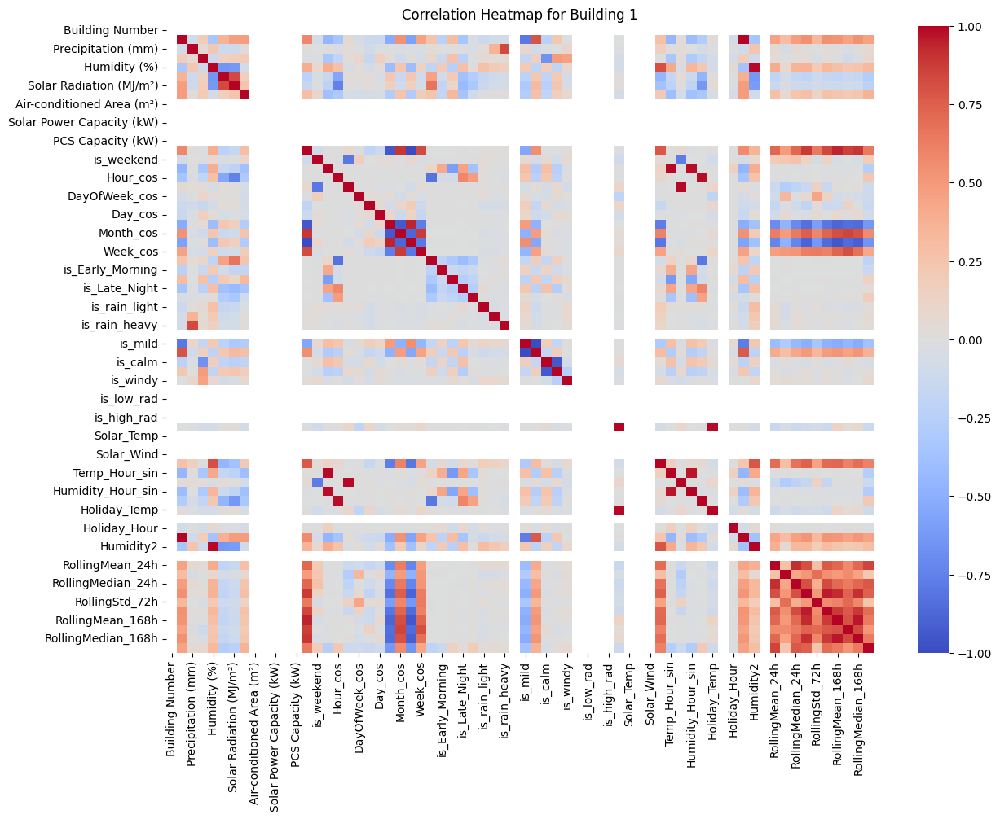

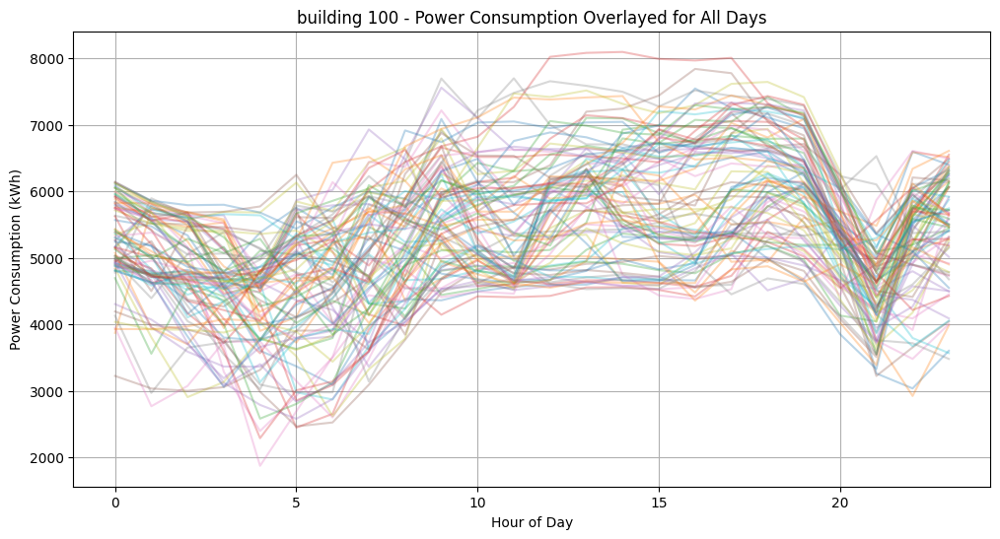

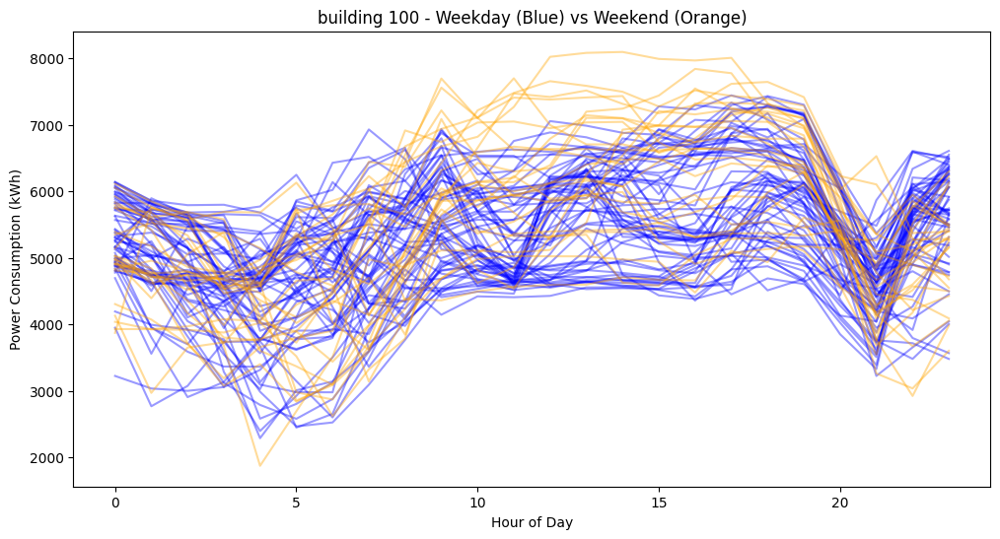

In [159]:
import matplotlib.pyplot as plt
import seaborn as sns
building_number = 1
# Filtered dataset for the selected building
bld_train_1 = train[train['Building Number'] == building_number]

# Select only numeric columns for correlation
numeric_cols = bld_train_1.select_dtypes(include=['float64', 'int64'])

# Compute correlation matrix
corr_matrix = numeric_cols.corr()

# Display top correlations with the target variable
target_corr = corr_matrix['Power Consumption (kWh)'].sort_values(ascending=False)
print("\nTop correlations with Power Consumption:")
print(target_corr)

# === Heatmap Visualization ===
plt.figure(figsize=(14, 10))
sns.heatmap(corr_matrix, annot=False, cmap="coolwarm", center=0)
plt.title(f"Correlation Heatmap for Building {building_number}")
plt.show()
import matplotlib.pyplot as plt

building_1 = train[train["Building Number"] == building_number].copy()
building_1["Datetime"] = pd.to_datetime(building_1["Datetime"])
building_1["Hour"] = building_1["Datetime"].dt.hour
building_1["Date"] = building_1["Datetime"].dt.date

plt.figure(figsize=(12, 6))
for date in building_1["Date"].unique():
    day_data = building_1[building_1["Date"] == date]
    plt.plot(day_data["Hour"], day_data["Power Consumption (kWh)"], alpha=0.3)

plt.title("building 100 - Power Consumption Overlayed for All Days")
plt.xlabel("Hour of Day")
plt.ylabel("Power Consumption (kWh)")
plt.grid(True)
plt.show()
import matplotlib.pyplot as plt

building_1 = train[train["Building Number"] == building_number].copy()
building_1["Datetime"] = pd.to_datetime(building_1["Datetime"])
building_1["DayOfWeek"] = building_1["Datetime"].dt.dayofweek
building_1["is_weekend"] = building_1["DayOfWeek"] >= 5
plt.figure(figsize=(12, 6))
for day in building_1[~building_1["is_weekend"]]["Datetime"].dt.date.unique():
    daily = building_1[building_1["Datetime"].dt.date == day]
    plt.plot(daily["Hour"], daily["Power Consumption (kWh)"], alpha=0.4, color="blue")
for day in building_1[building_1["is_weekend"]]["Datetime"].dt.date.unique():
    daily = building_1[building_1["Datetime"].dt.date == day]
    plt.plot(daily["Hour"], daily["Power Consumption (kWh)"], alpha=0.4, color="orange")

plt.title("building 100 - Weekday (Blue) vs Weekend (Orange)")
plt.xlabel("Hour of Day")
plt.ylabel("Power Consumption (kWh)")
plt.show()



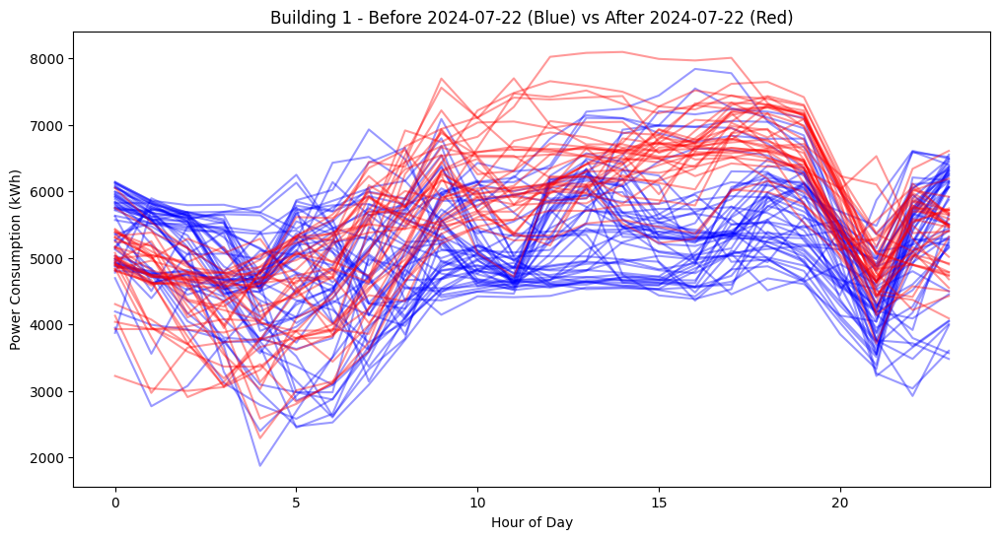

In [160]:
import matplotlib.pyplot as plt

# Filter for building 100
building_1 = train[train["Building Number"] == building_number].copy()
building_1["Datetime"] = pd.to_datetime(building_1["Datetime"])

# Define cutoff date
cutoff_date = pd.Timestamp("2024-07-22")

# Plot
plt.figure(figsize=(12, 6))

# Before cutoff
for day in building_1[building_1["Datetime"] < cutoff_date]["Datetime"].dt.date.unique():
    daily = building_1[building_1["Datetime"].dt.date == day]
    plt.plot(daily["Hour"], daily["Power Consumption (kWh)"], alpha=0.4, color="blue")

# After cutoff
for day in building_1[building_1["Datetime"] >= cutoff_date]["Datetime"].dt.date.unique():
    daily = building_1[building_1["Datetime"].dt.date == day]
    plt.plot(daily["Hour"], daily["Power Consumption (kWh)"], alpha=0.4, color="red")

plt.title(f"Building {building_number} - Before 2024-07-22 (Blue) vs After 2024-07-22 (Red)")
plt.xlabel("Hour of Day")
plt.ylabel("Power Consumption (kWh)")
plt.show()


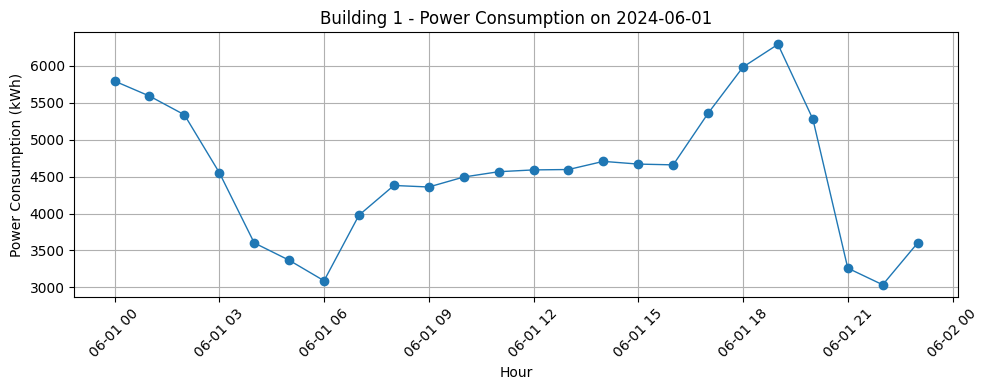

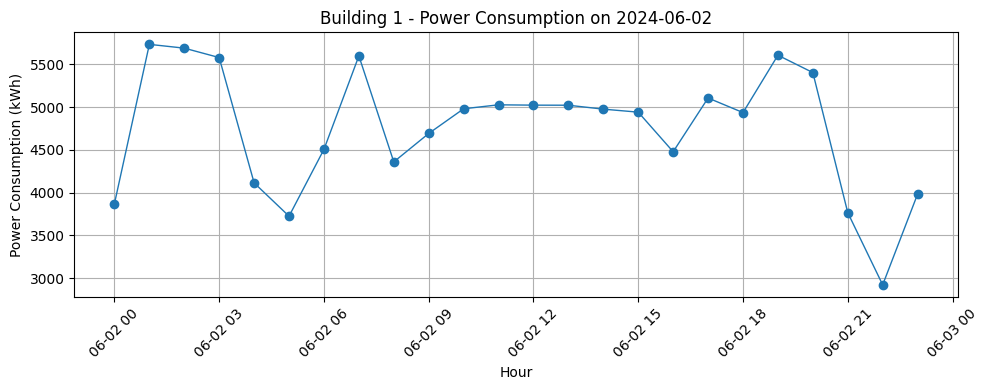

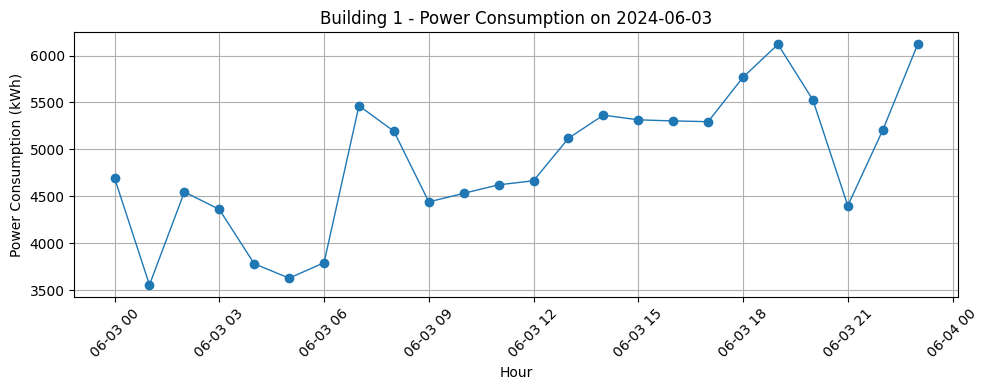

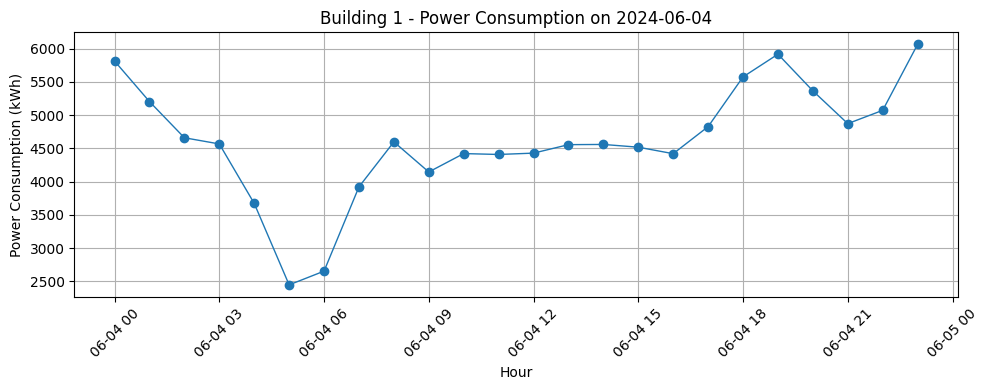

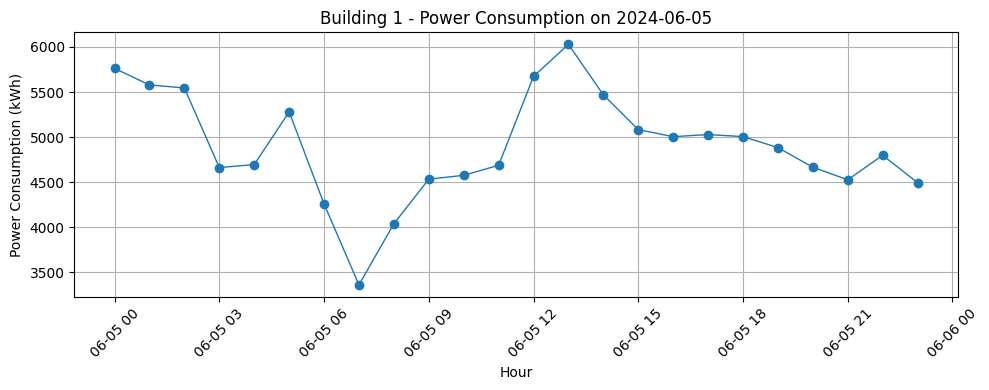

...

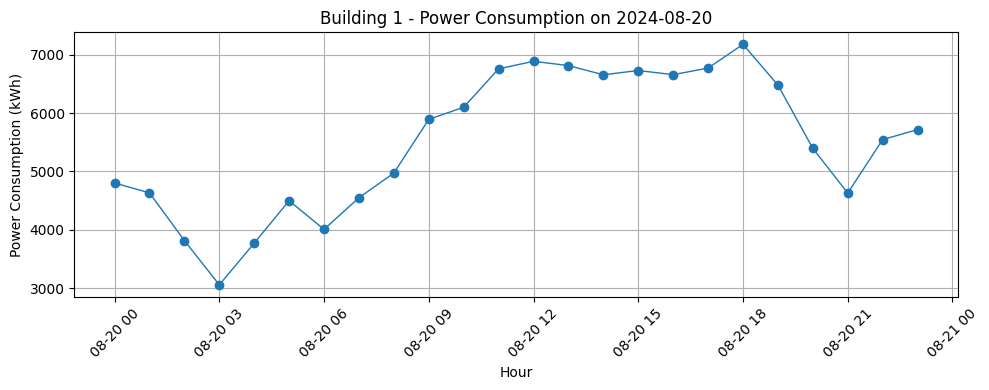

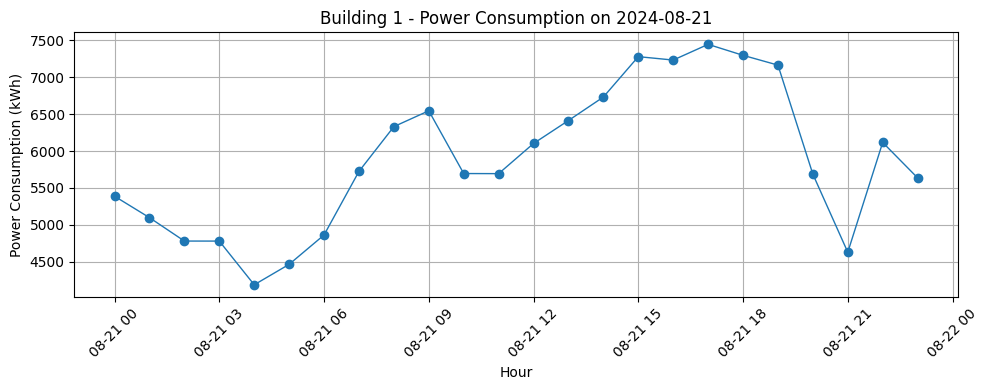

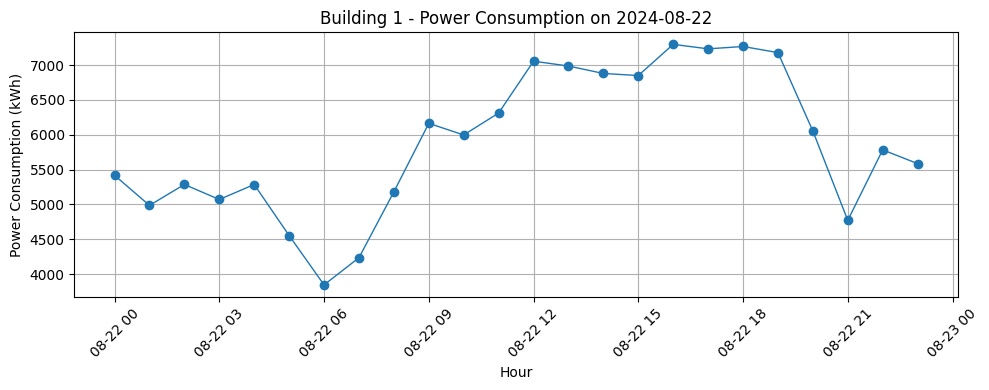

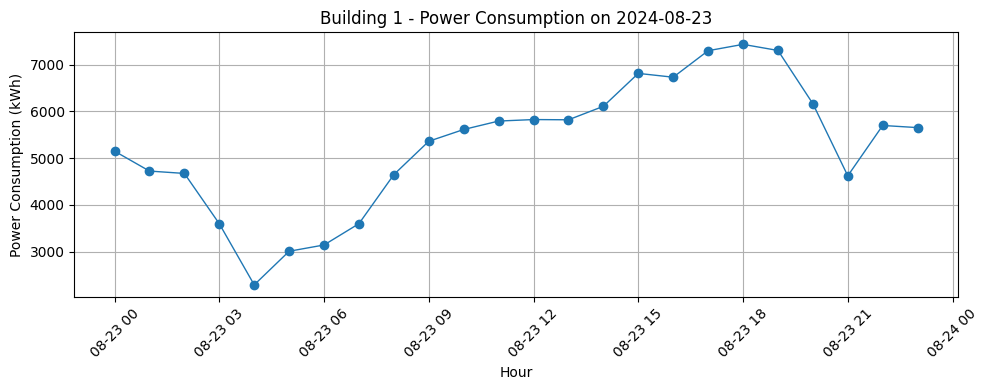

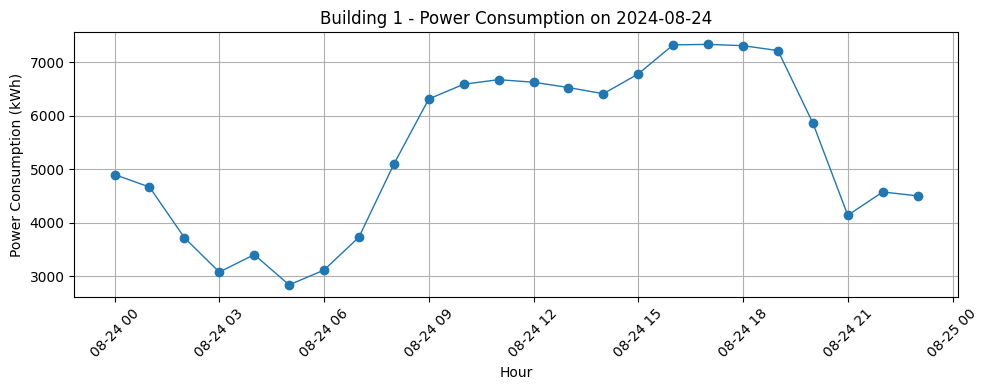

In [158]:
import matplotlib.pyplot as plt
import pandas as pd

# Filter data for Building 1
building_1 = train[train["Building Number"] == building_number].copy()

# Convert to datetime properly (VERY important)
building_1["Datetime"] = pd.to_datetime(building_1["Datetime"], errors="coerce")

# Sort by datetime
building_1 = building_1.sort_values("Datetime")

# Extract date (YYYY-MM-DD) from datetime
building_1["Date"] = building_1["Datetime"].dt.date

# Get unique sorted dates
unique_dates = sorted(building_1["Date"].unique())

# Generate separate plots for each day
for date in unique_dates:
    day_data = building_1[building_1["Date"] == date]
    plt.figure(figsize=(10, 4))
    plt.plot(day_data["Datetime"], day_data["Power Consumption (kWh)"], marker="o", linewidth=1)
    plt.title(f"Building 1 - Power Consumption on {date}")
    plt.xlabel("Hour")
    plt.ylabel("Power Consumption (kWh)")
    plt.xticks(rotation=45)
    plt.grid(True)
    plt.tight_layout()
    plt.show()

C:\Users\Dell\AppData\Local\Temp\ipykernel_19016\2555696139.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  bld_train_1['after_6'] = (bld_train_1['Hour'] >= 8).astype(int)
C:\Users\Dell\AppData\Local\Temp\ipykernel_19016\2555696139.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  bld_train_1['after_18'] = (bld_train_1['Hour'] >= 18).astype(int)
C:\Users\Dell\AppData\Local\Temp\ipykernel_19016\2555696139.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000181 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1671
[LightGBM] [Info] Number of data points in the train set: 1734, number of used features: 17
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 5288.424088
Building Number: 1
SMAPE: 5.28%
MAPE: 5.40%


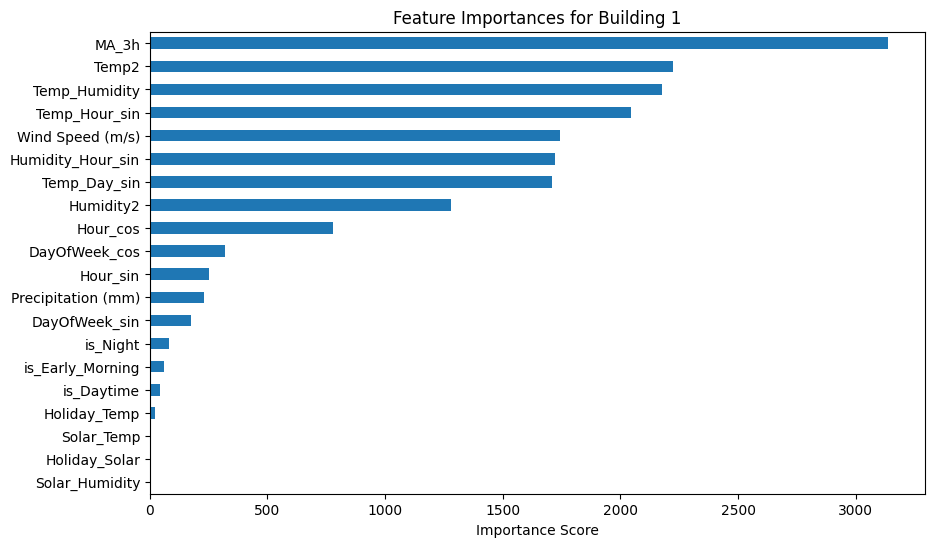

In [175]:
import numpy as np
import pandas as pd
import lightgbm as lgb
import matplotlib.pyplot as plt
from sklearn.metrics import mean_absolute_percentage_error
from sklearn.model_selection import train_test_split

# --- SMAPE Function ---
def smape(y_true, y_pred):
    numerator = np.abs(y_pred - y_true)
    denominator = (np.abs(y_true) + np.abs(y_pred)) / 2
    return np.mean(numerator / denominator) * 100

# === Add new time-based features ===

# === Choose one building ===
building_number = 1  # <-- Change this to your building number

bld_train_1 = train[train['Building Number'] == building_number]
bld_train_1['after_6'] = (bld_train_1['Hour'] >= 8).astype(int)
bld_train_1['after_18'] = (bld_train_1['Hour'] >= 18).astype(int)
# bld_train_1['pre_july'] = (bld_train_1['Datetime'].dt.month < 7).astype(int)
# bld_train_1['after_july'] = (bld_train_1['Datetime'].dt.month >= 7).astype(int)
bld_train_1['MA_24h'] = bld_train_1['Power Consumption (kWh)'].rolling(24).mean()
bld_train_1['MA_3h'] = bld_train_1['Power Consumption (kWh)'].rolling(3).mean()
bld_train_1['after_0722'] = (bld_train_1['Datetime'] >= pd.Timestamp("2024-07-22")).astype(int)


# === Features & Target ===
X = bld_train_1[[
     'is_Daytime', 'is_Early_Morning',  'is_Night',
    'Wind Speed (m/s)', 
    'Precipitation (mm)', 
    'DayOfWeek_sin', 'DayOfWeek_cos', 'Solar_Temp', 
    'Solar_Humidity', 'Temp_Humidity', 'Temp_Hour_sin', 
    'Temp_Day_sin', 'Humidity_Hour_sin', 'Holiday_Temp', 'Holiday_Solar', 
    'Holiday_Hour', 'Temp2', 'Humidity2', 'Hour_sin', 'Hour_cos', 
    'MA_3h',
]]

y = bld_train_1['Power Consumption (kWh)']

# === Train-test split ===
split_index = int(len(X) * 0.85)
X_train, X_val = X.iloc[:split_index], X.iloc[split_index:]
y_train, y_val = y.iloc[:split_index], y.iloc[split_index:]
# === LightGBM Model ===
model = lgb.LGBMRegressor(
    boosting_type='gbdt',
    n_estimators=600,
    learning_rate=0.1,
    num_leaves=31,
    random_state=42
)
# Train model
model.fit(X_train, y_train, eval_set=[(X_val, y_val)])

# === Predictions ===
y_pred = model.predict(X_val)

# === Metrics ===
building_smape = smape(y_val.values, y_pred)
building_mape = mean_absolute_percentage_error(y_val, y_pred) * 100

print(f"Building Number: {building_number}")
print(f"SMAPE: {building_smape:.2f}%")
print(f"MAPE: {building_mape:.2f}%")

# === Feature Importances ===
feat_importances = pd.Series(model.feature_importances_, index=X.columns)
plt.figure(figsize=(10, 6))
feat_importances.nlargest(20).sort_values().plot(kind='barh')
plt.title(f'Feature Importances for Building {building_number}')
plt.xlabel('Importance Score')
plt.show()


In [177]:
import numpy as np
import pandas as pd
import lightgbm as lgb

# --- Assume your model is already trained ---
# model = lgb.LGBMRegressor(...)  # already fitted on training data

# --- Prepare test set for Building 100 ---
building_number = 1
bld_test_1 = test[test['Building Number'] == building_number].copy()
bld_test_1['Datetime'] = pd.to_datetime(bld_test_1['Datetime'])
bld_test_1 = bld_test_1.sort_values('Datetime').reset_index(drop=True)

# --- Add same time-based features as training ---
bld_test_1['after_6'] = (bld_test_1['Hour'] >= 8).astype(int)
bld_test_1['after_18'] = (bld_test_1['Hour'] >= 18).astype(int)
bld_test_1['after_0722'] = (bld_test_1['Datetime'] >= pd.Timestamp("2024-07-22")).astype(int)

# --- Initialize columns ---
bld_test_1['MA_3h'] = np.nan
bld_test_1['Predicted Power Consumption (kWh)'] = np.nan

# --- Seed first 3 MA_3h values from training ---
bld_test_1.loc[:2, 'MA_3h'] = bld_train_1['MA_3h'].tail(3).values

# --- Define features used for prediction (must match training features) ---
feature_columns = [
     'is_Daytime', 'is_Early_Morning',  'is_Night',
    'Wind Speed (m/s)', 
    'Precipitation (mm)', 
    'DayOfWeek_sin', 'DayOfWeek_cos', 'Solar_Temp', 
    'Solar_Humidity', 'Temp_Humidity', 'Temp_Hour_sin', 
    'Temp_Day_sin', 'Humidity_Hour_sin', 'Holiday_Temp', 'Holiday_Solar', 
    'Holiday_Hour', 'Temp2', 'Humidity2', 'Hour_sin', 'Hour_cos', 
 'MA_3h',
]

# --- If MA_24h is used in training, initialize it similarly ---
bld_test_1['MA_24h'] = np.nan
bld_test_1.loc[:23, 'MA_24h'] = bld_train_1['MA_24h'].tail(24).values

# --- Sequential prediction loop ---
for i in range(len(bld_test_1)):
    # Prepare feature row
    X_row = bld_test_1.iloc[i][feature_columns].values.reshape(1, -1)
    
    # Predict power consumption
    pred = model.predict(X_row)[0]
    bld_test_1.at[i, 'Predicted Power Consumption (kWh)'] = pred
    
    # Update MA_3h for next row
    if i + 1 < len(bld_test_1):
        prev_preds = list(bld_test_1['Predicted Power Consumption (kWh)'].iloc[max(0,i-2):i+1])
        bld_test_1.at[i+1, 'MA_3h'] = np.mean(prev_preds)
    
    # Update MA_24h for next row if needed
    if i + 1 < len(bld_test_1):
        prev_preds_24h = list(bld_test_1['Predicted Power Consumption (kWh)'].iloc[max(0,i-23):i+1])
        bld_test_1.at[i+1, 'MA_24h'] = np.mean(prev_preds_24h)

# --- Save predictions ---
bld_test_1.to_csv("building_1_predictions.csv", index=False)

# --- Optional: check predictions ---
bld_test_1[['Datetime', 'Predicted Power Consumption (kWh)', 'MA_3h', 'MA_24h']].head(20)


c:\Users\Dell\Downloads\open\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
c:\Users\Dell\Downloads\open\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
c:\Users\Dell\Downloads\open\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
c:\Users\Dell\Downloads\open\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
c:\Users\Dell\Downloads\open\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warni

,Datetime,Predicted Power Consumption (kWh),MA_3h,MA_24h
0,2024-08-25 00:00:00,5359.581253,5737.790000,5282.667500
1,2024-08-25 01:00:00,4898.019636,5359.581253,5359.581253
2,2024-08-25 02:00:00,4812.721359,5128.800444,5128.800444
3,2024-08-25 03:00:00,4768.343770,5023.440749,5023.440749
4,2024-08-25 04:00:00,4838.512730,4826.361588,4959.666505
5,2024-08-25 05:00:00,5182.006558,4806.525953,4935.435750
6,2024-08-25 06:00:00,5091.211767,4929.621020,4976.530884
7,2024-08-25 07:00:00,5518.237845,5037.243685,4992.913868
8,2024-08-25 08:00:00,5606.217133,5263.818724,5058.579365
9,2024-08-25 09:00:00,6289.975584,5405.222248,5119.428006


# Building # 77


Top correlations with Power Consumption:
Power Consumption (kWh)    1.000000
Temp2                      0.756600
Temperature (°C)           0.743700
RollingMean_24h            0.589026
RollingMean_72h            0.556887
                             ...   
Solar_Temp                      NaN
Solar_Humidity                  NaN
Solar_Wind                      NaN
Holiday_Solar                   NaN
Solar2                          NaN
Name: Power Consumption (kWh), Length: 68, dtype: float64


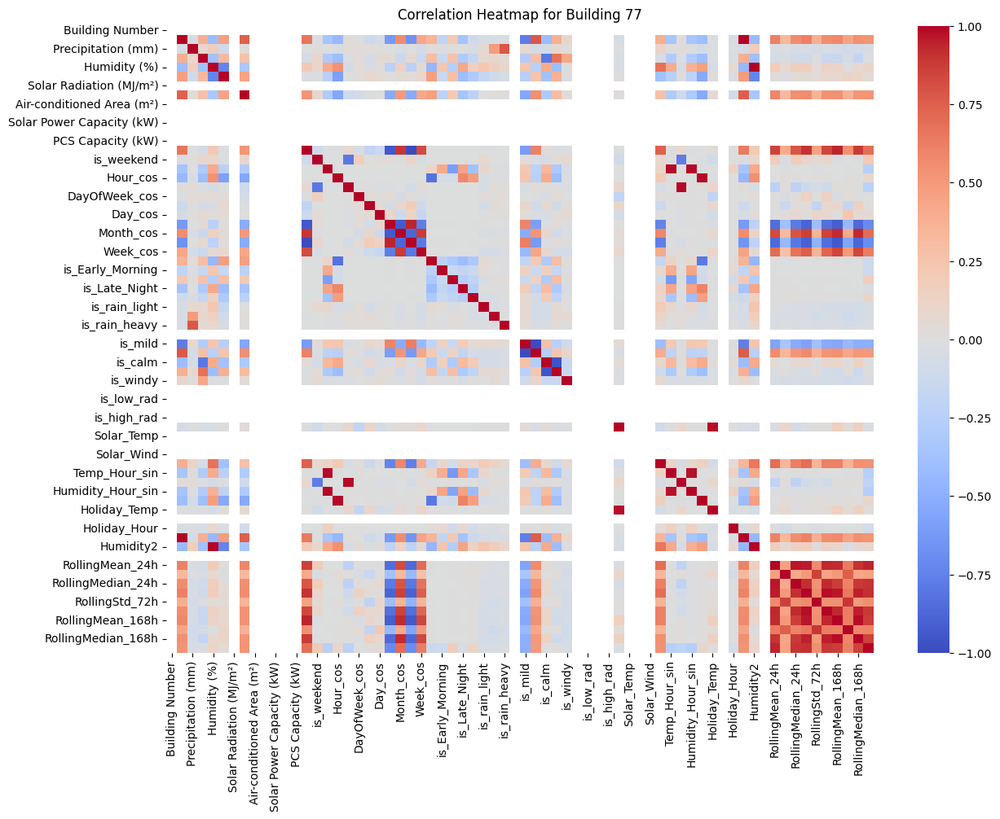

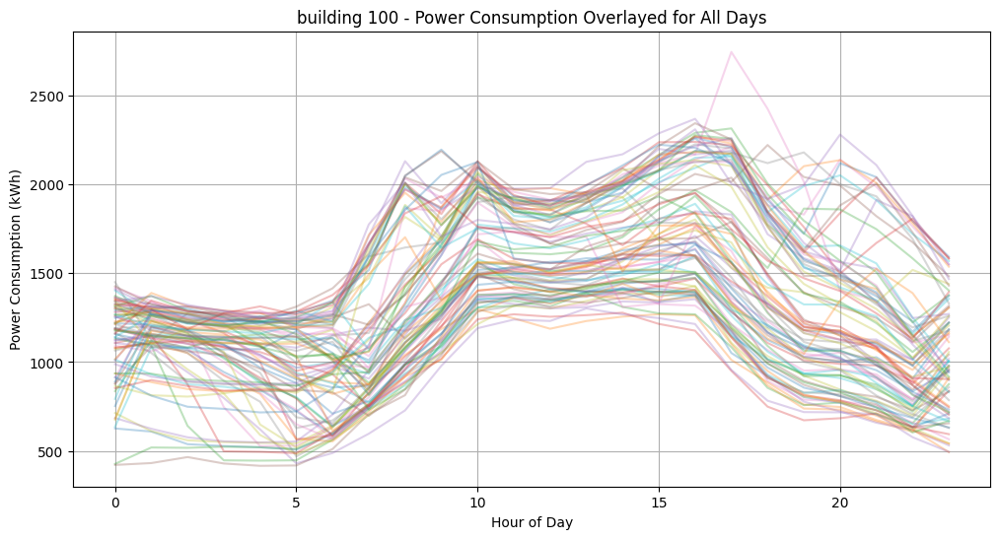

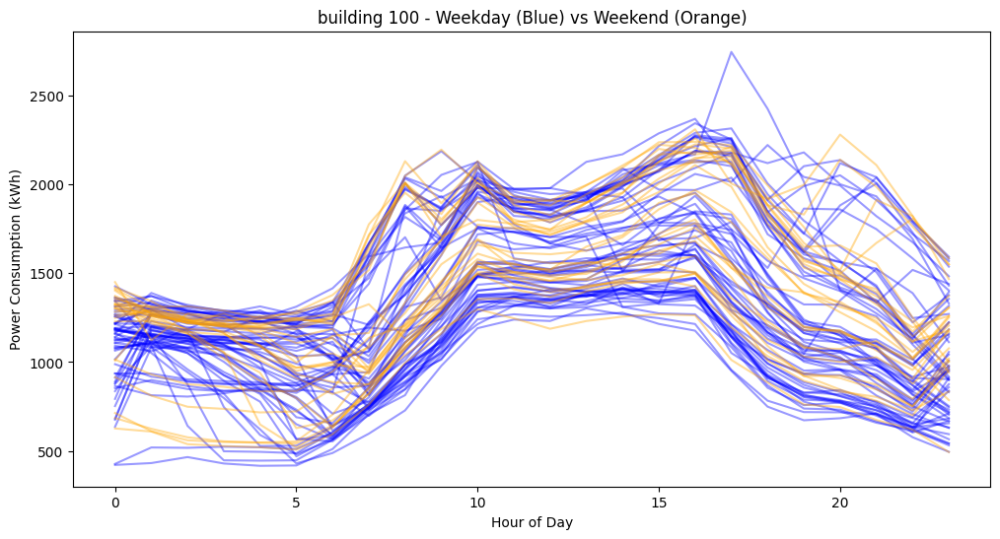

In [178]:
import matplotlib.pyplot as plt
import seaborn as sns
building_number = 77
# Filtered dataset for the selected building
bld_train_77 = train[train['Building Number'] == building_number]

# Select only numeric columns for correlation
numeric_cols = bld_train_77.select_dtypes(include=['float64', 'int64'])

# Compute correlation matrix
corr_matrix = numeric_cols.corr()

# Display top correlations with the target variable
target_corr = corr_matrix['Power Consumption (kWh)'].sort_values(ascending=False)
print("\nTop correlations with Power Consumption:")
print(target_corr)

# === Heatmap Visualization ===
plt.figure(figsize=(14, 10))
sns.heatmap(corr_matrix, annot=False, cmap="coolwarm", center=0)
plt.title(f"Correlation Heatmap for Building {building_number}")
plt.show()
import matplotlib.pyplot as plt

building_77 = train[train["Building Number"] == building_number].copy()
building_77["Datetime"] = pd.to_datetime(building_77["Datetime"])
building_77["Hour"] = building_77["Datetime"].dt.hour
building_77["Date"] = building_77["Datetime"].dt.date

plt.figure(figsize=(12, 6))
for date in building_77["Date"].unique():
    day_data = building_77[building_77["Date"] == date]
    plt.plot(day_data["Hour"], day_data["Power Consumption (kWh)"], alpha=0.3)

plt.title("building 100 - Power Consumption Overlayed for All Days")
plt.xlabel("Hour of Day")
plt.ylabel("Power Consumption (kWh)")
plt.grid(True)
plt.show()
import matplotlib.pyplot as plt

building_77 = train[train["Building Number"] == building_number].copy()
building_77["Datetime"] = pd.to_datetime(building_77["Datetime"])
building_77["DayOfWeek"] = building_77["Datetime"].dt.dayofweek
building_77["is_weekend"] = building_77["DayOfWeek"] >= 5
plt.figure(figsize=(12, 6))
for day in building_77[~building_77["is_weekend"]]["Datetime"].dt.date.unique():
    daily = building_77[building_77["Datetime"].dt.date == day]
    plt.plot(daily["Hour"], daily["Power Consumption (kWh)"], alpha=0.4, color="blue")
for day in building_77[building_77["is_weekend"]]["Datetime"].dt.date.unique():
    daily = building_77[building_77["Datetime"].dt.date == day]
    plt.plot(daily["Hour"], daily["Power Consumption (kWh)"], alpha=0.4, color="orange")

plt.title("building 100 - Weekday (Blue) vs Weekend (Orange)")
plt.xlabel("Hour of Day")
plt.ylabel("Power Consumption (kWh)")
plt.show()



C:\Users\Dell\AppData\Local\Temp\ipykernel_19016\547646056.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  bld_train_77['after_6'] = (bld_train_77['Hour'] >= 8).astype(int)
C:\Users\Dell\AppData\Local\Temp\ipykernel_19016\547646056.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  bld_train_77['after_18'] = (bld_train_77['Hour'] >= 18).astype(int)
C:\Users\Dell\AppData\Local\Temp\ipykernel_19016\547646056.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000217 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1666
[LightGBM] [Info] Number of data points in the train set: 1734, number of used features: 17
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 1279.128443
Building Number: 77
SMAPE: 4.56%
MAPE: 4.56%


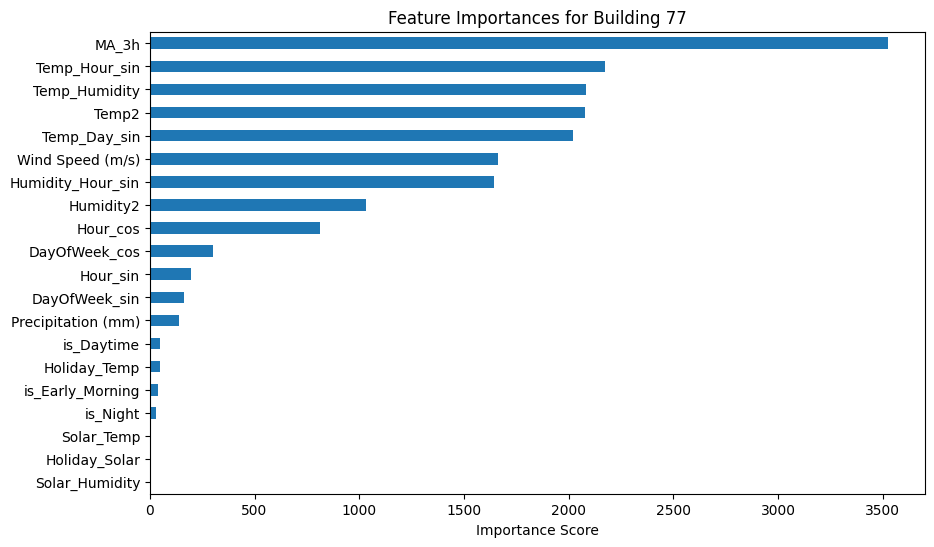

In [179]:
import numpy as np
import pandas as pd
import lightgbm as lgb
import matplotlib.pyplot as plt
from sklearn.metrics import mean_absolute_percentage_error
from sklearn.model_selection import train_test_split

# --- SMAPE Function ---
def smape(y_true, y_pred):
    numerator = np.abs(y_pred - y_true)
    denominator = (np.abs(y_true) + np.abs(y_pred)) / 2
    return np.mean(numerator / denominator) * 100

# === Add new time-based features ===

# === Choose one building ===
building_number = 77  # <-- Change this to your building number

bld_train_77 = train[train['Building Number'] == building_number]
bld_train_77['after_6'] = (bld_train_77['Hour'] >= 8).astype(int)
bld_train_77['after_18'] = (bld_train_77['Hour'] >= 18).astype(int)
# bld_train_77['pre_july'] = (bld_train_77['Datetime'].dt.month < 7).astype(int)
# bld_train_77['after_july'] = (bld_train_77['Datetime'].dt.month >= 7).astype(int)
bld_train_77['MA_24h'] = bld_train_77['Power Consumption (kWh)'].rolling(24).mean()
bld_train_77['MA_3h'] = bld_train_77['Power Consumption (kWh)'].rolling(3).mean()
bld_train_77['after_0722'] = (bld_train_77['Datetime'] >= pd.Timestamp("2024-07-22")).astype(int)


# === Features & Target ===
X = bld_train_77[[
     'is_Daytime', 'is_Early_Morning',  'is_Night',
    'Wind Speed (m/s)', 
    'Precipitation (mm)', 
    'DayOfWeek_sin', 'DayOfWeek_cos', 'Solar_Temp', 
    'Solar_Humidity', 'Temp_Humidity', 'Temp_Hour_sin', 
    'Temp_Day_sin', 'Humidity_Hour_sin', 'Holiday_Temp', 'Holiday_Solar', 
    'Holiday_Hour', 'Temp2', 'Humidity2', 'Hour_sin', 'Hour_cos', 
    'MA_3h',
]]

y = bld_train_77['Power Consumption (kWh)']

# === Train-test split ===
split_index = int(len(X) * 0.85)
X_train, X_val = X.iloc[:split_index], X.iloc[split_index:]
y_train, y_val = y.iloc[:split_index], y.iloc[split_index:]
# === LightGBM Model ===
model = lgb.LGBMRegressor(
    boosting_type='gbdt',
    n_estimators=600,
    learning_rate=0.1,
    num_leaves=31,
    random_state=42
)
# Train model
model.fit(X_train, y_train, eval_set=[(X_val, y_val)])

# === Predictions ===
y_pred = model.predict(X_val)

# === Metrics ===
building_smape = smape(y_val.values, y_pred)
building_mape = mean_absolute_percentage_error(y_val, y_pred) * 100

print(f"Building Number: {building_number}")
print(f"SMAPE: {building_smape:.2f}%")
print(f"MAPE: {building_mape:.2f}%")

# === Feature Importances ===
feat_importances = pd.Series(model.feature_importances_, index=X.columns)
plt.figure(figsize=(10, 6))
feat_importances.nlargest(20).sort_values().plot(kind='barh')
plt.title(f'Feature Importances for Building {building_number}')
plt.xlabel('Importance Score')
plt.show()


In [180]:
import numpy as np
import pandas as pd
import lightgbm as lgb

# --- Assume your model is already trained ---
# model = lgb.LGBMRegressor(...)  # already fitted on training data

# --- Prepare test set for Building 100 ---
building_number = 77
bld_test_77 = test[test['Building Number'] == building_number].copy()
bld_test_77['Datetime'] = pd.to_datetime(bld_test_77['Datetime'])
bld_test_77 = bld_test_77.sort_values('Datetime').reset_index(drop=True)

# --- Add same time-based features as training ---
bld_test_77['after_6'] = (bld_test_77['Hour'] >= 8).astype(int)
bld_test_77['after_18'] = (bld_test_77['Hour'] >= 18).astype(int)
bld_test_77['after_0722'] = (bld_test_77['Datetime'] >= pd.Timestamp("2024-07-22")).astype(int)

# --- Initialize columns ---
bld_test_77['MA_3h'] = np.nan
bld_test_77['Predicted Power Consumption (kWh)'] = np.nan

# --- Seed first 3 MA_3h values from training ---
bld_test_77.loc[:2, 'MA_3h'] = bld_train_77['MA_3h'].tail(3).values

# --- Define features used for prediction (must match training features) ---
feature_columns = [
     'is_Daytime', 'is_Early_Morning',  'is_Night',
    'Wind Speed (m/s)', 
    'Precipitation (mm)', 
    'DayOfWeek_sin', 'DayOfWeek_cos', 'Solar_Temp', 
    'Solar_Humidity', 'Temp_Humidity', 'Temp_Hour_sin', 
    'Temp_Day_sin', 'Humidity_Hour_sin', 'Holiday_Temp', 'Holiday_Solar', 
    'Holiday_Hour', 'Temp2', 'Humidity2', 'Hour_sin', 'Hour_cos', 
 'MA_3h',
]

# --- If MA_24h is used in training, initialize it similarly ---
bld_test_77['MA_24h'] = np.nan
bld_test_77.loc[:23, 'MA_24h'] = bld_train_77['MA_24h'].tail(24).values

# --- Sequential prediction loop ---
for i in range(len(bld_test_77)):
    # Prepare feature row
    X_row = bld_test_77.iloc[i][feature_columns].values.reshape(1, -1)
    
    # Predict power consumption
    pred = model.predict(X_row)[0]
    bld_test_77.at[i, 'Predicted Power Consumption (kWh)'] = pred
    
    # Update MA_3h for next row
    if i + 1 < len(bld_test_77):
        prev_preds = list(bld_test_77['Predicted Power Consumption (kWh)'].iloc[max(0,i-2):i+1])
        bld_test_77.at[i+1, 'MA_3h'] = np.mean(prev_preds)
    
    # Update MA_24h for next row if needed
    if i + 1 < len(bld_test_77):
        prev_preds_24h = list(bld_test_77['Predicted Power Consumption (kWh)'].iloc[max(0,i-23):i+1])
        bld_test_77.at[i+1, 'MA_24h'] = np.mean(prev_preds_24h)

# --- Save predictions ---
bld_test_77.to_csv("building_77_predictions.csv", index=False)

# --- Optional: check predictions ---
bld_test_77[['Datetime', 'Predicted Power Consumption (kWh)', 'MA_3h', 'MA_24h']].head(20)


c:\Users\Dell\Downloads\open\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
c:\Users\Dell\Downloads\open\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
c:\Users\Dell\Downloads\open\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
c:\Users\Dell\Downloads\open\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
c:\Users\Dell\Downloads\open\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warni

,Datetime,Predicted Power Consumption (kWh),MA_3h,MA_24h
0,2024-08-25 00:00:00,1939.687500,2127.520000,1539.500000
1,2024-08-25 01:00:00,1750.961221,1939.687500,1939.687500
2,2024-08-25 02:00:00,1708.988586,1845.324361,1845.324361
3,2024-08-25 03:00:00,1705.175064,1799.879102,1799.879102
4,2024-08-25 04:00:00,1747.547090,1721.708290,1776.203093
5,2024-08-25 05:00:00,1732.107888,1720.570247,1770.471892
6,2024-08-25 06:00:00,1746.533054,1728.276681,1764.077892
7,2024-08-25 07:00:00,1830.859585,1742.062678,1761.571486
8,2024-08-25 08:00:00,2065.612883,1769.833509,1770.232499
9,2024-08-25 09:00:00,1908.417813,1881.001841,1803.052541


# Building # 8 